# 👉 <a id = "top">Table of Contents</a> 👈 

# [1. Functions](#p1)

> <font color = red> Commonly used functions in the workbook, such as those used to calculate performance measures and graph drawdowns </font>

# [2. Trading Parameters](#p2)

> <font color = red> Main parameters of the trading strategies </font>

# [3. Momentum Strategies](#p3)

> <font color = red> Various trend following strategies </font>

### [3a. Moving Average Strategy](#p3a)

> <font color = red> Simple moving average crossover strategy </font>

### [3b. MACD Strategy](#p3b)

> <font color = red> Moving Average Convergence Divergence strategy </font>

### [3c. Exponential Moving Average Strategy](#p3c)

> <font color = red> Exponential Moving Average strategy </font>

# [4. Mean Reversion Strategies](#p4)

> <font color = red> Various mean reversion strategies </font>

### [4a. Bollinger Band Strategy](#p4a)

> <font color = red> Bollinger Band Strategy </font>

### [4b. RSI Strategy](#p4b)

> <font color = red> RSI Strategy </font>

### [4c. Stochastic Oscillator](#p4c)

> <font color = red> Stochastic Oscillator </font>

# [5. Machine Learning Trading Strategies](#p5)

> <font color = red> Various ML strategies </font>

### [5a. Data Collection](#p5a)

> <font color = red> Getting additional data to feed into ML models </font>

##### [5ai. Getting Technical Indicator variables for SPY](#p5ai)

> <font color = red> Collecting technical indicators data </font>

##### [5aii. Getting additional market variables](#p5aii)

> <font color = red> Collecting additional market variables data </font>

##### [5aiii. Load extra commodity data from yfinance](#p5aiii)

> <font color = red> Collecting commodities data </font>

##### [5aiv. Load Macroeconomic data from pandas-datareader](#p5aiv)

> <font color = red> Collecting macroeconomic data </font>

### [5b. Transforming economic data before feeding into model](#p5b)

> <font color = red> Making sure the economic data makes sense </font>

### [5c. Feature Engineering](#p5c)

> <font color = red> Creating new variables from the raw data </font>

### [5d. Train-test split](#p5d)

> <font color = red> Split into training data and test data for ML models </font>

### [5e. RFE](#p5e)

> <font color = red> Recursive Feature Elimation to reduce the number of features </font>

### [5f. Model Comparison](#p5f)

> <font color = red> Comparing various ML models </font>

### [5g. LightGBM](#p5g)

> <font color = red> Predict returns using LightGBM with hyperparameter tuning using Optuna </font>

### [5h. XGBoost](#p5h)

> <font color = red> Predict returns using XGBoost with hyperparameter tuning using Optuna </font>

### [5i. AdaBoost](#p5i)

> <font color = red> Predict returns using AdaBoost with hyperparameter tuning using Optuna </font>

### [5j. Linear Regression](#p5j)

> <font color = red> Predict returns using Linear Regression </font>

### [5k. Logistic Regression](#p5k)

> <font color = red> Predict returns using Logistic Regression </font>

### [5l. K-Means Clustering Strategy](#p5l)

> <font color = red> Predict returns using K-Means Clustering </font>

### [5m. ARIMA](#p5m)

> <font color = red> Predict returns using ARIMA </font>

# [6. Executive Summary of Strategies](#p6)

> <font color = red> Discussing various strategies explored </font>

### [6a. Top Strategy 1](#p6a)

> <font color = red> Discussing performance of XGBoost Strategy </font>

### [6b. Top Strategy 2](#p6b)

> <font color = red> Discussing performance of AdaBoost Strategy </font>

### [6c. Top Strategy 3](#p6c)

> <font color = red> Discussing performance of KMeans Regime Detection Strategy </font>

### [6d. Strategy Comparison](#p6d)

> <font color = red> Brief discussion of the performance of our top 3 strategies </font>

### [6e. Honorable Mentions](#p6e)

> <font color = red> Discussing strategies that did well despite their simplicity </font>

# [7. Self-Critique of Strategies](#p7)

> <font color = red> Dissecting and scrutinizing the strategies  </font>

### [7a. Operational Reality](#p7a)

> <font color = red> Challenges implementing the strategies in reality </font>

### [7b. Lookahead Bias](#p7b)

> <font color = red> Using information unavailable at that point in time </font>

### [7c. Overfitting](#p7c)

> <font color = red> Great results in-sample, poor results out-sample </font>

### [7d. Problem with log returns](#p7d)

> <font color = red> Using log returns when calculating PnL for a long-short strategy is problematic </font>

### [7e. Hyperparamater Tuning](#p7e)

> <font color = red> Using Historical Data as proxy </font>

In [1]:
import matplotlib.pyplot as plt
import numpy as np
import pandas as pd
import random
import math

# Yahoo finance
import yfinance as yf

# Pandas Datareader
import pandas_datareader as pdr

# Plotly
import plotly.express as px 
import plotly.graph_objects as go

# Datetime
import datetime as dt
from datetime import datetime
from datetime import timedelta

import lightgbm as lgb
import xgboost as xg
from xgboost import XGBRegressor
import graphviz
import copy
import gc
import optuna

from skgbm.tools import trees_to_dataframe

# Sklearn
from sklearn.preprocessing import StandardScaler
from sklearn.preprocessing import MinMaxScaler
from sklearn.model_selection import GridSearchCV, TimeSeriesSplit
from sklearn.cluster import KMeans
from sklearn.cluster import AffinityPropagation
from sklearn.decomposition import PCA
from sklearn.feature_selection import RFE
from sklearn.feature_selection import RFECV
from sklearn.linear_model import LogisticRegression
from sklearn.ensemble import ExtraTreesClassifier
from sklearn.tree import DecisionTreeRegressor
from sklearn.model_selection import cross_val_score
from sklearn.model_selection import KFold
from sklearn.metrics import r2_score
from sklearn.metrics import mean_squared_error
from sklearn import metrics 

from statsmodels.tsa.arima.model import ARIMA

from sklearn.linear_model import LinearRegression
from sklearn.linear_model import LogisticRegression

# Regularization
from sklearn.linear_model import Lasso
from sklearn.linear_model import ElasticNet


# ENSEMBLE

## Bagging (BOOTSTRAPPED AGGREGATION)
from sklearn.ensemble import RandomForestRegressor       # Imputation of missing values
from sklearn.ensemble import ExtraTreesRegressor

## Boosting
from sklearn.ensemble import AdaBoostRegressor           # Adaptive Boosting
from sklearn.ensemble import GradientBoostingRegressor   # XGB -> eXtreme Gradient Boosting -> dummification (ENCODING)

# Support Vector Machine
from sklearn.svm import SVR

# K-Nearest Neighbor
from sklearn.neighbors import KNeighborsRegressor      # In econometrics, for matching and propensity scoring method

import statsmodels.tsa.arima.model as stats
import statsmodels.api as sm

import warnings
warnings.filterwarnings("ignore")

In [2]:
seed = 627
random.seed(seed)
np.random.seed(seed)

# <a id = "p1">1.</a>  <font color = "green"> Functions </font>  [back to table of contents](#top)

In [3]:
# This is used to calculate portfolio statistics and compare with long-only SP500

def calc_portfolio_statistics(portfolio_df: pd.DataFrame, 
                              SP500: pd.DataFrame, 
                              portfolio_name: str):
    
    # Ensure the index is a DatetimeIndex
    if not isinstance(portfolio_df.index, pd.DatetimeIndex):
        raise ValueError("The index of portfolio_df must be a DatetimeIndex")
    
    portfolio_statistics=portfolio_df

    portfolio_statistics['Returns']=portfolio_statistics["strategy_returns"]
    
    portfolio_statistics.dropna(subset="Returns",
                                axis=0,
                                inplace=True)
    
    # Filter only for dates in SP500 that are in the strategy dataframe
    SP500_copy = SP500.loc[SP500.index.intersection(portfolio_statistics.index)]
    
    #Calculate number of years as the last date in the index minus the first date in the index
    Number_of_years=((portfolio_statistics.index[-1]-portfolio_statistics.index[0]).days)/365.25   #Edit this as needed
    
    # Cumulative returns, drawdown, and high-water mark
    portfolio_statistics['CumulativeStrategyReturns'] = portfolio_statistics['Returns'].cumsum().apply(np.exp)
    portfolio_statistics['HighWaterMark'] = portfolio_statistics['CumulativeStrategyReturns'].cummax()
    portfolio_statistics['Drawdown'] = (portfolio_statistics['CumulativeStrategyReturns']/portfolio_statistics['HighWaterMark'])-1
    portfolio_statistics['MaxDrawdown'] = portfolio_statistics['Drawdown'].cummin()
    
    Last_date = portfolio_statistics[~portfolio_statistics['MaxDrawdown'].isna()].index[-1]
    
    # Convert index to a Series
    high_water_mark_date = pd.Series(portfolio_statistics.index, index=portfolio_statistics.index)
    
    # Calculate HighWaterMarkDate
    portfolio_statistics['HighWaterMarkDate'] = high_water_mark_date.where(portfolio_statistics['Drawdown'] == 0).fillna(method='ffill')
            
    portfolio_statistics['HighWaterMarkDate']=pd.to_datetime(portfolio_statistics['HighWaterMarkDate'])
    
    #Calculate duration of drawdown
    portfolio_statistics['DrawdownDuration'] = portfolio_statistics.index - portfolio_statistics['HighWaterMarkDate']

    #Calculate duration of maximum drawdown
    portfolio_statistics['MaximumDrawdownDuration'] = portfolio_statistics['DrawdownDuration'].cummax()
    
    Cumulative_Returns=(portfolio_statistics['CumulativeStrategyReturns'][Last_date])

    Annualized_Returns=(portfolio_statistics['CumulativeStrategyReturns'][Last_date]**(1/Number_of_years))-1

    Annualized_Standard_Deviation = portfolio_statistics['Returns'].std() *np.sqrt(252)    #Edit this as needed

    Negative_Standard_Deviation = portfolio_statistics['Returns'][portfolio_statistics['Returns']<0].std()*np.sqrt(252)    #Edit this as needed

    Sharpe_Ratio= round(Annualized_Returns/Annualized_Standard_Deviation,2)

    Sortino_Ratio=round(Annualized_Returns/Negative_Standard_Deviation,2)
    
    Calmar_Ratio=round(Annualized_Returns/portfolio_statistics['MaxDrawdown'][-1]*-1,2)

    MaxDrawdown=round(portfolio_statistics['MaxDrawdown'][-1]*100,2)
    
    MaxDrawdown_Duration=(portfolio_statistics['MaximumDrawdownDuration'][Last_date]).days

    #Calculate VaR measures
    var99=np.percentile(portfolio_statistics['Returns'], 1)
    var99_month=round(var99 * np.sqrt(21),2)*100
    var99_year=round(var99 * np.sqrt(252),2)*100
    var99=round(var99,2)*100
    
    #Calculate Information Ratio
    Tracking_Error=(portfolio_statistics['strategy_returns']-SP500['SPY_log_returns']).std()*np.sqrt(252)
    SP500_Annualized_Returns=((SP500['SPY_cumulative_returns'][Last_date]/initial_capital)**(1/Number_of_years))-1
    Information_Ratio=round((Annualized_Returns-SP500_Annualized_Returns)/Tracking_Error,2)
    
    # For calculating beta
    stock_return = portfolio_statistics['strategy_returns']
    SP500_return = SP500_copy['SPY_log_returns']

    # Compute rolling covariance and variance
    rolling_cov = stock_return.rolling(window=252).cov(SP500_return)
    rolling_var = SP500_return.rolling(window=252).var()   # Use SP500_return's variance

    # Calculate beta as covariance/variance
    beta = rolling_cov / rolling_var

    # Assign the result to beta_df
    portfolio_statistics["Rolling beta"] = beta
    
    Latest_beta=round(portfolio_statistics["Rolling beta"][-1],2)
    
    Treynor_Ratio=round(Annualized_Returns*100/Latest_beta,2)
    
    #Round values just before printing
    Cumulative_Returns=round(Cumulative_Returns*100,2)
    Annualized_Returns=round(Annualized_Returns*100,2)
    Annualized_Standard_Deviation=round(Annualized_Standard_Deviation*100,2)
    
    # Print the results
    print(f'During this period, {portfolio_name} Cumulative Return was {Cumulative_Returns}%')
    print(f'During this period, {portfolio_name} Annualized Return was {Annualized_Returns}%')
    print(f'During this period, {portfolio_name} Annualized Standard Deviation was {Annualized_Standard_Deviation}%')
    print(f'During this period, {portfolio_name} Sharpe Ratio was {Sharpe_Ratio}')
    print(f'During this period, {portfolio_name} Sortino Ratio was {Sortino_Ratio}')
    print(f'During this period, {portfolio_name} Calmar Ratio was {Calmar_Ratio}')
    print(f'During this period, {portfolio_name} Treynor Ratio was {Treynor_Ratio}')
    print(f'During this period, {portfolio_name} Max Drawdown was {MaxDrawdown}%')
    print(f'During this period, {portfolio_name} Max Drawdown Duration was {MaxDrawdown_Duration} days')
    print(f'During this period, {portfolio_name} 1 day VaR at the 99% CI was {var99} %')
    print(f'During this period, {portfolio_name} 1 month VaR at the 99% CI was {var99_month} %')
    print(f'During this period, {portfolio_name} 1 year VaR at the 99% CI was {var99_year} %')
    print(f'During this period, {portfolio_name} Information Ratio against SP500 was {Information_Ratio}')
    print(f'The past 12m {portfolio_name} Rolling Beta against SP500 was {Latest_beta}')
    
    return portfolio_statistics

In [4]:
#This is used to plot chart of strategy return alongside SPY returns

def plot_chart_with_SPY(portfolio_df: pd.DataFrame, 
                        SPY_info: pd.DataFrame, 
                        chart_title: str): 
    
    # Plot strategy cumulative returns against highwatermark
    fig = go.Figure()

    fig.add_trace(go.Scatter(
        x=portfolio_df.index, 
        y=portfolio_df, 
        mode='lines', 
        name='Strategy Cumulative Returns'
    ))

    fig.add_trace(go.Scatter(
        x=SPY_info.index, 
        y=SPY_info["SPY_cumulative_returns"], 
        mode='lines', 
        name='SPY cumulative returns'
    ))

    fig.update_layout(
        title=chart_title,
        xaxis_title="Date",
        yaxis_title="Cumulative Capital",
        width=1200,  
        height=600
    )

    fig.show()

In [5]:
#This is used to plot chart of buy and sell positions along with Adj Close price of SPY

def plot_chart_with_buy_sell(portfolio_df: pd.DataFrame, 
                             chart_title: str):
    
    fig = go.Figure()

    fig.add_trace(
        go.Scatter(
            x=portfolio_df.index, 
            y=portfolio_df["Adj Close"], 
            mode='lines', 
            line=dict(color='grey', width=0.75), 
            name='SPY'
        )
    )

    fig.add_trace(
        go.Scatter(
            x=portfolio_df.loc[portfolio_df.Trades.isin([1.0, 2.0])].index, 
            y=portfolio_df["Adj Close"][portfolio_df.Trades.isin([1.0, 2.0])], 
            mode='markers', 
            marker=dict(symbol='triangle-up', color='green', size=10), 
            name='BUY Signal'
        )
    )

    fig.add_trace(
        go.Scatter(
            x=portfolio_df.loc[portfolio_df.Trades.isin([-1.0, -2.0])].index, 
            y=portfolio_df["Adj Close"][portfolio_df.Trades.isin([-1.0, -2.0])], 
            mode='markers', 
            marker=dict(symbol='triangle-down', color='red', size=10), 
            name='SELL Signal'
        )
    )

    fig.update_layout(
        title=chart_title,
        xaxis_title='Date',
        yaxis_title='SPY Price',
        width=1200,  
        height=600   
    )

    # Show figure
    fig.show()

In [6]:
#This is used to plot chart of buy and sell positions along with Adj Close price of SPY

def plot_chart_with_drawdown(portfolio_df: pd.DataFrame, 
                             chart_title: str):
    
    # Plot strategy cumulative returns against highwatermark
    fig = go.Figure()

    fig.add_trace(go.Scatter(
        x=portfolio_df.index, 
        y=portfolio_df["CumulativeStrategyReturns"], 
        mode='lines', 
        name='Strategy Cumulative Returns'
    ))

    fig.add_trace(go.Scatter(
        x=portfolio_df.index, 
        y=portfolio_df["HighWaterMark"], 
        mode='lines', 
        name='Max Gross Performance'
    ))

    fig.update_layout(
        title=chart_title,
        xaxis_title="Date",
        yaxis_title="Cumulative Returns",
        yaxis=dict(tickformat=".2f"),
        width=1200,  
        height=600
    )

    fig.show()
    
    
    
    # Plot drawdown of strategy
    drawdown_df = portfolio_df[["Drawdown"]].dropna()

    fig = go.Figure()

    fig.add_trace(go.Scatter(
        x=drawdown_df.index, 
        y=drawdown_df["Drawdown"], 
        mode='lines', 
        name='Drawdown'
    ))

    fig.update_layout(
        title="Percentage Drawdown Over Time",
        xaxis_title="Date",
        yaxis_title="Percentage Drawdown",
        yaxis=dict(tickformat=".2f"),
        width=1200,  
        height=600
    )

    fig.show()

# <a id = "p2">2.</a>  <font color = "green"> Trading Parameters </font>  [back to table of contents](#top)

In [7]:
initial_capital = 100000
commission = 0

In [8]:
start_date = pd.to_datetime('2005-11-01', format='%Y-%m-%d')
end_date = pd.to_datetime('2024-11-01', format='%Y-%m-%d')

In [9]:
SPY_info = yf.download("SPY",
                          start = start_date,
                          end = end_date)

[*********************100%%**********************]  1 of 1 completed


In [10]:
SPY_info = SPY_info[["Adj Close"]]

In [11]:
SPY_info["SPY_log_returns"] =\
(
    np
    .log(SPY_info["Adj Close"] / SPY_info["Adj Close"].shift(1)
        )
)

In [12]:
SPY_info["SPY_cumulative_returns"] = \
    (
        initial_capital*SPY_info["SPY_log_returns"]
        .cumsum()
        .apply(np.exp)
    )

In [13]:
SPY_info

,Adj Close,SPY_log_returns,SPY_cumulative_returns
Date,,,
2005-11-01,83.991135,NaN,NaN
2005-11-02,84.869469,0.010403,101045.746136
2005-11-03,85.231949,0.004262,101477.315688
2005-11-04,85.120384,-0.001310,101344.486627
2005-11-07,85.204079,0.000983,101444.133403
...,...,...,...
2024-10-25,579.039978,-0.000345,689406.067063
2024-10-28,580.830017,0.003087,691537.290876
2024-10-29,581.770020,0.001617,692656.459518


In [14]:
#Cumulative Returns of SPY
plot_chart_with_SPY(portfolio_df = SPY_info["SPY_cumulative_returns"],
                    SPY_info = SPY_info,
                    chart_title=("SPY Cumulative Returns"))

## <a id = "p3">3.</a>  <font color = "green"> Momentum Trading Strategies </font>  [back to table of contents](#top)

### <a id = "p3a">3a.</a>  <font color = "green"> Moving Average Strategy </font>  [back to table of contents](#top)

In [15]:
SMA_start = 1
SMA_end = 30
LMA_start = 31
LMA_end = 60

In [16]:
def Moving_Average_Optimal_Hyperparameters (MA_df = SPY_info,
                                            SMA_start: int=SMA_start, 
                                            SMA_end: int=SMA_end, 
                                            LMA_start: int=LMA_start,
                                            LMA_end: int=LMA_end,
                                            initial_capital=initial_capital,
                                            commission=commission,
                                            Long_Short="Long Only"):
    
    '''
    SMA_start: Start of Short Moving Average to loop over
    SMA_end: End of Short Moving Average to loop over
    LMA_start: Start of Long Moving Average to loop over
    LMA_end: End of Long Moving Average to loop over
    initial_capital: Starting capital for the strategy
    commission: Trading commission for each trade
    '''
    
    if Long_Short not in ["Long Only", "Long-Short"]:
        raise ValueError("Invalid value for Long_Short. Choose 'Long Only' or 'Long-Short'.")
    
    if Long_Short == "Long Only":
        Short = 0
    else:
        Short = -1
    
    Number_of_permutations=(SMA_end-SMA_start+1)*(LMA_end-LMA_start+1)
    
    Moving_Average_Strategy_df=pd.DataFrame(index=range(0,Number_of_permutations),
                                            columns=["SMA","LMA","Final_Capital"])

    n=0
    for SMA in range (SMA_start,SMA_end+1):
        for LMA in range (LMA_start,LMA_end+1):
    
            Momentum_df=MA_df.copy()
            
            # Calculate the SMA and LMA
            Momentum_df["SMA"]=\
                (
                    Momentum_df["Adj Close"]
                    .rolling(window=SMA,min_periods=SMA)
                    .mean()
                )
                
            Momentum_df["LMA"]=\
                (
                    Momentum_df["Adj Close"]
                    .rolling(window=LMA,min_periods=LMA)
                    .mean()
                )

            # Enter long position (1) when SMA is above the LMA. 
            Momentum_df["Position"]=\
                (
                    np.where(Momentum_df["SMA"] > Momentum_df["LMA"],
                             1
                             ,0)
                )

            # Enter short position or neutral when SMA is below the LMA. 
            Momentum_df["Position"]=\
                (
                    np.where(Momentum_df["SMA"] < Momentum_df["LMA"],
                             Short,
                             Momentum_df["Position"])
                )

            Momentum_df["Trades"] =\
                (
                    Momentum_df["Position"]
                    .diff()
                )

            Momentum_df["log_returns"] =\
                (
                    np
                    .log(Momentum_df["Adj Close"] / Momentum_df["Adj Close"].shift(1)
                        )
                )

            Momentum_df["strategy_returns"] =\
                (
                    Momentum_df["Position"]
                    .shift(1) 
                    * 
                    Momentum_df["log_returns"]
                )
            
            # Drop rows with NaN values
            Momentum_df.dropna(inplace=True)
            
            # Initialize the Capital column with NaN values
            Momentum_df["Capital"]=np.nan
            
            # Set the first value of Capital to the initial value (initial_capital)
            Momentum_df.iloc[0, Momentum_df.columns.get_loc("Capital")] = initial_capital
            
            # Loop through each row starting from the second row to calculate capital
            for row in range(1, len(Momentum_df)):
                
                Trade=abs(Momentum_df.iloc[row, Momentum_df.columns.get_loc("Trades")])

                # Update the capital based on the previous capital and strategy returns
                Momentum_df.iloc[row, Momentum_df.columns.get_loc("Capital")] = Momentum_df.iloc[row-1, Momentum_df.columns.get_loc("Capital")] * \
                    (np.exp(Momentum_df.iloc[row, Momentum_df.columns.get_loc("strategy_returns")])) - Trade * commission
            
            Final_Capital=Momentum_df.iloc[-1, Momentum_df.columns.get_loc("Capital")]
            
            Moving_Average_Strategy_df.iloc[n,Moving_Average_Strategy_df.columns.get_loc("SMA")]=SMA
            Moving_Average_Strategy_df.iloc[n,Moving_Average_Strategy_df.columns.get_loc("LMA")]=LMA
            Moving_Average_Strategy_df.iloc[n,Moving_Average_Strategy_df.columns.get_loc("Final_Capital")]=Final_Capital
            
            n=n+1
        
    return Moving_Average_Strategy_df

In [17]:
Optimal_Moving_Average = Moving_Average_Optimal_Hyperparameters (MA_df = SPY_info,
                                                            SMA_start = SMA_start, 
                                                            SMA_end = SMA_end, 
                                                            LMA_start = LMA_start,
                                                            LMA_end = LMA_end,
                                                            initial_capital = initial_capital,
                                                            commission = commission,
                                                            Long_Short="Long Only")

In [18]:
Optimal_Moving_Average

,SMA,LMA,Final_Capital
0,1,31,336356.427818
1,1,32,289502.166155
2,1,33,282042.60787
3,1,34,267483.170295
4,1,35,248245.000408
...,...,...,...
895,30,56,320512.849199
896,30,57,287688.90686
897,30,58,284256.110034
898,30,59,288017.346951


In [19]:
# These are the optimal Moving Average parameters and the expected final capital using these parameters

max_capital_index = Optimal_Moving_Average['Final_Capital'].idxmax()
Optimal_Moving_Average.loc[max_capital_index]

SMA                         15
LMA                         42
Final_Capital    411120.989775
Name: 431, dtype: object

In [20]:
# Use the optimal Moving Average parameters for the Moving Average Strategy

# These are the optimal hyperparameters for long-short, if you dont want to optimize again
# SMA=15
# LMA=42

# These are the optimal hyperparameters for long only, if you dont want to optimize again
SMA=15
LMA=42

SMA = Optimal_Moving_Average.loc[max_capital_index,"SMA"]
LMA = Optimal_Moving_Average.loc[max_capital_index,"LMA"]

In [21]:
def Moving_Average_Strategy_Returns (MA_df = SPY_info,
                                    SMA=SMA, 
                                    LMA=LMA,
                                    initial_capital=initial_capital,
                                    commission=commission,
                                    Long_Short="Long Only"):
    
    '''
    SMA: Short Moving Average
    LMA: Long Moving Average
    initial_capital: Starting capital for the strategy
    commission: Trading commission for each trade
    '''
    
    if Long_Short not in ["Long Only", "Long-Short"]:
        raise ValueError("Invalid value for Long_Short. Choose 'Long Only' or 'Long-Short'.")
    
    if Long_Short == "Long Only":
        Short = 0
    else:
        Short = -1
    
    Momentum_df=MA_df.copy()
    
    # Calculate the SMA and LMA
    Momentum_df["SMA"]=\
        (
            Momentum_df["Adj Close"]
            .rolling(window=SMA,min_periods=SMA)
            .mean()
        )
        
    Momentum_df["LMA"]=\
        (
            Momentum_df["Adj Close"]
            .rolling(window=LMA,min_periods=LMA)
            .mean()
        )

    # Enter long position (1) when SMA is above the LMA. 
    Momentum_df["Position"]=\
        (
            np.where(Momentum_df["SMA"] > Momentum_df["LMA"],
                        1
                        ,0)
        )

    # Enter short position or neutral when SMA is below the LMA. 
    Momentum_df["Position"]=\
        (
            np.where(Momentum_df["SMA"] < Momentum_df["LMA"],
                        Short,
                        Momentum_df["Position"])
        )

    Momentum_df["Trades"] =\
    (
        Momentum_df["Position"]
        .diff()
    )

    Momentum_df["log_returns"] =\
    (
        np
        .log(Momentum_df["Adj Close"] / Momentum_df["Adj Close"].shift(1)
            )
    )

    Momentum_df["strategy_returns"] =\
    (
        Momentum_df["Position"]
        .shift(1) 
        * 
        Momentum_df["log_returns"]
    )
    
    # Drop rows with NaN values
    Momentum_df.dropna(inplace=True)
    
    # Initialize the Capital column with NaN values
    Momentum_df["Capital"]=np.nan
    
    # Set the first value of Capital to the initial value (initial_capital)
    Momentum_df.iloc[0, Momentum_df.columns.get_loc("Capital")] = initial_capital
    
    # Loop through each row starting from the second row to calculate capital
    for row in range(1, len(Momentum_df)):
        
        Trade=abs(Momentum_df.iloc[row, Momentum_df.columns.get_loc("Trades")])

        # Update the capital based on the previous capital and strategy returns
        Momentum_df.iloc[row, Momentum_df.columns.get_loc("Capital")] = Momentum_df.iloc[row-1, Momentum_df.columns.get_loc("Capital")] * \
            (np.exp(Momentum_df.iloc[row, Momentum_df.columns.get_loc("strategy_returns")])) - Trade * commission
    
    Final_Capital=Momentum_df.iloc[-1, Momentum_df.columns.get_loc("Capital")]
    
    print (f"The final capital of a moving average crossover strategy on SPY over this time period with a SMA of {SMA} days, LMA of {LMA} days and starting capital of ${initial_capital} is ${Final_Capital:.2f}")
           
    return Momentum_df

In [22]:
Moving_Average_df = Moving_Average_Strategy_Returns (MA_df = SPY_info,
                                                    SMA=SMA, 
                                                    LMA=LMA, 
                                                    initial_capital=initial_capital,
                                                    commission=commission,
                                                    Long_Short="Long Only")

The final capital of a moving average crossover strategy on SPY over this time period with a SMA of 15 days, LMA of 42 days and starting capital of $100000 is $411120.99


In [23]:
Moving_Average_df 

,Adj Close,SPY_log_returns,SPY_cumulative_returns,SMA,LMA,Position,Trades,log_returns,strategy_returns,Capital
Date,,,,,,,,,,
2005-12-30,87.253479,-0.005447,103884.153219,88.311190,87.368001,1,1.0,-0.005447,-0.000000,100000.000000
2006-01-03,88.788200,0.017436,105711.395322,88.359598,87.482217,1,0.0,0.017436,0.017436,101758.922844
2006-01-04,89.208641,0.004724,106211.972765,88.430458,87.585530,1,0.0,0.004724,0.004724,102240.784059
2006-01-05,89.264725,0.000628,106278.746097,88.465093,87.681549,1,0.0,0.000628,0.000628,102305.060784
2006-01-06,90.007538,0.008287,107163.140757,88.526012,87.797910,1,0.0,0.008287,0.008287,103156.388570
...,...,...,...,...,...,...,...,...,...,...
2024-10-25,579.039978,-0.000345,689406.067063,579.358667,567.632557,1,0.0,-0.000345,-0.000345,418640.058303
2024-10-28,580.830017,0.003087,691537.290876,580.227336,568.209634,1,0.0,0.003087,0.003087,419934.238474
2024-10-29,581.770020,0.001617,692656.459518,580.800671,568.807906,1,0.0,0.001617,0.001617,420613.850749


In [24]:
Moving_Average_df = calc_portfolio_statistics(portfolio_df=Moving_Average_df,
                                              SP500=SPY_info,
                                              portfolio_name=f"Moving Average Strategy")

During this period, Moving Average Strategy Cumulative Return was 411.12%
During this period, Moving Average Strategy Annualized Return was 7.79%
During this period, Moving Average Strategy Annualized Standard Deviation was 11.59%
During this period, Moving Average Strategy Sharpe Ratio was 0.67
During this period, Moving Average Strategy Sortino Ratio was 0.69
During this period, Moving Average Strategy Calmar Ratio was 0.39
During this period, Moving Average Strategy Treynor Ratio was 10.39
During this period, Moving Average Strategy Max Drawdown was -20.24%
During this period, Moving Average Strategy Max Drawdown Duration was 872 days
During this period, Moving Average Strategy 1 day VaR at the 99% CI was -2.0 %
During this period, Moving Average Strategy 1 month VaR at the 99% CI was -11.0 %
During this period, Moving Average Strategy 1 year VaR at the 99% CI was -38.0 %
During this period, Moving Average Strategy Information Ratio against SP500 was -0.19
The past 12m Moving Averag

In [25]:
#Cumulative Returns of Moving Average Strategy alongside SPY
plot_chart_with_SPY(portfolio_df = Moving_Average_df["Capital"],
                    SPY_info = SPY_info,
                    chart_title=("Moving Average vs SPY Cumulative Returns"))

In [26]:
plot_chart_with_buy_sell(portfolio_df = Moving_Average_df, 
                        chart_title = "Buy Sell positions of Moving Average Strategy")

In [27]:
plot_chart_with_drawdown(portfolio_df = Moving_Average_df, 
                         chart_title = "Drawdown of Moving Average Strategy")

### <a id = "p3b">3b.</a>  <font color = "green"> MACD Strategy </font>  [back to table of contents](#top)

In [28]:
MACD_slow_start=20
MACD_slow_end=30

MACD_fast_start=5
MACD_fast_end=15

MACD_signal_line_start=5
MACD_signal_line_end=15

In [29]:
def MACD_Optimal_Hyperparameters (MACD_df = SPY_info,
                                  MACD_slow_start: int=MACD_slow_start,
                                  MACD_slow_end: int=MACD_slow_end,
                                  MACD_fast_start: int=MACD_fast_start,
                                  MACD_fast_end: int=MACD_fast_end,
                                  MACD_signal_line_start: int=MACD_signal_line_start,
                                  MACD_signal_line_end: int=MACD_signal_line_end,
                                  initial_capital=initial_capital,
                                  commission=commission,
                                  Long_Short="Long Only"):
    
    '''
    initial_capital: Starting capital for the strategy
    commission: Trading commission for each trade
    '''
    
    if Long_Short not in ["Long Only", "Long-Short"]:
        raise ValueError("Invalid value for Long_Short. Choose 'Long Only' or 'Long-Short'.")
    
    if Long_Short == "Long Only":
        Short = 0
    else:
        Short = -1
    
    Number_of_permutations=(MACD_slow_end-MACD_slow_start+1)*(MACD_fast_end-MACD_fast_start+1)*(MACD_signal_line_end-MACD_signal_line_start+1)
    
    MACD_Strategy_df=pd.DataFrame(index=range(0,Number_of_permutations),
                                            columns=["MACD_slow","MACD_fast","MACD_signal_line","Final_Capital"])

    n=0
    for MACD_slow in range (MACD_slow_start,MACD_slow_end+1):
        for MACD_fast in range (MACD_fast_start,MACD_fast_end+1):
            for MACD_signal_line in range (MACD_signal_line_start,MACD_signal_line_end+1):
    
                Momentum_df=MACD_df.copy()
                
                # Calculate the Slow, Fast and MACD signal lines
                Momentum_df["Slow"]=Momentum_df["Adj Close"].ewm(span=MACD_slow).mean()
                Momentum_df["Fast"]=Momentum_df["Adj Close"].ewm(span=MACD_fast).mean()
                Momentum_df["MACD"]=Momentum_df["Fast"]-Momentum_df["Slow"]
                Momentum_df["MACD_Signal"]=Momentum_df["MACD"].ewm(span=MACD_signal_line).mean()

                # Enter long position (1) when MACD is above the MACD_Signal, otherwise, be neutral or short
                Momentum_df["Position"] =\
                    (
                        np.where(Momentum_df["MACD"] > Momentum_df["MACD_Signal"],
                                 1,
                                 Short)
                    )

                Momentum_df["Trades"] =\
                    (
                        Momentum_df["Position"]
                        .diff()
                    )

                Momentum_df["log_returns"] =\
                    (
                        np
                        .log(Momentum_df["Adj Close"] / Momentum_df["Adj Close"].shift(1)
                            )
                    )

                Momentum_df["strategy_returns"] =\
                    (
                        Momentum_df["Position"]
                        .shift(1) 
                        * 
                        Momentum_df["log_returns"]
                    )
                
                # Drop rows with NaN values
                Momentum_df.dropna(inplace=True)
                
                # Initialize the Capital column with NaN values
                Momentum_df["Capital"]=np.nan
                
                # Set the first value of Capital to the initial value (initial_capital)
                Momentum_df.iloc[0, Momentum_df.columns.get_loc("Capital")] = initial_capital
                
                # Loop through each row starting from the second row to calculate capital
                for row in range(1, len(Momentum_df)):
                    
                    Trade=abs(Momentum_df.iloc[row, Momentum_df.columns.get_loc("Trades")])

                    # Update the capital based on the previous capital and strategy returns
                    Momentum_df.iloc[row, Momentum_df.columns.get_loc("Capital")] = Momentum_df.iloc[row-1, Momentum_df.columns.get_loc("Capital")] * \
                        (np.exp(Momentum_df.iloc[row, Momentum_df.columns.get_loc("strategy_returns")])) - Trade * commission
                
                Final_Capital=Momentum_df.iloc[-1, Momentum_df.columns.get_loc("Capital")]
                
                MACD_Strategy_df.iloc[n,MACD_Strategy_df.columns.get_loc("MACD_slow")]=MACD_slow
                MACD_Strategy_df.iloc[n,MACD_Strategy_df.columns.get_loc("MACD_fast")]=MACD_fast
                MACD_Strategy_df.iloc[n,MACD_Strategy_df.columns.get_loc("MACD_signal_line")]=MACD_signal_line
                MACD_Strategy_df.iloc[n,MACD_Strategy_df.columns.get_loc("Final_Capital")]=Final_Capital
                
                n=n+1
            
    return MACD_Strategy_df

In [30]:
Optimal_MACD = MACD_Optimal_Hyperparameters (MACD_df = SPY_info,
                                            MACD_slow_start=MACD_slow_start,
                                            MACD_slow_end=MACD_slow_end,
                                            MACD_fast_start=MACD_fast_start,
                                            MACD_fast_end=MACD_fast_end,
                                            MACD_signal_line_start=MACD_signal_line_start,
                                            MACD_signal_line_end=MACD_signal_line_end,
                                            initial_capital=initial_capital,
                                            commission=commission,
                                            Long_Short="Long Only")

In [31]:
Optimal_MACD

,MACD_slow,MACD_fast,MACD_signal_line,Final_Capital
0,20,5,5,189738.238617
1,20,5,6,194353.253511
2,20,5,7,212490.625803
3,20,5,8,223905.327006
4,20,5,9,269795.150275
...,...,...,...,...
1326,30,15,11,260773.119042
1327,30,15,12,232305.505767
1328,30,15,13,238679.607477
1329,30,15,14,218788.018648


In [32]:
# # These are the optimal MACD parameters and the expected final capital using these parameters

max_capital_index = Optimal_MACD['Final_Capital'].idxmax()
Optimal_MACD.loc[max_capital_index]

MACD_slow                      27
MACD_fast                       6
MACD_signal_line               15
Final_Capital       329719.153914
Name: 868, dtype: object

In [33]:
# Use the optimal MACD parameters for the MACD Strategy

# These are the optimal hyperparameters for long-short, if you dont want to optimize again
# MACD_slow = 27
# MACD_fast = 6
# MACD_signal_line = 15

# These are the optimal hyperparameters for long only, if you dont want to optimize again
MACD_slow = 27
MACD_fast = 6
MACD_signal_line = 15

MACD_slow = Optimal_MACD.loc[max_capital_index,"MACD_slow"]
MACD_fast = Optimal_MACD.loc[max_capital_index,"MACD_fast"]
MACD_signal_line = Optimal_MACD.loc[max_capital_index,"MACD_signal_line"]

In [34]:
def MACD_Strategy_Returns (MACD_df = SPY_info,
                            MACD_slow = MACD_slow, 
                            MACD_fast = MACD_fast,
                            MACD_signal_line = MACD_signal_line,
                            initial_capital = initial_capital,
                            commission = commission,
                            Long_Short="Long Only"):
    
    '''
    SMA: Short Moving Average
    LMA: Long Moving Average
    initial_capital: Starting capital for the strategy
    commission: Trading commission for each trade
    '''
    
    if Long_Short not in ["Long Only", "Long-Short"]:
        raise ValueError("Invalid value for Long_Short. Choose 'Long Only' or 'Long-Short'.")
    
    if Long_Short == "Long Only":
        Short = 0
    else:
        Short = -1
    
    Momentum_df=MACD_df.copy()
    
    # Calculate the Slow, Fast and MACD signal lines
    Momentum_df["Slow"]=Momentum_df["Adj Close"].ewm(span=MACD_slow).mean()
    Momentum_df["Fast"]=Momentum_df["Adj Close"].ewm(span=MACD_fast).mean()
    Momentum_df["MACD"]=Momentum_df["Fast"]-Momentum_df["Slow"]
    Momentum_df["MACD_Signal"]=Momentum_df["MACD"].ewm(span=MACD_signal_line).mean()
    
    # Enter long position (1) when MACD is above the MACD_Signal, otherwise, be neutral or short
    Momentum_df["Position"] =\
        (
            np.where(Momentum_df["MACD"] > Momentum_df["MACD_Signal"],
                        1,
                        Short)
        )

    Momentum_df["Trades"] =\
        (
            Momentum_df["Position"]
            .diff()
        )

    Momentum_df["log_returns"] =\
        (
            np
            .log(Momentum_df["Adj Close"] / Momentum_df["Adj Close"].shift(1)
                )
        )

    Momentum_df["strategy_returns"] =\
        (
            Momentum_df["Position"]
            .shift(1) 
            * 
            Momentum_df["log_returns"]
        )
    
    # Drop rows with NaN values
    Momentum_df.dropna(inplace=True)
    
    # Initialize the Capital column with NaN values
    Momentum_df["Capital"]=np.nan
    
    # Set the first value of Capital to the initial value (initial_capital)
    Momentum_df.iloc[0, Momentum_df.columns.get_loc("Capital")] = initial_capital
    
    # Loop through each row starting from the second row to calculate capital
    for row in range(1, len(Momentum_df)):
        
        Trade=abs(Momentum_df.iloc[row, Momentum_df.columns.get_loc("Trades")])

        # Update the capital based on the previous capital and strategy returns
        Momentum_df.iloc[row, Momentum_df.columns.get_loc("Capital")] = Momentum_df.iloc[row-1, Momentum_df.columns.get_loc("Capital")] * \
            (np.exp(Momentum_df.iloc[row, Momentum_df.columns.get_loc("strategy_returns")])) - Trade * commission
    
    Final_Capital=Momentum_df.iloc[-1, Momentum_df.columns.get_loc("Capital")]
    
    print (f"The final capital of a MACD strategy on SPY over this time period with a MACD_slow of {MACD_slow} days, MACD_fast of {MACD_fast} days and MACD_signal_line of {MACD_signal_line} days, starting capital of ${initial_capital} is ${Final_Capital:.2f}")
           
    return Momentum_df

In [35]:
MACD_df = MACD_Strategy_Returns (MACD_df = SPY_info,
                                MACD_slow = MACD_slow, 
                                MACD_fast = MACD_fast,
                                MACD_signal_line = MACD_signal_line,
                                initial_capital = initial_capital,
                                commission = commission,
                                Long_Short="Long Only")

The final capital of a MACD strategy on SPY over this time period with a MACD_slow of 27 days, MACD_fast of 6 days and MACD_signal_line of 15 days, starting capital of $100000 is $329719.15


In [36]:
MACD_df = calc_portfolio_statistics(portfolio_df=MACD_df,
                                    SP500=SPY_info,
                                    portfolio_name=f"MACD Strategy")

During this period, MACD Strategy Cumulative Return was 329.72%
During this period, MACD Strategy Annualized Return was 6.48%
During this period, MACD Strategy Annualized Standard Deviation was 11.36%
During this period, MACD Strategy Sharpe Ratio was 0.57
During this period, MACD Strategy Sortino Ratio was 0.5
During this period, MACD Strategy Calmar Ratio was 0.22
During this period, MACD Strategy Treynor Ratio was 15.81
During this period, MACD Strategy Max Drawdown was -29.2%
During this period, MACD Strategy Max Drawdown Duration was 855 days
During this period, MACD Strategy 1 day VaR at the 99% CI was -2.0 %
During this period, MACD Strategy 1 month VaR at the 99% CI was -11.0 %
During this period, MACD Strategy 1 year VaR at the 99% CI was -37.0 %
During this period, MACD Strategy Information Ratio against SP500 was -0.26
The past 12m MACD Strategy Rolling Beta against SP500 was 0.41


In [37]:
#Cumulative Returns of Moving Average Strategy alongside SPY
plot_chart_with_SPY(portfolio_df = MACD_df["Capital"],
                    SPY_info = SPY_info,
                    chart_title=("MACD vs SPY Cumulative Returns"))

In [38]:
plot_chart_with_buy_sell(portfolio_df = MACD_df, 
                        chart_title = "Buy Sell positions of MACD Strategy")

In [39]:
plot_chart_with_drawdown(portfolio_df = MACD_df, 
                         chart_title = "Drawdown of MACD Strategy")

### <a id = "p3c">3c.</a>  <font color = "green"> Exponential Moving Average Strategy </font>  [back to table of contents](#top)

In [40]:
def exponential_moving_avg(ticker_df, 
                           longer_ewm, 
                           shorter_ewm,
                           Long_Short = "Long Only"):
    
    if Long_Short not in ["Long Only", "Long-Short"]:
        raise ValueError("Invalid value for Long_Short. Choose 'Long Only' or 'Long-Short'.")
    
    if Long_Short == "Long Only":
        Short = 0
    else:
        Short = -1
    
    df = ticker_df.copy()
    df["longer_EWM"] = df["Adj Close"].ewm(span=longer_ewm, min_periods = longer_ewm).mean()
    df["shorter_EWM"] = df["Adj Close"].ewm(span=shorter_ewm, min_periods = shorter_ewm).mean()
    df["positions"] = np.where(df["shorter_EWM"]>df["longer_EWM"], 1, Short)
    df["positions"] = df["positions"].ffill()

    # compute strategy returns
    df["log_returns"] = np.log(df["Adj Close"] / df["Adj Close"].shift(1)) 

    df["strategy_returns"] =\
    (
        df["positions"]
        .shift(1)
        *df["log_returns"]
    )

    df["Trades"] =\
    (
        df["positions"]
        .diff()
    )    

    df["cumulative_returns"] =\
    (
        df["strategy_returns"]
        .cumsum()
        .apply(np.exp)
    )

    df["passive_returns"] =\
    (
        df["log_returns"]
        .cumsum()
        .apply(np.exp)
    )
    
    return df

In [41]:
def plot_EMA_crossover(df, 
                       longer_ewm, 
                       shorter_ewm):
    
    # Plot the strategy
    fig, axs = plt.subplots(2, figsize=(20,8))
    fig.suptitle("Strategy Returns")
    axs[0].plot(df.index, df["cumulative_returns"], label="Cumulative Strategy Returns")
    axs[0].plot(df.index, df["passive_returns"], label="Passive Returns")
    axs[0].legend()
    
    axs[1].plot(df.index, df["Adj Close"], label="Adj Close")
    axs[1].plot(df.index, df["longer_EWM"], label=f"EMA {longer_ewm}")
    axs[1].plot(df.index, df["shorter_EWM"], label=f"EMA {shorter_ewm}")
    axs[1].legend()
    
    plt.legend()
    plt.show()

In [42]:
def calculate_capital(df, capital):
    df = df.dropna()
    df['Capital'] = np.nan
    df.iloc[0, df.columns.get_loc('Capital')] = capital
    for i in range(1,len(df)):
        capital = capital * np.exp(df["log_returns"][i] * df["positions"].shift(1)[i])
        df.iloc[i, df.columns.get_loc('Capital')] = capital
    
    #print("Cumulative Returns after 20 Years is $",df['Capital'][-1])   

    return df

In [43]:
def EWM_tuning_hyperparameter(ticker_df, 
                              longer_ewm_values, 
                              shorter_ewm_values, 
                              capital,
                              Long_Short = "Long Only"):
    
    if Long_Short not in ["Long Only", "Long-Short"]:
        raise ValueError("Invalid value for Long_Short. Choose 'Long Only' or 'Long-Short'.")
    
    if Long_Short == "Long Only":
        Short = 0
    else:
        Short = -1
    
    df = ticker_df.copy()

    highest_capital = 0
    best_short_ewm = 0
    best_long_ewm = 0
    
    for shorter_ewm in shorter_ewm_values:
        for longer_ewm in longer_ewm_values:

            if longer_ewm > shorter_ewm:
                result_df = exponential_moving_avg(df, 
                                                   longer_ewm, 
                                                   shorter_ewm,
                                                   Long_Short)
    
                # Print Graphs and result
                #print(f"Shorter EWM Period {shorter_ewm}")
                #print(f"Longer EWM Period {longer_ewm}")
                cal_cap_df = calculate_capital(result_df, capital)
                cal_cap = cal_cap_df["Capital"][-1]
                # plot_EMA_crossover(result_df, longer_ewm, shorter_ewm)
    
                # Find highest capital
                if cal_cap > highest_capital:
                    highest_capital = cal_cap
                    best_short_ewm = shorter_ewm
                    best_long_ewm = longer_ewm
            
    print(f"Best hyperparameter for EWM Long Period is {best_long_ewm}.")
    print(f"Best hyperparameter for EWM Short Period is {best_short_ewm}.")
    print(f"Highest Capital for EWM {highest_capital}.")

    return best_long_ewm, best_short_ewm, highest_capital

In [44]:
shorter_ewm_values = [10,20,30,40,50]
longer_ewm_values = [20,50,100]
EWM_result = EWM_tuning_hyperparameter(SPY_info[["Adj Close"]], 
                                       longer_ewm_values, 
                                       shorter_ewm_values, 
                                       initial_capital,
                                       "Long Only")

EWM_df = exponential_moving_avg(SPY_info[["Adj Close"]], 
                                EWM_result[0], 
                                EWM_result[1],
                                "Long Only")

#plot_EMA_crossover(EWM_df, EWM_result[0], EWM_result[1])

Best hyperparameter for EWM Long Period is 50.
Best hyperparameter for EWM Short Period is 40.
Highest Capital for EWM 520979.79581471.


In [45]:
EWM_strategy = calc_portfolio_statistics(portfolio_df=EWM_df,
                                SP500=SPY_info,
                                portfolio_name=f"Exponential Moving Average")

During this period, Exponential Moving Average Cumulative Return was 520.98%
During this period, Exponential Moving Average Annualized Return was 9.08%
During this period, Exponential Moving Average Annualized Standard Deviation was 11.81%
During this period, Exponential Moving Average Sharpe Ratio was 0.77
During this period, Exponential Moving Average Sortino Ratio was 0.84
During this period, Exponential Moving Average Calmar Ratio was 0.43
During this period, Exponential Moving Average Treynor Ratio was 9.87
During this period, Exponential Moving Average Max Drawdown was -21.26%
During this period, Exponential Moving Average Max Drawdown Duration was 894 days
During this period, Exponential Moving Average 1 day VaR at the 99% CI was -2.0 %
During this period, Exponential Moving Average 1 month VaR at the 99% CI was -11.0 %
During this period, Exponential Moving Average 1 year VaR at the 99% CI was -38.0 %
During this period, Exponential Moving Average Information Ratio against SP50

In [46]:
#Cumulative Returns of Exponential Moving Average Strategy alongside SPY
EWM_df = calculate_capital(EWM_df, initial_capital)

plot_chart_with_SPY(portfolio_df = EWM_df["Capital"],
                    SPY_info = SPY_info,
                    chart_title=("Exponential Moving Average vs SPY Cumulative Returns"))

In [47]:
Strategy = "Exponential Moving Average"
plot_chart_with_buy_sell(portfolio_df = EWM_df, 
                        chart_title = f"Buy Sell positions of {Strategy} Strategy")
    
plot_chart_with_drawdown(portfolio_df = EWM_df, 
                         chart_title = f"Drawdown of {Strategy} Strategy")

## <a id = "p4">4.</a>  <font color = "green"> Mean Reversion Trading Strategies </font>  [back to table of contents](#top)

### <a id = "p4a">4a.</a>  <font color = "green"> Bollinger Band Trading Strategy </font>  [back to table of contents](#top)

In [48]:
BB_SMA_start = 30
BB_SMA_end = 60

BB_threshold_start = 1.0
BB_threshold_end = 3.0

In [49]:
def BB_Optimal_Hyperparameters (BB_df = SPY_info,
                                  BB_SMA_start: int=BB_SMA_start,
                                  BB_SMA_end: int=BB_SMA_end,
                                  BB_threshold_start: float=BB_threshold_start,
                                  BB_threshold_end: float=BB_threshold_end,
                                  initial_capital=initial_capital,
                                  commission=commission,
                                  Long_Short="Long Only"):
    
    '''
    initial_capital: Starting capital for the strategy
    commission: Trading commission for each trade
    '''
    
    if Long_Short not in ["Long Only", "Long-Short"]:
        raise ValueError("Invalid value for Long_Short. Choose 'Long Only' or 'Long-Short'.")
    
    if Long_Short == "Long Only":
        Short = 0
    else:
        Short = -1
    
    Number_of_permutations=(BB_SMA_end-BB_SMA_start+1)*(BB_threshold_end-BB_threshold_start+0.1)*10
    
    BB_Strategy_df=pd.DataFrame(index=range(0,int(Number_of_permutations)),
                                            columns=["BB_SMA","BB_threshold","Final_Capital"])

    n=0
    for BB_SMA in range (BB_SMA_start,BB_SMA_end+1):
        for BB_threshold in np.arange(BB_threshold_start, BB_threshold_end + 0.1, 0.1).round(1):
    
                MR_df=BB_df.copy()
                
                MR_df["SMA"]=\
                    (
                        MR_df
                        ["Adj Close"]
                        .rolling(window=BB_SMA,min_periods=BB_SMA)
                        .mean()
                    )
                    
                # Note that standard deviation is calculated using the original price series, not the SMA

                MR_df["Upper_Band"]=\
                    (
                        MR_df["SMA"]
                        +
                        MR_df["Adj Close"]
                        .rolling(window=BB_SMA,min_periods=BB_SMA)
                        .std()
                        *BB_threshold
                    )


                MR_df["Lower_Band"]=\
                    (
                        MR_df["SMA"]
                        -MR_df["Adj Close"]
                        .rolling(window=BB_SMA,min_periods=BB_SMA)
                        .std()
                        *BB_threshold
                    )
                    
                MR_df.dropna(inplace=True)
    
                # Enter short or neutral position when price is above the upper band. Exit short position and be flat when price returns to within the band.
                MR_df["Position"]=\
                    (
                        np.where(MR_df["Adj Close"] 
                                > 
                                MR_df["Upper_Band"],
                                Short,
                                0)
                    )

                # Enter long position (1) when price is below the lower band. Exit long position and be flat when price returns to within the band.
                MR_df["Position"]=\
                    (
                        np.where(MR_df["Adj Close"] 
                                < 
                                MR_df["Lower_Band"],
                                1,
                                MR_df["Position"])
                    )
                    
                MR_df["Trades"] =\
                    (
                        MR_df["Position"]
                        .diff()
                    )

                MR_df["log_returns"] =\
                    (
                        np
                        .log(MR_df["Adj Close"] / MR_df["Adj Close"].shift(1)
                            )
                    )

                MR_df["strategy_returns"] =\
                    (
                        MR_df["Position"]
                        .shift(1) 
                        * 
                        MR_df["log_returns"]
                    )
                
                # Drop rows with NaN values
                MR_df.dropna(inplace=True)
                
                # Initialize the Capital column with NaN values
                MR_df["Capital"]=np.nan
                
                # Set the first value of Capital to the initial value (initial_capital)
                MR_df.iloc[0, MR_df.columns.get_loc("Capital")] = initial_capital
                
                # Loop through each row starting from the second row to calculate capital
                for row in range(1, len(MR_df)):
                    
                    Trade=abs(MR_df.iloc[row, MR_df.columns.get_loc("Trades")])

                    # Update the capital based on the previous capital and strategy returns
                    MR_df.iloc[row, MR_df.columns.get_loc("Capital")] = MR_df.iloc[row-1, MR_df.columns.get_loc("Capital")] * \
                        (np.exp(MR_df.iloc[row, MR_df.columns.get_loc("strategy_returns")])) - Trade * commission
                
                Final_Capital=MR_df.iloc[-1, MR_df.columns.get_loc("Capital")]
                
                BB_Strategy_df.iloc[n,BB_Strategy_df.columns.get_loc("BB_SMA")]=BB_SMA
                BB_Strategy_df.iloc[n,BB_Strategy_df.columns.get_loc("BB_threshold")]=BB_threshold
                BB_Strategy_df.iloc[n,BB_Strategy_df.columns.get_loc("Final_Capital")]=Final_Capital
                
                n=n+1
            
    return BB_Strategy_df

In [50]:
Optimal_BB = BB_Optimal_Hyperparameters (BB_df = SPY_info,
                                        BB_SMA_start = BB_SMA_start,
                                        BB_SMA_end = BB_SMA_end,
                                        BB_threshold_start = BB_threshold_start,
                                        BB_threshold_end = BB_threshold_end,
                                        initial_capital = initial_capital,
                                        commission = commission,
                                        Long_Short="Long Only")

In [51]:
Optimal_BB

,BB_SMA,BB_threshold,Final_Capital
0,30,1.0,163479.322258
1,30,1.1,161710.908342
2,30,1.2,190938.150593
3,30,1.3,190361.363821
4,30,1.4,238538.884808
...,...,...,...
646,60,2.6,118053.558589
647,60,2.7,125932.901949
648,60,2.8,138652.469575
649,60,2.9,123951.410086


In [52]:
# These are the optimal BB parameters and the expected final capital using these parameters

max_capital_index = Optimal_BB['Final_Capital'].idxmax()
Optimal_BB.loc[max_capital_index]

BB_SMA                      36
BB_threshold               1.2
Final_Capital    246013.293999
Name: 128, dtype: object

In [53]:
# Use the optimal BB parameters for the BB Strategy

# These are the optimal hyperparameters for long-short, if you dont want to optimize again
# BB_SMA = 30
# BB_threshold = 1.4

# These are the optimal hyperparameters for long only, if you dont want to optimize again
BB_SMA = 36
BB_threshold = 1.2

BB_SMA = Optimal_BB.loc[max_capital_index,"BB_SMA"]
BB_threshold = Optimal_BB.loc[max_capital_index,"BB_threshold"]

In [54]:
def BB_Strategy_Returns (BB_df = SPY_info,
                        BB_SMA: int=BB_SMA,
                        BB_threshold: float=BB_threshold,
                        initial_capital=initial_capital,
                        commission=commission,
                        Long_Short="Long Only"):
    
    '''
    initial_capital: Starting capital for the strategy
    commission: Trading commission for each trade
    '''
    
    if Long_Short not in ["Long Only", "Long-Short"]:
        raise ValueError("Invalid value for Long_Short. Choose 'Long Only' or 'Long-Short'.")
    
    if Long_Short == "Long Only":
        Short = 0
    else:
        Short = -1
    
    MR_df=BB_df.copy()
    
    MR_df["SMA"]=\
        (
            MR_df
            ["Adj Close"]
            .rolling(window=BB_SMA,min_periods=BB_SMA)
            .mean()
        )
        
    # Note that standard deviation is calculated using the original price series, not the SMA

    MR_df["Upper_Band"]=\
        (
            MR_df["SMA"]
            +
            MR_df["Adj Close"]
            .rolling(window=BB_SMA,min_periods=BB_SMA)
            .std()
            *BB_threshold
        )


    MR_df["Lower_Band"]=\
        (
            MR_df["SMA"]
            -MR_df["Adj Close"]
            .rolling(window=BB_SMA,min_periods=BB_SMA)
            .std()
            *BB_threshold
        )
        
    MR_df.dropna(inplace=True)

    # Enter short or neutral position when price is above the upper band. Exit short position and be flat when price returns to within the band.
    MR_df["Position"]=\
        (
            np.where(MR_df["Adj Close"] 
                    > 
                    MR_df["Upper_Band"],
                    Short,
                    0)
        )

    # Enter long position (1) when price is below the lower band. Exit long position and be flat when price returns to within the band.
    MR_df["Position"]=\
        (
            np.where(MR_df["Adj Close"] 
                    < 
                    MR_df["Lower_Band"],
                    1,
                    MR_df["Position"])
        )
        
    MR_df["Trades"] =\
        (
            MR_df["Position"]
            .diff()
        )

    MR_df["log_returns"] =\
        (
            np
            .log(MR_df["Adj Close"] / MR_df["Adj Close"].shift(1)
                )
        )

    MR_df["strategy_returns"] =\
        (
            MR_df["Position"]
            .shift(1) 
            * 
            MR_df["log_returns"]
        )
    
    # Drop rows with NaN values
    MR_df.dropna(inplace=True)
    
    # Initialize the Capital column with NaN values
    MR_df["Capital"]=np.nan
    
    # Set the first value of Capital to the initial value (initial_capital)
    MR_df.iloc[0, MR_df.columns.get_loc("Capital")] = initial_capital
    
    # Loop through each row starting from the second row to calculate capital
    for row in range(1, len(MR_df)):
        
        Trade=abs(MR_df.iloc[row, MR_df.columns.get_loc("Trades")])

        # Update the capital based on the previous capital and strategy returns
        MR_df.iloc[row, MR_df.columns.get_loc("Capital")] = MR_df.iloc[row-1, MR_df.columns.get_loc("Capital")] * \
            (np.exp(MR_df.iloc[row, MR_df.columns.get_loc("strategy_returns")])) - Trade * commission
    
    Final_Capital=MR_df.iloc[-1, MR_df.columns.get_loc("Capital")]
    
    print (f"The final capital of a BB strategy on SPY over this time period with a BB_SMA of {BB_SMA} days, BB_threshold of {BB_threshold} SD, starting capital of ${initial_capital} is ${Final_Capital:.2f}")
            
    return MR_df

In [55]:
BB_df = BB_Strategy_Returns (BB_df = SPY_info,
                        BB_SMA = BB_SMA,
                        BB_threshold = BB_threshold,
                        initial_capital = initial_capital,
                        commission = commission,
                        Long_Short="Long Only")

The final capital of a BB strategy on SPY over this time period with a BB_SMA of 36 days, BB_threshold of 1.2 SD, starting capital of $100000 is $246013.29


In [56]:
BB_df = calc_portfolio_statistics(portfolio_df=BB_df,
                                SP500=SPY_info,
                                portfolio_name=f"BB Strategy")

During this period, BB Strategy Cumulative Return was 246.01%
During this period, BB Strategy Annualized Return was 4.89%
During this period, BB Strategy Annualized Standard Deviation was 12.42%
During this period, BB Strategy Sharpe Ratio was 0.39
During this period, BB Strategy Sortino Ratio was 0.18
During this period, BB Strategy Calmar Ratio was 0.17
During this period, BB Strategy Treynor Ratio was 32.6
During this period, BB Strategy Max Drawdown was -28.05%
During this period, BB Strategy Max Drawdown Duration was 793 days
During this period, BB Strategy 1 day VaR at the 99% CI was -2.0 %
During this period, BB Strategy 1 month VaR at the 99% CI was -10.0 %
During this period, BB Strategy 1 year VaR at the 99% CI was -36.0 %
During this period, BB Strategy Information Ratio against SP500 was -0.39
The past 12m BB Strategy Rolling Beta against SP500 was 0.15


In [57]:
#Cumulative Returns of Bollinger Band Strategy alongside SPY
plot_chart_with_SPY(portfolio_df = BB_df["Capital"],
                    SPY_info = SPY_info,
                    chart_title=("BB vs SPY Cumulative Returns"))

In [58]:
plot_chart_with_buy_sell(portfolio_df = BB_df, 
                        chart_title = "Buy Sell positions of Bollinger Band Strategy")

In [59]:
plot_chart_with_drawdown(portfolio_df = BB_df, 
                         chart_title = "Drawdown of Bollinger Band Strategy")

### <a id = "p4b">4b.</a>  <font color = "green"> RSI Trading Strategy </font>  [back to table of contents](#top)

In [60]:
RSI_lookback_start = 9
RSI_lookback_end = 19

RSI_upper_start = 65
RSI_upper_end = 75

RSI_lower_start = 25
RSI_lower_end = 35

RSI_middle_start = 50
RSI_middle_end = 50

In [61]:
def RSI_Optimal_Hyperparameters (RSI_df = SPY_info,
                                  RSI_lookback_start: int=RSI_lookback_start,
                                  RSI_lookback_end: int=RSI_lookback_end,
                                  RSI_upper_start: int=RSI_upper_start,
                                  RSI_upper_end: int=RSI_upper_end,
                                  RSI_lower_start: int=RSI_lower_start,
                                  RSI_lower_end: int=RSI_lower_end,
                                  RSI_middle_start: int=RSI_middle_start,
                                  RSI_middle_end: int=RSI_middle_end,
                                  initial_capital=initial_capital,
                                  commission=commission,
                                  Long_Short="Long Only"):
    
    '''
    initial_capital: Starting capital for the strategy
    commission: Trading commission for each trade
    '''
    
    if Long_Short not in ["Long Only", "Long-Short"]:
        raise ValueError("Invalid value for Long_Short. Choose 'Long Only' or 'Long-Short'.")
    
    if Long_Short == "Long Only":
        Short = 0
    else:
        Short = -1
    
    Number_of_permutations=(RSI_lookback_end-RSI_lookback_start+1)*(RSI_upper_end-RSI_upper_start+1)*(RSI_lower_end-RSI_lower_start+1)*(RSI_middle_end-RSI_middle_start+1)
    
    RSI_Strategy_df=pd.DataFrame(index=range(0,int(Number_of_permutations)),
                                            columns=["RSI_lookback","RSI_upper","RSI_lower","RSI_middle","Final_Capital"])

    n=0
    for RSI_lookback in range (RSI_lookback_start,RSI_lookback_end+1):
        for RSI_upper in np.arange(RSI_upper_start, RSI_upper_end+1):
            for RSI_lower in np.arange(RSI_lower_start, RSI_lower_end+1):
                for RSI_middle in np.arange(RSI_middle_start, RSI_middle_end+1):
    
                    MR_df=RSI_df.copy()
                    
                    MR_df["Returns"] = \
                    (
                        MR_df["Adj Close"]
                        .diff()
                    )

                    MR_df["Positive_Returns"] = \
                        (
                            np.where(MR_df["Returns"] >0, 
                                    MR_df["Returns"], 
                                    0)
                        )

                    MR_df["Negative_Returns"] = \
                        (
                            np.where(MR_df["Returns"] <0, 
                                    abs(MR_df["Returns"]), 
                                    0)
                        )
                    
                    MR_df.dropna(inplace=True)
        
                    # Initialize columns for g_rs_init, l_rs_init
                    MR_df["g_rs_init"] = np.nan
                    MR_df["l_rs_init"] = np.nan

                    # Compute the initial average gain and loss for the first RSI value
                    initial_gain = \
                        (
                            MR_df.iloc[0:RSI_lookback, MR_df.columns.get_loc("Positive_Returns")] 
                            .mean()
                        )
                        
                    initial_loss = \
                        (
                            MR_df.iloc[0:RSI_lookback, MR_df.columns.get_loc("Negative_Returns")] 
                            .mean()
                        )
                        
                    MR_df.iloc[RSI_lookback-1, MR_df.columns.get_loc("g_rs_init")] = initial_gain
                    MR_df.iloc[RSI_lookback-1, MR_df.columns.get_loc("l_rs_init")] = initial_loss

                    for row in range(RSI_lookback, len(MR_df)):
                        MR_df.iloc[row, MR_df.columns.get_loc("g_rs_init")] =  \
                            (
                                ((MR_df.iloc[row-1, MR_df.columns.get_loc("g_rs_init")] * (RSI_lookback-1)) 
                                +
                                MR_df.iloc[row, MR_df.columns.get_loc("Positive_Returns")] ) / RSI_lookback
                            )
                            
                        MR_df.iloc[row, MR_df.columns.get_loc("l_rs_init")] = \
                            (
                                ((MR_df.iloc[row-1, MR_df.columns.get_loc("l_rs_init")] * (RSI_lookback-1)) 
                                + 
                                MR_df.iloc[row, MR_df.columns.get_loc("Negative_Returns")] ) / RSI_lookback
                            )
        
    
                    # Initialize columns for RS and RSI
                    MR_df["RS"] = np.nan
                    MR_df["RSI"] = np.nan

                    MR_df["RS"] = MR_df["g_rs_init"] / MR_df["l_rs_init"]

                    # This converts the RS values to RSI using the standard formula
                    MR_df["RSI"] = 100 - (100 / (1 + MR_df["RS"])) # oscillator running between 0 and 100
        
                    # Shift RSI to compare with the previous day’s value

                    MR_df["Previous_RSI"] = \
                        (
                            MR_df["RSI"].shift(1)
                        )
        
                    # This measures the distance the RSI is from the middle

                    MR_df["distance"] = \
                        (
                            MR_df["RSI"] 
                            - 
                            RSI_middle
                        )
        
                    # Enter short or neutral when RSI crosses below the upper bound (from above 70 to below 70)
                    MR_df["Position"]=\
                        (
                            np.where((MR_df["RSI"] 
                                    < 
                                    RSI_upper)
                                    &
                                    (MR_df["Previous_RSI"] 
                                    > 
                                    RSI_upper),
                                    Short,
                                    np.nan)
                        )

                    # Enter long (1) when RSI crosses above the lower bound (from below 30 to above 30)
                    MR_df["Position"]=\
                        (
                            np.where((MR_df["RSI"] 
                                    > 
                                    RSI_lower)
                                    &
                                    (MR_df["Previous_RSI"] 
                                    < 
                                    RSI_lower),
                                    1,
                                    MR_df["Position"])
                        )
                        
                    # Set market neutral (0) when distance changes sign (crosses the 50 level)
                    MR_df["Position"] =\
                        (
                            np.where(MR_df["distance"] * MR_df["distance"].shift(1) < 0, 
                                    0, 
                                    MR_df["Position"]
                                    )
                        )  
        
                    MR_df["Position"] =\
                        (MR_df["Position"]
                        .ffill()
                        )
        
                    MR_df["Position"].fillna(value=0,
                                  inplace=True)
  
                    MR_df["Trades"] =\
                        (
                            MR_df["Position"]
                            .diff()
                        )

                    MR_df["log_returns"] =\
                    (
                        np
                        .log(MR_df["Adj Close"] / MR_df["Adj Close"].shift(1)
                            )
                    )

                    MR_df["strategy_returns"] =\
                    (
                        MR_df["Position"]
                        .shift(1) 
                        * 
                        MR_df["log_returns"]
                    )
                    
                    # Drop rows with NaN values
                    MR_df.dropna(inplace=True)
                    
                    # Initialize the Capital column with NaN values
                    MR_df["Capital"]=np.nan
                    
                    # Set the first value of Capital to the initial value (initial_capital)
                    MR_df.iloc[0, MR_df.columns.get_loc("Capital")] = initial_capital
                    
                    # Loop through each row starting from the second row to calculate capital
                    for row in range(1, len(MR_df)):
                        
                        Trade=abs(MR_df.iloc[row, MR_df.columns.get_loc("Trades")])

                        # Update the capital based on the previous capital and strategy returns
                        MR_df.iloc[row, MR_df.columns.get_loc("Capital")] = MR_df.iloc[row-1, MR_df.columns.get_loc("Capital")] * \
                            (np.exp(MR_df.iloc[row, MR_df.columns.get_loc("strategy_returns")])) - Trade * commission
                    
                    Final_Capital=MR_df.iloc[-1, MR_df.columns.get_loc("Capital")]
                    
                    RSI_Strategy_df.iloc[n,RSI_Strategy_df.columns.get_loc("RSI_lookback")]=RSI_lookback
                    RSI_Strategy_df.iloc[n,RSI_Strategy_df.columns.get_loc("RSI_upper")]=RSI_upper
                    RSI_Strategy_df.iloc[n,RSI_Strategy_df.columns.get_loc("RSI_lower")]=RSI_lower
                    RSI_Strategy_df.iloc[n,RSI_Strategy_df.columns.get_loc("RSI_middle")]=RSI_middle
                    RSI_Strategy_df.iloc[n,RSI_Strategy_df.columns.get_loc("Final_Capital")]=Final_Capital
                    
                    n=n+1
            
    return RSI_Strategy_df

In [62]:
Optimal_RSI = RSI_Optimal_Hyperparameters (RSI_df = SPY_info,
                                            RSI_lookback_start = RSI_lookback_start,
                                            RSI_lookback_end = RSI_lookback_end,
                                            RSI_upper_start = RSI_upper_start,
                                            RSI_upper_end = RSI_upper_end,
                                            RSI_lower_start = RSI_lower_start,
                                            RSI_lower_end = RSI_lower_end,
                                            RSI_middle_start = RSI_middle_start,
                                            RSI_middle_end = RSI_middle_end,
                                            initial_capital = initial_capital,
                                            commission = commission,
                                            Long_Short="Long Only")

In [63]:
Optimal_RSI

,RSI_lookback,RSI_upper,RSI_lower,RSI_middle,Final_Capital
0,9,65,25,50,100744.038899
1,9,65,26,50,116298.991566
2,9,65,27,50,139753.754664
3,9,65,28,50,150745.062051
4,9,65,29,50,178444.888342
...,...,...,...,...,...
1326,19,75,31,50,111274.656322
1327,19,75,32,50,116395.391216
1328,19,75,33,50,127250.524301
1329,19,75,34,50,135837.603535


In [64]:
# These are the optimal BB parameters and the expected final capital using these parameters

max_capital_index = Optimal_RSI['Final_Capital'].idxmax()
Optimal_RSI.loc[max_capital_index]

RSI_lookback                 9
RSI_upper                   65
RSI_lower                   34
RSI_middle                  50
Final_Capital    201528.122962
Name: 9, dtype: object

In [65]:
# Use the optimal RSI parameters for the RSI Strategy

# These are the optimal hyperparameters for long-short, if you dont want to optimize again
# RSI_lookback = 11
# RSI_upper = 75
# RSI_lower = 35
# RSI_middle = 50

# These are the optimal hyperparameters for long only, if you dont want to optimize again
RSI_lookback = 9
RSI_upper = 65
RSI_lower = 34
RSI_middle = 50

RSI_lookback = Optimal_RSI.loc[max_capital_index,"RSI_lookback"]
RSI_upper = Optimal_RSI.loc[max_capital_index,"RSI_upper"]
RSI_middle = Optimal_RSI.loc[max_capital_index,"RSI_middle"]
RSI_lower = Optimal_RSI.loc[max_capital_index,"RSI_lower"]

In [66]:
def RSI_Strategy_Returns (RSI_df = SPY_info,
                            RSI_lookback=RSI_lookback,
                            RSI_upper=RSI_upper,
                            RSI_lower=RSI_lower,
                            RSI_middle=RSI_middle,
                            initial_capital=initial_capital,
                            commission=commission,
                            Long_Short="Long Only"):
    
    '''
    initial_capital: Starting capital for the strategy
    commission: Trading commission for each trade
    '''
    
    if Long_Short not in ["Long Only", "Long-Short"]:
        raise ValueError("Invalid value for Long_Short. Choose 'Long Only' or 'Long-Short'.")
    
    if Long_Short == "Long Only":
        Short = 0
    else:
        Short = -1

    MR_df=RSI_df.copy()
    
    MR_df["Returns"] = \
    (
        MR_df["Adj Close"]
        .diff()
    )

    MR_df["Positive_Returns"] = \
        (
            np.where(MR_df["Returns"] >0, 
                    MR_df["Returns"], 
                    0)
        )

    MR_df["Negative_Returns"] = \
        (
            np.where(MR_df["Returns"] <0, 
                    abs(MR_df["Returns"]), 
                    0)
        )
    
    MR_df.dropna(inplace=True)

    # Initialize columns for g_rs_init, l_rs_init
    MR_df["g_rs_init"] = np.nan
    MR_df["l_rs_init"] = np.nan

    # Compute the initial average gain and loss for the first RSI value
    initial_gain = \
        (
            MR_df.iloc[0:RSI_lookback, MR_df.columns.get_loc("Positive_Returns")] 
            .mean()
        )
        
    initial_loss = \
        (
            MR_df.iloc[0:RSI_lookback, MR_df.columns.get_loc("Negative_Returns")] 
            .mean()
        )
        
    MR_df.iloc[RSI_lookback-1, MR_df.columns.get_loc("g_rs_init")] = initial_gain
    MR_df.iloc[RSI_lookback-1, MR_df.columns.get_loc("l_rs_init")] = initial_loss

    for row in range(RSI_lookback, len(MR_df)):
        MR_df.iloc[row, MR_df.columns.get_loc("g_rs_init")] =  \
            (
                ((MR_df.iloc[row-1, MR_df.columns.get_loc("g_rs_init")] * (RSI_lookback-1)) 
                +
                MR_df.iloc[row, MR_df.columns.get_loc("Positive_Returns")] ) / RSI_lookback
            )
            
        MR_df.iloc[row, MR_df.columns.get_loc("l_rs_init")] = \
            (
                ((MR_df.iloc[row-1, MR_df.columns.get_loc("l_rs_init")] * (RSI_lookback-1)) 
                + 
                MR_df.iloc[row, MR_df.columns.get_loc("Negative_Returns")] ) / RSI_lookback
            )


    # Initialize columns for RS and RSI
    MR_df["RS"] = np.nan
    MR_df["RSI"] = np.nan

    MR_df["RS"] = MR_df["g_rs_init"] / MR_df["l_rs_init"]

    # This converts the RS values to RSI using the standard formula
    MR_df["RSI"] = 100 - (100 / (1 + MR_df["RS"])) # oscillator running between 0 and 100

    # Shift RSI to compare with the previous day’s value

    MR_df["Previous_RSI"] = \
        (
            MR_df["RSI"].shift(1)
        )

    # This measures the distance the RSI is from the middle

    MR_df["distance"] = \
        (
            MR_df["RSI"] 
            - 
            RSI_middle
        )

    # Enter short (-1) when RSI crosses below the upper bound (from above 70 to below 70)
    MR_df["Position"]=\
        (
            np.where((MR_df["RSI"] 
                    < 
                    RSI_upper)
                    &
                    (MR_df["Previous_RSI"] 
                    > 
                    RSI_upper),
                    Short,
                    np.nan)
        )

    # Enter long (1) when RSI crosses above the lower bound (from below 30 to above 30)
    MR_df["Position"]=\
        (
            np.where((MR_df["RSI"] 
                    > 
                    RSI_lower)
                    &
                    (MR_df["Previous_RSI"] 
                    < 
                    RSI_lower),
                    1,
                    MR_df["Position"])
        )
        
    # Set market neutral (0) when distance changes sign (crosses the 50 level)
    MR_df["Position"] =\
        (
            np.where(MR_df["distance"] * MR_df["distance"].shift(1) < 0, 
                    0, 
                    MR_df["Position"]
                    )
        )  

    MR_df["Position"] =\
        (MR_df["Position"]
        .ffill()
        )

    MR_df["Position"].fillna(value=0,
                    inplace=True)

    MR_df["Trades"] =\
        (
            MR_df["Position"]
            .diff()
        )

    MR_df["log_returns"] =\
    (
        np
        .log(MR_df["Adj Close"] / MR_df["Adj Close"].shift(1)
            )
    )

    MR_df["strategy_returns"] =\
    (
        MR_df["Position"]
        .shift(1) 
        * 
        MR_df["log_returns"]
    )
    
    # Drop rows with NaN values
    MR_df.dropna(inplace=True)
    
    # Initialize the Capital column with NaN values
    MR_df["Capital"]=np.nan
    
    # Set the first value of Capital to the initial value (initial_capital)
    MR_df.iloc[0, MR_df.columns.get_loc("Capital")] = initial_capital
    
    # Loop through each row starting from the second row to calculate capital
    for row in range(1, len(MR_df)):
        
        Trade=abs(MR_df.iloc[row, MR_df.columns.get_loc("Trades")])

        # Update the capital based on the previous capital and strategy returns
        MR_df.iloc[row, MR_df.columns.get_loc("Capital")] = MR_df.iloc[row-1, MR_df.columns.get_loc("Capital")] * \
            (np.exp(MR_df.iloc[row, MR_df.columns.get_loc("strategy_returns")])) - Trade * commission
    
    Final_Capital=MR_df.iloc[-1, MR_df.columns.get_loc("Capital")]
    
    print (f"The final capital of a RSI strategy on SPY over this time period with a RSI_lookback of {RSI_lookback} days, RSI_upper of {RSI_upper}, RSI_lower of {RSI_lower}, RSI_middle of {RSI_middle},starting capital of ${initial_capital} is ${Final_Capital:.2f}")
            
    return MR_df

In [67]:
RSI_df = RSI_Strategy_Returns (RSI_df = SPY_info,
                            RSI_lookback=RSI_lookback,
                            RSI_upper=RSI_upper,
                            RSI_lower=RSI_lower,
                            RSI_middle=RSI_middle,
                            initial_capital=initial_capital,
                            commission=commission,
                            Long_Short="Long Only")

The final capital of a RSI strategy on SPY over this time period with a RSI_lookback of 9 days, RSI_upper of 65, RSI_lower of 34, RSI_middle of 50,starting capital of $100000 is $201528.12


In [68]:
RSI_df = calc_portfolio_statistics(portfolio_df=RSI_df,
                                SP500=SPY_info,
                                portfolio_name=f"RSI Strategy")

During this period, RSI Strategy Cumulative Return was 201.53%
During this period, RSI Strategy Annualized Return was 3.77%
During this period, RSI Strategy Annualized Standard Deviation was 11.55%
During this period, RSI Strategy Sharpe Ratio was 0.33
During this period, RSI Strategy Sortino Ratio was 0.14
During this period, RSI Strategy Calmar Ratio was 0.11
During this period, RSI Strategy Treynor Ratio was 41.84
During this period, RSI Strategy Max Drawdown was -33.47%
During this period, RSI Strategy Max Drawdown Duration was 1421 days
During this period, RSI Strategy 1 day VaR at the 99% CI was -2.0 %
During this period, RSI Strategy 1 month VaR at the 99% CI was -10.0 %
During this period, RSI Strategy 1 year VaR at the 99% CI was -35.0 %
During this period, RSI Strategy Information Ratio against SP500 was -0.44
The past 12m RSI Strategy Rolling Beta against SP500 was 0.09


In [69]:
#Cumulative Returns of RSI Strategy alongside SPY
plot_chart_with_SPY(portfolio_df = RSI_df["Capital"],
                    SPY_info = SPY_info,
                    chart_title=("RSI vs SPY Cumulative Returns"))

In [70]:
plot_chart_with_buy_sell(portfolio_df = RSI_df, 
                        chart_title = "Buy Sell positions of RSI Strategy")

In [71]:
plot_chart_with_drawdown(portfolio_df = RSI_df, 
                         chart_title = "Drawdown of RSI Strategy")

### <a id = "p4c">4c.</a>  <font color = "green"> Stochastic Oscillator </font>  [back to table of contents](#top)

In [72]:
# %K is between 0 to 100. Choose Support & Resistance
def stochastic_osillator(ticker_df, 
                         k_periods, 
                         d_periods, 
                         support, 
                         resistance, 
                         capital,
                         Long_Short="Long Only"):
    
    if Long_Short not in ["Long Only", "Long-Short"]:
        raise ValueError("Invalid value for Long_Short. Choose 'Long Only' or 'Long-Short'.")
    
    if Long_Short == "Long Only":
        Short = 0
    else:
        Short = -1
    
    df = ticker_df.copy()
    df["lowest_price"] = df["Adj Close"].rolling(window=k_periods).min()
    df["highest_price"] = df["Adj Close"].rolling(window=k_periods).max()

    df["pct_k"] = (
        (df["Adj Close"] - df["lowest_price"])
        /
        (df["highest_price"]-df["lowest_price"])
    )*100

    df["pct_d"] = (
        df["pct_k"].rolling(window=d_periods).mean()
    )

    # K crossover to D line AND above/below thresholds
    df["positions"] = np.nan
    df["positions"] = np.where((df["pct_k"]<support) & (df["pct_k"] > df["pct_d"]), 1, np.nan)
    df["positions"] = np.where((df["pct_k"]>resistance) & (df["pct_k"] < df["pct_d"]), Short, df["positions"])
    # df["positions"] = np.where(df["distance"] * df["distance"].shift(1) < 0, df["positions"])

    df["positions"] = df["positions"].ffill()
    df["Trades"] = np.nan
    df["Trades"] = df["positions"].diff()
    # df["Trades"] = np.where(df["BUY_or_SELL"] == 2, 1, df["BUY_or_SELL"])
    # df["Trades"] = np.where(df["BUY_or_SELL"] == -2, -1, df["BUY_or_SELL"])

    # Calculate the returns here
    df["log_returns"] = np.log(df["Adj Close"] / df["Adj Close"].shift(1)) 

    df["strategy_returns"] =\
    (
        df["positions"]
        .shift(1)
        *df["log_returns"]
    )

    df["cumulative_returns"] =\
    (
        df["strategy_returns"]
        .cumsum()
        .apply(np.exp)
    )

    df["passive_returns"] =\
    (
        df["log_returns"]
        .cumsum()
        .apply(np.exp)
    )
    
    return df

In [73]:
def plot_stochastic_osillator(df, support, resistance):
    # Plot the strategy
    fig, axs = plt.subplots(2, figsize=(20,8))
    fig.suptitle("Strategy Returns")
    axs[0].plot(df.index, df["cumulative_returns"], label="Cumulative Strategy Returns")
    axs[0].plot(df.index, df["passive_returns"], label="Passive Returns")
    axs[0].legend()
    axs[1].plot(df.index, df["pct_k"])
    axs[1].axhline(resistance, color="red")
    axs[1].axhline(support, color="red")
    axs[1].legend()
    
    plt.legend()
    plt.show()

In [74]:
def SO_tuning_hyperparameter(ticker_df, 
                             k_periods_val, 
                             d_periods_val, 
                             support_val, 
                             resistance_val, 
                             capital,
                             Long_Short="Long Only"):
    
    if Long_Short not in ["Long Only", "Long-Short"]:
        raise ValueError("Invalid value for Long_Short. Choose 'Long Only' or 'Long-Short'.")
    
    if Long_Short == "Long Only":
        Short = 0
    else:
        Short = -1
    
    df = ticker_df.copy()

    best_support = 0
    best_resistance = 0
    best_k_period = 0
    best_d_period = 0
    highest_capital = 0
    
    for support in support_val:
        for resistance in resistance_val:
            for k in k_periods_val:
                for d in d_periods_val:
                    
                    if resistance > support:
                        if k > d:
                            result_df = stochastic_osillator(df, 
                                                             k, 
                                                             d, 
                                                             support, 
                                                             resistance, 
                                                             capital, 
                                                             Long_Short)

                            # Display Plots
                            #print("Support:",support,"Resistance:",resistance,"D period:",d,"K period:",k)
                            cal_cap_df = calculate_capital(result_df, capital)
                            cal_cap = cal_cap_df["Capital"][-1]
                            
                            if cal_cap > highest_capital:
                                highest_capital = cal_cap
                                best_support = support
                                best_resistance = resistance
                                best_k_period = k
                                best_d_period = d

    # Only Plot when we get the best hyperparameter
    #plot_stochastic_osillator(result_df, best_support, best_resistance)
    print(f"Best hyperparameter for Resistance is {best_resistance}.")
    print(f"Best hyperparameter for Support is {best_support}.")
    print(f"Best hyperparameter for K Period is {best_k_period}.")
    print(f"Best hyperparameter for D Period is {best_d_period}.")
    print(f"Highest Capital for EWM {highest_capital}.")

    return best_support, best_resistance, best_k_period, best_d_period, highest_capital

In [75]:
support_val = [30,20,10]
resistance_val = [70,80,90]
k_periods_val = range(5,21)
d_periods_val = range(3,5)

SO_result = SO_tuning_hyperparameter(SPY_info[["Adj Close"]], 
                                     k_periods_val, 
                                     d_periods_val, 
                                     support_val, 
                                     resistance_val, 
                                     initial_capital)

Best hyperparameter for Resistance is 90.
Best hyperparameter for Support is 30.
Best hyperparameter for K Period is 5.
Best hyperparameter for D Period is 4.
Highest Capital for EWM 364077.31096919597.


In [76]:
k_periods = SO_result[2]
d_periods = SO_result[3]
support = SO_result[0] 
resistance = SO_result[1] 
initial_capital = 100000

SO_df = stochastic_osillator(SPY_info[["Adj Close"]], 
                             k_periods, 
                             d_periods, 
                             support, 
                             resistance, 
                             initial_capital)

In [77]:
SO_strategy = calc_portfolio_statistics(portfolio_df=SO_df,
                                SP500=SPY_info,
                                portfolio_name=f"Stochastic Osillator")

During this period, Stochastic Osillator Cumulative Return was 364.08%
During this period, Stochastic Osillator Annualized Return was 7.05%
During this period, Stochastic Osillator Annualized Standard Deviation was 16.94%
During this period, Stochastic Osillator Sharpe Ratio was 0.42
During this period, Stochastic Osillator Sortino Ratio was 0.37
During this period, Stochastic Osillator Calmar Ratio was 0.14
During this period, Stochastic Osillator Treynor Ratio was 32.06
During this period, Stochastic Osillator Max Drawdown was -49.15%
During this period, Stochastic Osillator Max Drawdown Duration was 1955 days
During this period, Stochastic Osillator 1 day VaR at the 99% CI was -3.0 %
During this period, Stochastic Osillator 1 month VaR at the 99% CI was -16.0 %
During this period, Stochastic Osillator 1 year VaR at the 99% CI was -54.0 %
During this period, Stochastic Osillator Information Ratio against SP500 was -0.38
The past 12m Stochastic Osillator Rolling Beta against SP500 was

In [78]:
#Cumulative Returns of Stochastic Osillator Strategy alongside SPY
SO_df = calculate_capital(SO_df, initial_capital)

plot_chart_with_SPY(portfolio_df = SO_df["Capital"],
                    SPY_info = SPY_info,
                    chart_title=("Stochastic Osillator vs SPY Cumulative Returns"))

In [79]:
Strategy = "Stochastic Osillator"
plot_chart_with_buy_sell(portfolio_df = SO_df, 
                        chart_title = f"Buy Sell positions of {Strategy} Strategy")
    
plot_chart_with_drawdown(portfolio_df = SO_df, 
                         chart_title = f"Drawdown of {Strategy} Strategy")

# <a id = "p5">5.</a>  <font color = "green"> Machine Learning Trading Strategies </font>  [back to table of contents](#top)

In [80]:
return_period = 1

In [81]:
period_1m=21
period_2m=42
period_3m=63
period_4m=84
period_5m=105
period_6m=126
period_7m=147
period_8m=168
period_9m=189
period_10m=210
period_11m=231
period_12m=252

In [82]:
def analyze_ML_performance (predicted_returns_df: pd.DataFrame,
                            Long_Short = "Long-Short",
                            Strategy: str = ""):
    
    if Long_Short not in ["Long Only", "Long-Short"]:
        raise ValueError("Invalid value for Long_Short. Choose 'Long Only' or 'Long-Short'.")
    
    if Long_Short == "Long Only":
        Short = 0
    else:
        Short = -1
    
    ML_strategy = pd.merge(left=SPY_info,
                             right=predicted_returns_df,
                             left_index=True,
                             right_index=True,
                             how="inner")
    
    # We shift the position forward by one here, as we were predicting one day ahead returns

    ML_strategy ["Position"] = np.sign(ML_strategy ["ML_SPY_Predicted_Returns"].shift(1))
    
    ML_strategy["Position"] = np.where(ML_strategy["Position"]==-1,
                                        Short,
                                        ML_strategy["Position"])
    
    ML_strategy["Trades"] =\
        (
            ML_strategy["Position"]
            .diff()
        )
                            
    ML_strategy["strategy_returns"] =\
        (
            ML_strategy["Position"]
            * 
            ML_strategy["SPY_log_returns"]
        )
    
    ML_strategy = calc_portfolio_statistics(portfolio_df=ML_strategy,
                                SP500=SPY_info,
                                portfolio_name=f"{Strategy} Strategy")
    
    # Calculate the capital
    ML_strategy["Capital"]=initial_capital*ML_strategy["CumulativeStrategyReturns"]
    
    #Cumulative Returns of ML_strategy alongside SPY
    plot_chart_with_SPY(portfolio_df = ML_strategy["Capital"],
                        SPY_info = SPY_info,
                        chart_title=(f"{Strategy} Strategy vs SPY Cumulative Returns"))
    
    plot_chart_with_buy_sell(portfolio_df = ML_strategy, 
                        chart_title = f"Buy Sell positions of {Strategy} Strategy")
    
    plot_chart_with_drawdown(portfolio_df = ML_strategy, 
                         chart_title = f"Drawdown of {Strategy} Strategy")
    
    return ML_strategy

### <a id = "p5a">5a.</a>  <font color = "green"> Data Collection </font>  [back to table of contents](#top)

##### <a id = "p5ai">5ai.</a>  <font color = "green"> Getting Technical Indicator variables for SPY </font>  [back to table of contents](#top)

In [83]:
Technical_Indicators = pd.concat(
    [
        SPY_info,
        Moving_Average_df[["SMA", "LMA"]],
        MACD_df[["MACD", "MACD_Signal"]],
        BB_df[["SMA", "Upper_Band", "Lower_Band"]],
        RSI_df[["RSI"]]
    ],
    axis=1,  
    join="outer"  
)

In [84]:
Technical_Indicators.columns = ["Adj Close",
                                "SPY_log_returns",
                                "SPY_cumulative_returns",
                                "SMA",
                                "LMA",
                                "MACD",
                                "MACD_Signal",
                                "BB_SMA",
                                "BB_Upper_Band",
                                "BB_Lower_Band",
                                "RSI"]

In [85]:
Technical_Indicators.drop(columns=["Adj Close","SPY_cumulative_returns"],
                          inplace=True)

In [86]:
Technical_Indicators

,SPY_log_returns,SMA,LMA,MACD,MACD_Signal,BB_SMA,BB_Upper_Band,BB_Lower_Band,RSI
Date,,,,,,,,,
2005-11-01,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
2005-11-02,0.010403,NaN,NaN,0.056929,0.030362,NaN,NaN,NaN,NaN
2005-11-03,0.004262,NaN,NaN,0.102982,0.057863,NaN,NaN,NaN,NaN
2005-11-04,-0.001310,NaN,NaN,0.105514,0.072257,NaN,NaN,NaN,NaN
2005-11-07,0.000983,NaN,NaN,0.112608,0.082612,NaN,NaN,NaN,NaN
...,...,...,...,...,...,...,...,...,...
2024-10-25,-0.000345,579.358667,567.632557,5.787510,8.090964,569.938594,583.701343,556.175844,53.087446
2024-10-28,0.003087,580.227336,568.209634,5.513379,7.768766,571.108660,583.443018,558.774301,57.225520
2024-10-29,0.001617,580.800671,568.807906,5.420468,7.475228,572.137295,583.390603,560.883988,59.344131


##### <a id = "p5aii">5aii.</a>  <font color = "green"> Getting additional market variables </font>  [back to table of contents](#top)

#### Additional Tickers

^VIX - CBOE Volatility Index

QQQ - Nasdaq

DX-Y.NYB - US Dollar Index

In [87]:
additional_symbols = ["^VIX", "QQQ", "DX-Y.NYB"]

In [88]:
additional_tickers = yf.Tickers(additional_symbols)

In [89]:
additional_df = additional_tickers.download(start=start_date,
                                          end=end_date,
                                          interval='1D',) 

[*********************100%%**********************]  3 of 3 completed


In [90]:
additional_df1=additional_df['Close']

In [91]:
additional_df1.columns = ["DXY",
                          "QQQ",
                          "VIX"]

In [92]:
M1_additional_df = additional_df1/additional_df1.shift(period_1m) - 1
M2_additional_df = additional_df1/additional_df1.shift(period_2m) - 1
M3_additional_df = additional_df1/additional_df1.shift(period_3m) - 1
M4_additional_df = additional_df1/additional_df1.shift(period_4m) - 1
M5_additional_df = additional_df1/additional_df1.shift(period_5m) - 1
M6_additional_df = additional_df1/additional_df1.shift(period_6m) - 1
M7_additional_df = additional_df1/additional_df1.shift(period_7m) - 1
M8_additional_df = additional_df1/additional_df1.shift(period_8m) - 1
M9_additional_df = additional_df1/additional_df1.shift(period_9m) - 1
M10_additional_df = additional_df1/additional_df1.shift(period_10m) - 1
M11_additional_df = additional_df1/additional_df1.shift(period_11m) - 1
M12_additional_df = additional_df1/additional_df1.shift(period_12m) - 1

In [93]:
M1_additional_df=M1_additional_df.add_suffix("_1M")
M2_additional_df=M2_additional_df.add_suffix("_2M")
M3_additional_df=M3_additional_df.add_suffix("_3M")
M4_additional_df=M4_additional_df.add_suffix("_4M")
M5_additional_df=M5_additional_df.add_suffix("_5M")
M6_additional_df=M6_additional_df.add_suffix("_6M")
M7_additional_df=M7_additional_df.add_suffix("_7M")
M8_additional_df=M8_additional_df.add_suffix("_8M")
M9_additional_df=M9_additional_df.add_suffix("_9M")
M10_additional_df=M10_additional_df.add_suffix("_10M")
M11_additional_df=M11_additional_df.add_suffix("_11M")
M12_additional_df=M12_additional_df.add_suffix("_12M")

In [94]:
Additional_variables=[additional_df1,
                     M1_additional_df,
                     M2_additional_df,
                     M3_additional_df,
                     M4_additional_df,
                     M5_additional_df,
                     M6_additional_df,
                     M7_additional_df,
                     M8_additional_df,
                     M9_additional_df,
                     M10_additional_df,
                     M11_additional_df,
                     M12_additional_df]

In [95]:
Combined_additional_df = pd.concat(Additional_variables,axis=1)

In [96]:
# Convert the data in the dataframe to numbers

Combined_additional_df = Combined_additional_df.apply(pd.to_numeric)

In [97]:
Combined_additional_df

,DXY,QQQ,VIX,DXY_1M,QQQ_1M,VIX_1M,DXY_2M,QQQ_2M,VIX_2M,DXY_3M,...,VIX_9M,DXY_10M,QQQ_10M,VIX_10M,DXY_11M,QQQ_11M,VIX_11M,DXY_12M,QQQ_12M,VIX_12M
Date,,,,,,,,,,,,,,,,,,,,,
2005-11-01,90.080002,33.384922,14.850000,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
2005-11-02,89.720001,33.823296,13.480000,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
2005-11-03,90.440002,34.330433,13.000000,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
2005-11-04,91.260002,34.450764,13.170000,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
2005-11-07,91.290001,34.493748,13.100000,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
2024-10-25,104.260002,495.320007,20.330000,0.036794,0.011952,0.322707,0.036897,0.040389,0.317563,-0.002869,...,0.533182,0.027496,0.211359,0.565050,0.008317,0.280371,0.631621,-0.021309,0.423523,0.006934
2024-10-28,104.320000,495.399994,19.799999,0.038837,0.017771,0.167453,0.031952,0.052501,0.157218,-0.002200,...,0.455882,0.032974,0.209093,0.592920,0.010853,0.281696,0.560284,-0.021388,0.451428,-0.042553
2024-10-29,104.279999,500.160004,19.340000,0.034729,0.024771,0.156007,0.029011,0.064171,0.235783,0.001729,...,0.453043,0.030129,0.221304,0.550922,0.014890,0.290628,0.524035,-0.021396,0.458372,-0.090738


##### <a id = "p5aiii">5aiii.</a>  <font color = "green"> Load extra commodity data from yfinance </font>  [back to table of contents](#top)

#### Commodity Tickers

HG=F - Copper

GC=F - Gold

CL=F - Crude Oil


In [98]:
commodity_symbols = ["HG=F", "GC=F", "CL=F"]

In [99]:
commodity_tickers = yf.Tickers(commodity_symbols)

In [100]:
commodity_df = commodity_tickers.download(start=start_date,
                                          end=end_date,
                                          interval='1D',) 

[*********************100%%**********************]  3 of 3 completed


In [101]:
commodity_df1=commodity_df['Close']

In [102]:
commodity_df1=commodity_df1.rename(columns={'HG=F':'Copper',
                                            'GC=F':'Gold',
                                            'CL=F':'Crude'})

In [103]:
# Not sure why there are random gaps in the data, but need to forward fill the gaps for the thing to work
commodity_df1.ffill(inplace=True)

In [104]:
commodity_df1

Ticker,Crude,Gold,Copper
Date,,,
2005-11-01,59.849998,458.799988,1.8960
2005-11-02,59.750000,462.799988,1.9020
2005-11-03,61.779999,460.100006,1.9050
2005-11-04,60.580002,456.299988,1.9335
2005-11-07,59.470001,459.000000,1.9375
...,...,...,...
2024-10-25,71.779999,2740.899902,4.3395
2024-10-28,67.379997,2742.899902,4.3320
2024-10-29,67.209999,2768.399902,4.3325


In [105]:
M1_commodity_return_df = commodity_df1/commodity_df1.shift(period_1m) - 1
M2_commodity_return_df = commodity_df1/commodity_df1.shift(period_2m) - 1
M3_commodity_return_df = commodity_df1/commodity_df1.shift(period_3m) - 1
M4_commodity_return_df = commodity_df1/commodity_df1.shift(period_4m) - 1
M5_commodity_return_df = commodity_df1/commodity_df1.shift(period_5m) - 1
M6_commodity_return_df = commodity_df1/commodity_df1.shift(period_6m) - 1
M7_commodity_return_df = commodity_df1/commodity_df1.shift(period_7m) - 1
M8_commodity_return_df = commodity_df1/commodity_df1.shift(period_8m) - 1
M9_commodity_return_df = commodity_df1/commodity_df1.shift(period_9m) - 1
M10_commodity_return_df = commodity_df1/commodity_df1.shift(period_10m) - 1
M11_commodity_return_df = commodity_df1/commodity_df1.shift(period_11m) - 1
M12_commodity_return_df = commodity_df1/commodity_df1.shift(period_12m) - 1

In [106]:
M1_commodity_return_df=M1_commodity_return_df.add_suffix("_1M")
M2_commodity_return_df=M2_commodity_return_df.add_suffix("_2M")
M3_commodity_return_df=M3_commodity_return_df.add_suffix("_3M")
M4_commodity_return_df=M4_commodity_return_df.add_suffix("_4M")
M5_commodity_return_df=M5_commodity_return_df.add_suffix("_5M")
M6_commodity_return_df=M6_commodity_return_df.add_suffix("_6M")
M7_commodity_return_df=M7_commodity_return_df.add_suffix("_7M")
M8_commodity_return_df=M8_commodity_return_df.add_suffix("_8M")
M9_commodity_return_df=M9_commodity_return_df.add_suffix("_9M")
M10_commodity_return_df=M10_commodity_return_df.add_suffix("_10M")
M11_commodity_return_df=M11_commodity_return_df.add_suffix("_11M")
M12_commodity_return_df=M12_commodity_return_df.add_suffix("_12M")

In [107]:
Commodity_variables=[commodity_df1,
                     M1_commodity_return_df,
                     M2_commodity_return_df,
                     M3_commodity_return_df,
                     M4_commodity_return_df,
                     M5_commodity_return_df,
                     M6_commodity_return_df,
                     M7_commodity_return_df,
                     M8_commodity_return_df,
                     M9_commodity_return_df,
                     M10_commodity_return_df,
                     M11_commodity_return_df,
                     M12_commodity_return_df]

In [108]:
Combined_commodity_df = pd.concat(Commodity_variables,axis=1)

In [109]:
# Convert the data in the dataframe to numbers

Combined_commodity_df = Combined_commodity_df.apply(pd.to_numeric)

In [110]:
Combined_commodity_df 

Ticker,Crude,Gold,Copper,Crude_1M,Gold_1M,Copper_1M,Crude_2M,Gold_2M,Copper_2M,Crude_3M,...,Copper_9M,Crude_10M,Gold_10M,Copper_10M,Crude_11M,Gold_11M,Copper_11M,Crude_12M,Gold_12M,Copper_12M
Date,,,,,,,,,,,,,,,,,,,,,
2005-11-01,59.849998,458.799988,1.8960,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
2005-11-02,59.750000,462.799988,1.9020,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
2005-11-03,61.779999,460.100006,1.9050,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
2005-11-04,60.580002,456.299988,1.9335,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
2005-11-07,59.470001,459.000000,1.9375,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
2024-10-25,71.779999,2740.899902,4.3395,0.060736,0.026593,-0.052718,-0.049649,0.089388,0.025765,-0.053159,...,0.126996,-0.050152,0.331698,0.113978,-0.049775,0.368944,0.143026,-0.137363,0.379277,0.216057
2024-10-28,67.379997,2742.899902,4.3320,-0.011734,0.037288,-0.046025,-0.095813,0.096721,0.045115,-0.098354,...,0.118513,-0.090811,0.317498,0.098516,-0.099920,0.363406,0.151362,-0.212298,0.379312,0.192075
2024-10-29,67.209999,2768.399902,4.3325,-0.014082,0.050188,-0.036366,-0.114609,0.096092,0.044605,-0.137338,...,0.109049,-0.063536,0.334876,0.107207,-0.120403,0.357258,0.139832,-0.183453,0.386835,0.187149


##### <a id = "p5aiv">5aiv.</a>  <font color = "green"> Load Macroeconomic data from pandas-datareader </font>  [back to table of contents](#top)

In [111]:
GDP=pdr.get_data_fred(['A191RP1Q027SBEA','A939RX0Q048SBEA','GDPC1'],
                      start=start_date,
                      end=end_date)

GDP=GDP.rename(columns={'A191RP1Q027SBEA':'GDP_qoq_ann',
                        'A939RX0Q048SBEA':'Real_GDP_per_capita',
                        'GDPC1':'Real_GDP'})

GDP

,GDP_qoq_ann,Real_GDP_per_capita,Real_GDP
DATE,,,
2006-01-01,8.5,54927.0,16353.835
2006-04-01,4.6,54945.0,16396.151
2006-07-01,3.4,54886.0,16420.738
2006-10-01,5.0,55216.0,16561.866
2007-01-01,5.1,55260.0,16611.690
...,...,...,...
2023-07-01,7.7,67916.0,22780.933
2023-10-01,4.8,68351.0,22960.600
2024-01-01,4.7,68549.0,23053.545


In [112]:
Unemployment_monthly=pdr.get_data_fred(['PAYEMS', 'USPRIV', 'UNRATE','CES0500000003'],
                                       start=start_date,
                                       end=end_date)

Unemployment_monthly=Unemployment_monthly.rename(columns={'PAYEMS':'Total_Nonfarm_Payrolls',
                                                          'USPRIV':"Private_Payrolls",
                                                          'UNRATE':'Unemployment_rate',
                                                          'CES0500000003':'Average_Hourly_Earnings'})

Unemployment_monthly

,Total_Nonfarm_Payrolls,Private_Payrolls,Unemployment_rate,Average_Hourly_Earnings
DATE,,,,
2005-11-01,135001,113142,5.0,NaN
2005-12-01,135160,113281,4.9,NaN
2006-01-01,135425,113578,4.7,NaN
2006-02-01,135732,113854,4.8,NaN
2006-03-01,136041,114138,4.7,20.05
...,...,...,...,...
2024-06-01,158548,135248,4.1,34.99
2024-07-01,158692,135347,4.3,35.07
2024-08-01,158770,135384,4.2,35.22


In [113]:
Unemployment_weekly=pdr.get_data_fred(['ADPWNUSNERSA','ICSA','CCSA'],
                                      start=start_date,
                                      end=end_date)

Unemployment_weekly=Unemployment_weekly.rename(columns={'ADPWNUSNERSA':'ADP_Employment',
                                                        'ICSA':"Initial_Jobless_Claims",
                                                        'CCSA':'Continued_Claims'})

Unemployment_weekly

,ADP_Employment,Initial_Jobless_Claims,Continued_Claims
DATE,,,
2005-11-05,NaN,325000,2746000
2005-11-12,NaN,309000,2760000
2005-11-19,NaN,324000,2712000
2005-11-26,NaN,311000,2587000
2005-12-03,NaN,321000,2589000
...,...,...,...
2024-09-28,NaN,225000,1858000
2024-10-05,NaN,260000,1869000
2024-10-12,NaN,242000,1888000


In [114]:
Sahm_Rule=pdr.get_data_fred(['SAHMREALTIME','SAHMCURRENT'],
                            start=start_date,
                            end=end_date)

Sahm_Rule=Sahm_Rule.rename(columns={'SAHMREALTIME':'RT_Sahm',
                                      'SAHMCURRENT':'Sahm'})

Sahm_Rule

,RT_Sahm,Sahm
DATE,,
2005-11-01,0.07,0.03
2005-12-01,-0.03,0.00
2006-01-01,-0.07,-0.10
2006-02-01,-0.07,-0.07
2006-03-01,-0.07,-0.07
...,...,...
2024-06-01,0.43,0.43
2024-07-01,0.53,0.53
2024-08-01,0.57,0.57


In [115]:
Interest_Rates=pdr.get_data_fred(['DGS1MO','DGS3MO','DGS6MO','DGS1','DGS2','DGS5','DGS10','DGS20','DGS30'],
                                 start=start_date,
                                 end=end_date)

Interest_Rates=Interest_Rates.rename(columns={'DGS1MO':'US_1M',
                                              'DGS3MO':"US_3M",
                                              'DGS6MO':'US_6M',
                                              'DGS1':'US_1Y',
                                              'DGS2':'US_2Y',
                                              'DGS5':'US_5Y',
                                              'DGS10':'US_10Y',
                                              'DGS20':'US_20Y',
                                              'DGS30':'US_30Y'})

Interest_Rates

,US_1M,US_3M,US_6M,US_1Y,US_2Y,US_5Y,US_10Y,US_20Y,US_30Y
DATE,,,,,,,,,
2005-11-01,3.78,3.96,4.25,4.31,4.42,4.47,4.58,4.85,4.74
2005-11-02,3.77,3.94,4.25,4.31,4.43,4.50,4.61,4.88,4.74
2005-11-03,3.81,3.94,4.27,4.33,4.47,4.55,4.65,4.94,4.79
2005-11-04,3.80,3.98,4.27,4.34,4.47,4.56,4.66,4.95,4.84
2005-11-07,3.81,3.96,4.31,4.36,4.47,4.55,4.65,4.93,4.82
...,...,...,...,...,...,...,...,...,...
2024-10-28,4.88,4.70,4.46,4.28,4.12,4.11,4.28,4.61,4.53
2024-10-29,4.88,4.70,4.45,4.29,4.11,4.11,4.28,4.61,4.52
2024-10-30,4.87,4.67,4.44,4.28,4.15,4.14,4.29,4.60,4.49


In [116]:
TIPS=pdr.get_data_fred(['DFII5','DFII7','DFII10','DFII20'],
                       start=start_date,
                       end=end_date)

TIPS=TIPS.rename(columns={'DFII5':'US_TIPS_5Y',
                          'DFII7':'US_TIPS_7Y',
                          'DFII10':'US_TIPS_10Y',
                          'DFII20':'US_TIPS_20Y'})
TIPS

,US_TIPS_5Y,US_TIPS_7Y,US_TIPS_10Y,US_TIPS_20Y
DATE,,,,
2005-11-01,1.84,1.92,2.00,2.14
2005-11-02,1.87,1.96,2.02,2.15
2005-11-03,1.91,1.97,2.03,2.18
2005-11-04,1.90,1.99,2.06,2.20
2005-11-07,1.91,1.97,2.03,2.16
...,...,...,...,...
2024-10-28,1.80,1.89,1.99,2.15
2024-10-29,1.78,1.88,1.98,2.14
2024-10-30,1.77,1.86,1.95,2.10


In [117]:
Breakeven=pdr.get_data_fred(['T5YIE','T10YIE','T5YIFR'],
                            start=start_date,
                            end=end_date)

Breakeven=Breakeven.rename(columns={'T5YIE':'US_Breakeven_5Y',
                                    'T10YIE':'US_Breakeven_10Y',
                                    'T5YIFR':'US_Breakeven_5Y5Y'})

Breakeven

,US_Breakeven_5Y,US_Breakeven_10Y,US_Breakeven_5Y5Y
DATE,,,
2005-11-01,2.63,2.58,2.53
2005-11-02,2.63,2.59,2.55
2005-11-03,2.64,2.62,2.60
2005-11-04,2.66,2.60,2.54
2005-11-07,2.64,2.62,2.60
...,...,...,...
2024-10-28,2.31,2.29,2.27
2024-10-29,2.33,2.30,2.27
2024-10-30,2.37,2.34,2.31


In [118]:
Credit=pdr.get_data_fred(['DBAA','BAA10Y','AAA','AAA10Y'],
                         start=start_date,
                         end=end_date)

Credit=Credit.rename(columns={'DBAA':'BAA_Corporate_Bond_Yield',
                                'BAA10Y':'BAA-10Y_Yield',
                                'AAA':'AAA_Corporate_Bond_Yield',
                                'AAA10Y':'AAA-10Y_Yield'})

Credit

,BAA_Corporate_Bond_Yield,BAA-10Y_Yield,AAA_Corporate_Bond_Yield,AAA-10Y_Yield
DATE,,,,
2005-11-01,6.42,1.84,5.42,0.86
2005-11-02,6.45,1.84,NaN,0.87
2005-11-03,6.47,1.82,NaN,0.87
2005-11-04,6.48,1.82,NaN,0.87
2005-11-07,6.47,1.82,NaN,0.86
...,...,...,...,...
2024-10-28,5.79,1.51,NaN,0.84
2024-10-29,5.77,1.49,NaN,0.82
2024-10-30,5.73,1.44,NaN,0.78


In [119]:
Business_Confidence=pdr.get_data_fred(['ATLSBUSRGEP','ATLSBUEGEP','ATLSBUSRGUP','ATLSBUEGUP'],
                                      start=start_date,
                                      end=end_date)

Business_Confidence=Business_Confidence.rename(columns={'ATLSBUSRGEP':'Expectations_Sales_Revenue_Growth',
                                                        'ATLSBUEGEP':'Expectations_Employment_Growth',
                                                        'ATLSBUSRGUP':'Uncertainty_Sales_Revenue_Growth',
                                                        'ATLSBUEGUP':'Uncertainty_Employment_Growth'})

Business_Confidence

,Expectations_Sales_Revenue_Growth,Expectations_Employment_Growth,Uncertainty_Sales_Revenue_Growth,Uncertainty_Employment_Growth
DATE,,,,
2016-12-01,4.045,1.176,3.131,4.048
2017-01-01,4.462,1.102,2.989,3.929
2017-02-01,4.281,2.043,3.051,4.088
2017-03-01,4.288,2.280,2.990,4.300
2017-04-01,4.661,1.572,2.898,4.433
...,...,...,...,...
2024-06-01,3.811,0.697,3.763,4.554
2024-07-01,4.011,0.991,3.821,4.409
2024-08-01,3.863,0.774,3.868,4.421


In [120]:
Consumer_Confidence=pdr.get_data_fred(['UMCSENT','MICH'],
                                      start=start_date,
                                      end=end_date)

Consumer_Confidence=Consumer_Confidence.rename(columns={'UMCSENT':'Consumer_Sentiment',
                                                        'MICH':'Inflation_Expectation'})

Consumer_Confidence

,Consumer_Sentiment,Inflation_Expectation
DATE,,
2005-11-01,81.6,3.3
2005-12-01,91.5,3.1
2006-01-01,91.2,3.0
2006-02-01,86.7,3.0
2006-03-01,88.9,3.0
...,...,...
2024-06-01,68.2,3.0
2024-07-01,66.4,2.9
2024-08-01,67.9,2.8


In [121]:
PPI=pdr.get_data_fred(['PPIACO','PCUOMFGOMFG'],
                      start=start_date,
                      end=end_date)

PPI=PPI.rename(columns={'PPIACO':'PPI',
                        'PCUOMFGOMFG':'Manufacturing_PPI'})

PPI

,PPI,Manufacturing_PPI
DATE,,
2005-11-01,163.700,152.700
2005-12-01,163.000,152.800
2006-01-01,164.300,154.100
2006-02-01,161.800,153.500
2006-03-01,162.200,155.000
...,...,...
2024-06-01,255.914,247.720
2024-07-01,257.326,249.848
2024-08-01,255.394,249.109


In [122]:
CPI=pdr.get_data_fred(['CPIAUCSL','CPILFESL','TRMMEANCPIM158SFRBCLE','STICKCPIM157SFRBATL','CORESTICKM159SFRBATL'],
                      start=start_date,
                      end=end_date)

CPI=CPI.rename(columns={'CPIAUCSL':'Headline_CPI',
                        'CPILFESL':'Core_CPI',
                        'TRMMEANCPIM158SFRBCLE':'Trimmed-Mean_CPI',
                        'STICKCPIM157SFRBATL':'Sticky_CPI',
                        'CORESTICKM159SFRBATL':'Sticky_Core_CPI'})

CPI

,Headline_CPI,Core_CPI,Trimmed-Mean_CPI,Sticky_CPI,Sticky_Core_CPI
DATE,,,,,
2005-11-01,198.100,202.500,3.148954,0.271130,2.424911
2005-12-01,198.100,202.800,1.420364,0.201250,2.463042
2006-01-01,199.300,203.200,3.695970,0.235510,2.444816
2006-02-01,199.400,203.600,1.472647,0.265930,2.492938
2006-03-01,199.700,204.300,2.240279,0.250600,2.575349
...,...,...,...,...,...
2024-06-01,313.049,318.346,1.999453,0.212590,4.226876
2024-07-01,313.534,318.872,2.396583,0.260936,4.164951
2024-08-01,314.121,319.768,2.246281,0.287741,4.103706


In [123]:
PCE=pdr.get_data_fred(['PCEPI','PCEPILFE','PCETRIM12M159SFRBDAL'],
                      start=start_date,
                      end=end_date)

PCE=PCE.rename(columns={'PCEPI':'Headline_PCE',
                        'PCEPILFE':'Core_PCE',
                        'PCETRIM12M159SFRBDAL':'Trimmed_Mean_PCE'})

PCE

,Headline_PCE,Core_PCE,Trimmed_Mean_PCE
DATE,,,
2005-11-01,83.131,82.873,2.46
2005-12-01,83.131,82.959,2.44
2006-01-01,83.534,83.145,2.39
2006-02-01,83.584,83.279,2.34
2006-03-01,83.746,83.509,2.38
...,...,...,...
2024-05-01,123.224,122.239,2.86
2024-06-01,123.369,122.510,2.83
2024-07-01,123.571,122.718,2.79


### <a id = "p5b">5b.</a>  <font color = "green"> Transforming economic data before feeding into model </font>  [back to table of contents](#top)

In [124]:
# Get annual percentage change

GDP["Real_GDP_per_capita_12M"]=GDP["Real_GDP_per_capita"]/GDP["Real_GDP_per_capita"].shift(4)-1
GDP["Real_GDP_12M"]=GDP["Real_GDP"]/GDP["Real_GDP"].shift(4)-1

GDP.drop(columns=["Real_GDP_per_capita","Real_GDP"],inplace=True)

GDP

,GDP_qoq_ann,Real_GDP_per_capita_12M,Real_GDP_12M
DATE,,,
2006-01-01,8.5,NaN,NaN
2006-04-01,4.6,NaN,NaN
2006-07-01,3.4,NaN,NaN
2006-10-01,5.0,NaN,NaN
2007-01-01,5.1,0.006063,0.015767
...,...,...,...
2023-07-01,7.7,0.027240,0.032363
2023-10-01,4.8,0.026677,0.031962
2024-01-01,4.7,0.023624,0.029018


In [125]:
# Get monthly change for payrolls and annual percentage change for AHE

Unemployment_monthly["Total_Nonfarm_Payrolls_1M"]=Unemployment_monthly["Total_Nonfarm_Payrolls"]-Unemployment_monthly["Total_Nonfarm_Payrolls"].shift(1)
Unemployment_monthly["Private_Payrolls_1M"]=Unemployment_monthly["Private_Payrolls"]-Unemployment_monthly["Private_Payrolls"].shift(1)
Unemployment_monthly["Unemployment_rate_1M"]=Unemployment_monthly["Unemployment_rate"]-Unemployment_monthly["Unemployment_rate"].shift(1)

Unemployment_monthly["Total_Nonfarm_Payrolls_3M"]=Unemployment_monthly["Total_Nonfarm_Payrolls"]-Unemployment_monthly["Total_Nonfarm_Payrolls"].shift(3)
Unemployment_monthly["Private_Payrolls_3M"]=Unemployment_monthly["Private_Payrolls"]-Unemployment_monthly["Private_Payrolls"].shift(3)
Unemployment_monthly["Unemployment_rate_3M"]=Unemployment_monthly["Unemployment_rate"]-Unemployment_monthly["Unemployment_rate"].shift(3)

Unemployment_monthly["Total_Nonfarm_Payrolls_6M"]=Unemployment_monthly["Total_Nonfarm_Payrolls"]-Unemployment_monthly["Total_Nonfarm_Payrolls"].shift(6)
Unemployment_monthly["Private_Payrolls_6M"]=Unemployment_monthly["Private_Payrolls"]-Unemployment_monthly["Private_Payrolls"].shift(6)
Unemployment_monthly["Unemployment_rate_6M"]=Unemployment_monthly["Unemployment_rate"]-Unemployment_monthly["Unemployment_rate"].shift(6)

Unemployment_monthly["Average_Hourly_Earnings_12M"]=Unemployment_monthly["Average_Hourly_Earnings"]/Unemployment_monthly["Average_Hourly_Earnings"].shift(12)-1

Unemployment_monthly.drop(columns=["Total_Nonfarm_Payrolls",
                                   "Private_Payrolls",
                                   "Average_Hourly_Earnings"],
                          inplace=True)

Unemployment_monthly

,Unemployment_rate,Total_Nonfarm_Payrolls_1M,Private_Payrolls_1M,Unemployment_rate_1M,Total_Nonfarm_Payrolls_3M,Private_Payrolls_3M,Unemployment_rate_3M,Total_Nonfarm_Payrolls_6M,Private_Payrolls_6M,Unemployment_rate_6M,Average_Hourly_Earnings_12M
DATE,,,,,,,,,,,
2005-11-01,5.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
2005-12-01,4.9,159.0,139.0,-0.1,NaN,NaN,NaN,NaN,NaN,NaN,NaN
2006-01-01,4.7,265.0,297.0,-0.2,NaN,NaN,NaN,NaN,NaN,NaN,NaN
2006-02-01,4.8,307.0,276.0,0.1,731.0,712.0,-0.2,NaN,NaN,NaN,NaN
2006-03-01,4.7,309.0,284.0,-0.1,881.0,857.0,-0.2,NaN,NaN,NaN,NaN
...,...,...,...,...,...,...,...,...,...,...,...
2024-06-01,4.1,118.0,97.0,0.1,442.0,411.0,0.3,1244.0,1020.0,0.4,0.038279
2024-07-01,4.3,144.0,99.0,0.2,478.0,402.0,0.4,1132.0,923.0,0.6,0.036348
2024-08-01,4.2,78.0,37.0,-0.1,340.0,233.0,0.2,974.0,779.0,0.3,0.038632


In [126]:
#Unemployment_weekly["ADP_Employment_1W"]=Unemployment_weekly["ADP_Employment"]-Unemployment_weekly["ADP_Employment"].shift(1)
Unemployment_weekly["Initial_Jobless_Claims_1W"]=Unemployment_weekly["Initial_Jobless_Claims"]-Unemployment_weekly["Initial_Jobless_Claims"].shift(1)
Unemployment_weekly["Continued_Claims_1W"]=Unemployment_weekly["Continued_Claims"]-Unemployment_weekly["Continued_Claims"].shift(1)

#Unemployment_weekly["ADP_Employment_4W"]=Unemployment_weekly["ADP_Employment"]-Unemployment_weekly["ADP_Employment"].shift(4)
Unemployment_weekly["Initial_Jobless_Claims_4W"]=Unemployment_weekly["Initial_Jobless_Claims"]-Unemployment_weekly["Initial_Jobless_Claims"].shift(4)
Unemployment_weekly["Continued_Claims_4W"]=Unemployment_weekly["Continued_Claims"]-Unemployment_weekly["Continued_Claims"].shift(4)

#Unemployment_weekly["ADP_Employment_12W"]=Unemployment_weekly["ADP_Employment"]-Unemployment_weekly["ADP_Employment"].shift(12)
Unemployment_weekly["Initial_Jobless_Claims_12W"]=Unemployment_weekly["Initial_Jobless_Claims"]-Unemployment_weekly["Initial_Jobless_Claims"].shift(12)
Unemployment_weekly["Continued_Claims_12W"]=Unemployment_weekly["Continued_Claims"]-Unemployment_weekly["Continued_Claims"].shift(12)

Unemployment_weekly.drop(columns=["ADP_Employment"],inplace=True)

Unemployment_weekly

,Initial_Jobless_Claims,Continued_Claims,Initial_Jobless_Claims_1W,Continued_Claims_1W,Initial_Jobless_Claims_4W,Continued_Claims_4W,Initial_Jobless_Claims_12W,Continued_Claims_12W
DATE,,,,,,,,
2005-11-05,325000,2746000,NaN,NaN,NaN,NaN,NaN,NaN
2005-11-12,309000,2760000,-16000.0,14000.0,NaN,NaN,NaN,NaN
2005-11-19,324000,2712000,15000.0,-48000.0,NaN,NaN,NaN,NaN
2005-11-26,311000,2587000,-13000.0,-125000.0,NaN,NaN,NaN,NaN
2005-12-03,321000,2589000,10000.0,2000.0,-4000.0,-157000.0,NaN,NaN
...,...,...,...,...,...,...,...,...
2024-09-28,225000,1858000,6000.0,39000.0,-3000.0,15000.0,2000.0,-2000.0
2024-10-05,260000,1869000,35000.0,11000.0,29000.0,48000.0,15000.0,25000.0
2024-10-12,242000,1888000,-18000.0,19000.0,20000.0,61000.0,7000.0,19000.0


In [127]:
# Let us drop the revised index and only keep the real-time one

Sahm_Rule.drop(columns=["Sahm"],inplace=True)

Sahm_Rule

,RT_Sahm
DATE,
2005-11-01,0.07
2005-12-01,-0.03
2006-01-01,-0.07
2006-02-01,-0.07
2006-03-01,-0.07
...,...
2024-06-01,0.43
2024-07-01,0.53
2024-08-01,0.57


In [128]:
Consumer_Confidence["Consumer_Sentiment_1M"]=Consumer_Confidence["Consumer_Sentiment"]-Consumer_Confidence["Consumer_Sentiment"].shift(1)
Consumer_Confidence["Inflation_Expectation_1M"]=Consumer_Confidence["Inflation_Expectation"]-Consumer_Confidence["Inflation_Expectation"].shift(1)

Consumer_Confidence["Consumer_Sentiment_3M"]=Consumer_Confidence["Consumer_Sentiment"]-Consumer_Confidence["Consumer_Sentiment"].shift(3)
Consumer_Confidence["Inflation_Expectation_3M"]=Consumer_Confidence["Inflation_Expectation"]-Consumer_Confidence["Inflation_Expectation"].shift(3)

Consumer_Confidence["Consumer_Sentiment_6M"]=Consumer_Confidence["Consumer_Sentiment"]-Consumer_Confidence["Consumer_Sentiment"].shift(6)
Consumer_Confidence["Inflation_Expectation_6M"]=Consumer_Confidence["Inflation_Expectation"]-Consumer_Confidence["Inflation_Expectation"].shift(6)

Consumer_Confidence

,Consumer_Sentiment,Inflation_Expectation,Consumer_Sentiment_1M,Inflation_Expectation_1M,Consumer_Sentiment_3M,Inflation_Expectation_3M,Consumer_Sentiment_6M,Inflation_Expectation_6M
DATE,,,,,,,,
2005-11-01,81.6,3.3,NaN,NaN,NaN,NaN,NaN,NaN
2005-12-01,91.5,3.1,9.9,-0.2,NaN,NaN,NaN,NaN
2006-01-01,91.2,3.0,-0.3,-0.1,NaN,NaN,NaN,NaN
2006-02-01,86.7,3.0,-4.5,0.0,5.1,-0.3,NaN,NaN
2006-03-01,88.9,3.0,2.2,0.0,-2.6,-0.1,NaN,NaN
...,...,...,...,...,...,...,...,...
2024-06-01,68.2,3.0,-0.9,-0.3,-11.2,0.1,-1.5,-0.1
2024-07-01,66.4,2.9,-1.8,-0.1,-10.8,-0.3,-12.6,0.0
2024-08-01,67.9,2.8,1.5,-0.1,-1.2,-0.5,-9.0,-0.2


In [129]:
# Get percentage change

PPI["PPI_12M"]=PPI["PPI"]/PPI["PPI"].shift(12)-1
PPI["Manufacturing_PPI_12M"]=PPI["Manufacturing_PPI"]/PPI["Manufacturing_PPI"].shift(12)-1

PPI["PPI_6M"]=PPI["PPI"]/PPI["PPI"].shift(6)-1
PPI["Manufacturing_PPI_6M"]=PPI["Manufacturing_PPI"]/PPI["Manufacturing_PPI"].shift(6)-1

PPI["PPI_3M"]=PPI["PPI"]/PPI["PPI"].shift(3)-1
PPI["Manufacturing_PPI_3M"]=PPI["Manufacturing_PPI"]/PPI["Manufacturing_PPI"].shift(3)-1

PPI["PPI_1M"]=PPI["PPI"]/PPI["PPI"].shift(1)-1
PPI["Manufacturing_PPI_1M"]=PPI["Manufacturing_PPI"]/PPI["Manufacturing_PPI"].shift(1)-1

PPI.drop(columns=["PPI","Manufacturing_PPI"],inplace=True)

PPI

,PPI_12M,Manufacturing_PPI_12M,PPI_6M,Manufacturing_PPI_6M,PPI_3M,Manufacturing_PPI_3M,PPI_1M,Manufacturing_PPI_1M
DATE,,,,,,,,
2005-11-01,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
2005-12-01,NaN,NaN,NaN,NaN,NaN,NaN,-0.004276,0.000655
2006-01-01,NaN,NaN,NaN,NaN,NaN,NaN,0.007975,0.008508
2006-02-01,NaN,NaN,NaN,NaN,-0.011607,0.005239,-0.015216,-0.003894
2006-03-01,NaN,NaN,NaN,NaN,-0.004908,0.014398,0.002472,0.009772
...,...,...,...,...,...,...,...,...
2024-06-01,0.008091,0.007877,0.024205,0.018309,0.003211,-0.007198,0.002354,-0.004193
2024-07-01,0.013753,0.017984,0.023955,0.023732,0.001354,-0.006079,0.005517,0.008590
2024-08-01,-0.008871,-0.007901,0.001836,0.003278,0.000317,0.001391,-0.007508,-0.002958


In [130]:
# Get percentage change

CPI["Headline_CPI_12M"]=CPI["Headline_CPI"]/CPI["Headline_CPI"].shift(12)-1
CPI["Core_CPI_12M"]=CPI["Core_CPI"]/CPI["Core_CPI"].shift(12)-1

CPI["Headline_CPI_6M"]=CPI["Headline_CPI"]/CPI["Headline_CPI"].shift(6)-1
CPI["Core_CPI_6M"]=CPI["Core_CPI"]/CPI["Core_CPI"].shift(6)-1

CPI["Headline_CPI_3M"]=CPI["Headline_CPI"]/CPI["Headline_CPI"].shift(3)-1
CPI["Core_CPI_3M"]=CPI["Core_CPI"]/CPI["Core_CPI"].shift(3)-1

CPI["Headline_CPI_1M"]=CPI["Headline_CPI"]/CPI["Headline_CPI"].shift(1)-1
CPI["Core_CPI_1M"]=CPI["Core_CPI"]/CPI["Core_CPI"].shift(1)-1

CPI.drop(columns=["Headline_CPI","Core_CPI"],inplace=True)

CPI

,Trimmed-Mean_CPI,Sticky_CPI,Sticky_Core_CPI,Headline_CPI_12M,Core_CPI_12M,Headline_CPI_6M,Core_CPI_6M,Headline_CPI_3M,Core_CPI_3M,Headline_CPI_1M,Core_CPI_1M
DATE,,,,,,,,,,,
2005-11-01,3.148954,0.271130,2.424911,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
2005-12-01,1.420364,0.201250,2.463042,NaN,NaN,NaN,NaN,NaN,NaN,0.000000,0.001481
2006-01-01,3.695970,0.235510,2.444816,NaN,NaN,NaN,NaN,NaN,NaN,0.006058,0.001972
2006-02-01,1.472647,0.265930,2.492938,NaN,NaN,NaN,NaN,0.006562,0.005432,0.000502,0.001969
2006-03-01,2.240279,0.250600,2.575349,NaN,NaN,NaN,NaN,0.008077,0.007396,0.001505,0.003438
...,...,...,...,...,...,...,...,...,...,...,...
2024-06-01,1.999453,0.212590,4.226876,0.029756,0.032769,0.013950,0.016401,0.002623,0.005204,-0.000562,0.000648
2024-07-01,2.396583,0.260936,4.164951,0.029236,0.032132,0.012429,0.014101,0.001044,0.003935,0.001549,0.001652
2024-08-01,2.246281,0.287741,4.103706,0.025912,0.032656,0.009860,0.013319,0.002861,0.005117,0.001872,0.002810


In [131]:
# Get percentage change

PCE["Headline_PCE_12M"]=PCE["Headline_PCE"]/PCE["Headline_PCE"].shift(12)-1
PCE["Core_PCE_12M"]=PCE["Core_PCE"]/PCE["Core_PCE"].shift(12)-1

PCE["Headline_PCE_6M"]=PCE["Headline_PCE"]/PCE["Headline_PCE"].shift(6)-1
PCE["Core_PCE_6M"]=PCE["Core_PCE"]/PCE["Core_PCE"].shift(6)-1

PCE["Headline_PCE_3M"]=PCE["Headline_PCE"]/PCE["Headline_PCE"].shift(3)-1
PCE["Core_PCE_3M"]=PCE["Core_PCE"]/PCE["Core_PCE"].shift(3)-1

PCE["Headline_PCE_1M"]=PCE["Headline_PCE"]/PCE["Headline_PCE"].shift(1)-1
PCE["Core_PCE_1M"]=PCE["Core_PCE"]/PCE["Core_PCE"].shift(1)-1

PCE.drop(columns=["Headline_PCE","Core_PCE"],inplace=True)

PCE

,Trimmed_Mean_PCE,Headline_PCE_12M,Core_PCE_12M,Headline_PCE_6M,Core_PCE_6M,Headline_PCE_3M,Core_PCE_3M,Headline_PCE_1M,Core_PCE_1M
DATE,,,,,,,,,
2005-11-01,2.46,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
2005-12-01,2.44,NaN,NaN,NaN,NaN,NaN,NaN,0.000000,0.001038
2006-01-01,2.39,NaN,NaN,NaN,NaN,NaN,NaN,0.004848,0.002242
2006-02-01,2.34,NaN,NaN,NaN,NaN,0.005449,0.004899,0.000599,0.001612
2006-03-01,2.38,NaN,NaN,NaN,NaN,0.007398,0.006630,0.001938,0.002762
...,...,...,...,...,...,...,...,...,...
2024-05-01,2.86,0.025670,0.026675,0.014899,0.016042,0.005959,0.006762,-0.000081,0.000811
2024-06-01,2.83,0.024362,0.026305,0.014531,0.016444,0.003718,0.005590,0.001177,0.002217
2024-07-01,2.79,0.024652,0.026620,0.011923,0.013127,0.002735,0.004732,0.001637,0.001698


In [132]:
Macroeconomic_variables=[GDP,
                         Unemployment_monthly,
                         Unemployment_weekly,
                         Sahm_Rule,
                         Consumer_Confidence,
                         PPI,
                         CPI,
                         PCE,
                         Interest_Rates,
                         TIPS,
                         Breakeven,
                         Credit]

In [133]:
Combined_macroeconomic_df = pd.concat(Macroeconomic_variables,
                                      axis=1)

Combined_macroeconomic_df.ffill(axis=0,
                                inplace=True)

In [134]:
Combined_macroeconomic_df

,GDP_qoq_ann,Real_GDP_per_capita_12M,Real_GDP_12M,Unemployment_rate,Total_Nonfarm_Payrolls_1M,Private_Payrolls_1M,Unemployment_rate_1M,Total_Nonfarm_Payrolls_3M,Private_Payrolls_3M,Unemployment_rate_3M,...,US_TIPS_7Y,US_TIPS_10Y,US_TIPS_20Y,US_Breakeven_5Y,US_Breakeven_10Y,US_Breakeven_5Y5Y,BAA_Corporate_Bond_Yield,BAA-10Y_Yield,AAA_Corporate_Bond_Yield,AAA-10Y_Yield
DATE,,,,,,,,,,,,,,,,,,,,,
2005-11-01,NaN,NaN,NaN,5.0,NaN,NaN,NaN,NaN,NaN,NaN,...,1.92,2.00,2.14,2.63,2.58,2.53,6.42,1.84,5.42,0.86
2005-11-02,NaN,NaN,NaN,5.0,NaN,NaN,NaN,NaN,NaN,NaN,...,1.96,2.02,2.15,2.63,2.59,2.55,6.45,1.84,5.42,0.87
2005-11-03,NaN,NaN,NaN,5.0,NaN,NaN,NaN,NaN,NaN,NaN,...,1.97,2.03,2.18,2.64,2.62,2.60,6.47,1.82,5.42,0.87
2005-11-04,NaN,NaN,NaN,5.0,NaN,NaN,NaN,NaN,NaN,NaN,...,1.99,2.06,2.20,2.66,2.60,2.54,6.48,1.82,5.42,0.87
2005-11-05,NaN,NaN,NaN,5.0,NaN,NaN,NaN,NaN,NaN,NaN,...,1.99,2.06,2.20,2.66,2.60,2.54,6.48,1.82,5.42,0.87
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
2024-10-28,4.7,0.021217,0.026571,4.1,12.0,-28.0,0.0,313.0,201.0,-0.2,...,1.89,1.99,2.15,2.31,2.29,2.27,5.79,1.51,4.95,0.84
2024-10-29,4.7,0.021217,0.026571,4.1,12.0,-28.0,0.0,313.0,201.0,-0.2,...,1.88,1.98,2.14,2.33,2.30,2.27,5.77,1.49,4.95,0.82
2024-10-30,4.7,0.021217,0.026571,4.1,12.0,-28.0,0.0,313.0,201.0,-0.2,...,1.86,1.95,2.10,2.37,2.34,2.31,5.73,1.44,4.95,0.78


In [135]:
SPY_info

,Adj Close,SPY_log_returns,SPY_cumulative_returns
Date,,,
2005-11-01,83.991135,NaN,NaN
2005-11-02,84.869469,0.010403,101045.746136
2005-11-03,85.231949,0.004262,101477.315688
2005-11-04,85.120384,-0.001310,101344.486627
2005-11-07,85.204079,0.000983,101444.133403
...,...,...,...
2024-10-25,579.039978,-0.000345,689406.067063
2024-10-28,580.830017,0.003087,691537.290876
2024-10-29,581.770020,0.001617,692656.459518


### <a id = "p5c">5c.</a>  <font color = "green"> Feature Engineering </font>  [back to table of contents](#top)

In [136]:
# Calculate the 1 day ahead forward returns (what the ML model needs to predict correctly)
D1_forward_return_df = \
    (
        SPY_info[["SPY_log_returns"]]
        .shift(-return_period)
        .rename(columns={"SPY_log_returns":"D1_forward_return"})
    )

# Calculate the 1 month ahead forward returns (what the ML model needs to predict correctly)
M1_forward_return_df = \
    (
        (np
        .log(SPY_info[["Adj Close"]].shift(-period_1m) / SPY_info[["Adj Close"]]
            )
        ).rename(columns={"Adj Close":"M1_forward_return"})
    )

In [137]:
# Calculate the historical monthly returns

M1_return_df = (np.log(SPY_info[["Adj Close"]] / SPY_info[["Adj Close"]].shift(period_1m))).rename(columns={"Adj Close":"M1_return"})
M2_return_df = (np.log(SPY_info[["Adj Close"]] / SPY_info[["Adj Close"]].shift(period_2m))).rename(columns={"Adj Close":"M2_return"})
M3_return_df = (np.log(SPY_info[["Adj Close"]] / SPY_info[["Adj Close"]].shift(period_3m))).rename(columns={"Adj Close":"M3_return"})
M4_return_df = (np.log(SPY_info[["Adj Close"]] / SPY_info[["Adj Close"]].shift(period_4m))).rename(columns={"Adj Close":"M4_return"})
M5_return_df = (np.log(SPY_info[["Adj Close"]] / SPY_info[["Adj Close"]].shift(period_5m))).rename(columns={"Adj Close":"M5_return"})
M6_return_df = (np.log(SPY_info[["Adj Close"]] / SPY_info[["Adj Close"]].shift(period_6m))).rename(columns={"Adj Close":"M6_return"})
M7_return_df = (np.log(SPY_info[["Adj Close"]] / SPY_info[["Adj Close"]].shift(period_7m))).rename(columns={"Adj Close":"M7_return"})
M8_return_df = (np.log(SPY_info[["Adj Close"]] / SPY_info[["Adj Close"]].shift(period_8m))).rename(columns={"Adj Close":"M8_return"})
M9_return_df = (np.log(SPY_info[["Adj Close"]] / SPY_info[["Adj Close"]].shift(period_9m))).rename(columns={"Adj Close":"M9_return"})
M10_return_df = (np.log(SPY_info[["Adj Close"]] / SPY_info[["Adj Close"]].shift(period_10m))).rename(columns={"Adj Close":"M10_return"})
M11_return_df = (np.log(SPY_info[["Adj Close"]] / SPY_info[["Adj Close"]].shift(period_11m))).rename(columns={"Adj Close":"M11_return"})
M12_return_df = (np.log(SPY_info[["Adj Close"]] / SPY_info[["Adj Close"]].shift(period_12m))).rename(columns={"Adj Close":"M12_return"})

In [138]:
# Choose to predict D1 forward return or M1 forward return

Price_variables = [D1_forward_return_df,
                   M1_return_df,
                   M2_return_df,
                   M3_return_df,
                   M4_return_df,
                   M5_return_df,
                   M6_return_df,
                   M7_return_df,
                   M8_return_df,
                   M9_return_df,
                   M10_return_df,
                   M11_return_df,
                   M12_return_df,
                   ]

In [139]:
#Combine all the dataframes into one

Combined_price_df = pd.concat(Price_variables,
                              axis=1)

In [140]:
Combined_price_df

,D1_forward_return,M1_return,M2_return,M3_return,M4_return,M5_return,M6_return,M7_return,M8_return,M9_return,M10_return,M11_return,M12_return
Date,,,,,,,,,,,,,
2005-11-01,0.010403,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
2005-11-02,0.004262,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
2005-11-03,-0.001310,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
2005-11-04,0.000983,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
2005-11-07,0.000000,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
...,...,...,...,...,...,...,...,...,...,...,...,...,...
2024-10-25,0.003087,0.011708,0.033715,0.064089,0.061138,0.095137,0.136662,0.107749,0.142384,0.181652,0.206075,0.253847,0.340399
2024-10-28,0.001617,0.016246,0.042624,0.072255,0.068167,0.105250,0.136213,0.111026,0.146793,0.176850,0.207355,0.258736,0.355533
2024-10-29,-0.003030,0.013864,0.044152,0.057748,0.067728,0.113523,0.153798,0.114385,0.144822,0.179241,0.208595,0.259364,0.361693


In [141]:
# Convert the data in the dataframe to numbers

Combined_price_df = Combined_price_df.apply(pd.to_numeric)

In [142]:
Combined_overall_df=Combined_price_df.merge(Combined_macroeconomic_df,          #.reset_index()
                                            how="left",
                                            #left_on="Date", 
                                            #right_on="DATE",
                                            left_index=True,
                                            right_index=True)

In [143]:
Combined_overall_df

,D1_forward_return,M1_return,M2_return,M3_return,M4_return,M5_return,M6_return,M7_return,M8_return,M9_return,...,US_TIPS_7Y,US_TIPS_10Y,US_TIPS_20Y,US_Breakeven_5Y,US_Breakeven_10Y,US_Breakeven_5Y5Y,BAA_Corporate_Bond_Yield,BAA-10Y_Yield,AAA_Corporate_Bond_Yield,AAA-10Y_Yield
Date,,,,,,,,,,,,,,,,,,,,,
2005-11-01,0.010403,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,1.92,2.00,2.14,2.63,2.58,2.53,6.42,1.84,5.42,0.86
2005-11-02,0.004262,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,1.96,2.02,2.15,2.63,2.59,2.55,6.45,1.84,5.42,0.87
2005-11-03,-0.001310,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,1.97,2.03,2.18,2.64,2.62,2.60,6.47,1.82,5.42,0.87
2005-11-04,0.000983,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,1.99,2.06,2.20,2.66,2.60,2.54,6.48,1.82,5.42,0.87
2005-11-07,0.000000,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,1.97,2.03,2.16,2.64,2.62,2.60,6.47,1.82,5.42,0.86
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
2024-10-25,0.003087,0.011708,0.033715,0.064089,0.061138,0.095137,0.136662,0.107749,0.142384,0.181652,...,1.85,1.96,2.13,2.32,2.29,2.26,5.76,1.51,4.95,0.84
2024-10-28,0.001617,0.016246,0.042624,0.072255,0.068167,0.105250,0.136213,0.111026,0.146793,0.176850,...,1.89,1.99,2.15,2.31,2.29,2.27,5.79,1.51,4.95,0.84
2024-10-29,-0.003030,0.013864,0.044152,0.057748,0.067728,0.113523,0.153798,0.114385,0.144822,0.179241,...,1.88,1.98,2.14,2.33,2.30,2.27,5.77,1.49,4.95,0.82


In [144]:
Combined_overall_df=Combined_overall_df.merge(Technical_Indicators,          #.reset_index()
                                            how="left",
                                            #left_on="Date", 
                                            #right_on="DATE",
                                            left_index=True,
                                            right_index=True)

In [145]:
Combined_overall_df=Combined_overall_df.merge(Combined_additional_df,          #.reset_index()
                                            how="left",
                                            #left_on="Date", 
                                            #right_on="DATE",
                                            left_index=True,
                                            right_index=True)

In [146]:
Combined_overall_df=Combined_overall_df.merge(Combined_commodity_df,            # .reset_index()
                                              how="left",
                                              #left_on="Date", 
                                              #right_on="Date",
                                              left_index=True,
                                              right_index=True)

In [147]:
Combined_overall_df = Combined_overall_df.ffill().dropna()

In [148]:
Combined_overall_df

,D1_forward_return,M1_return,M2_return,M3_return,M4_return,M5_return,M6_return,M7_return,M8_return,M9_return,...,Copper_9M,Crude_10M,Gold_10M,Copper_10M,Crude_11M,Gold_11M,Copper_11M,Crude_12M,Gold_12M,Copper_12M
Date,,,,,,,,,,,,,,,,,,,,,
2007-03-01,-0.013181,-0.016096,-0.014134,0.020542,0.017945,0.054937,0.084387,0.103349,0.128911,0.122558,...,-0.253241,-0.142225,-0.005406,-0.201022,-0.071022,0.123685,0.061894,-0.026229,0.170141,0.205772
2007-03-02,-0.009565,-0.035978,-0.025207,0.003036,0.011052,0.042130,0.070056,0.091184,0.095731,0.098257,...,-0.270387,-0.118673,-0.048502,-0.250487,-0.069304,0.094710,0.046435,-0.012338,0.156064,0.223535
2007-03-05,0.016965,-0.051508,-0.030615,-0.016905,0.002213,0.033388,0.059878,0.086559,0.086087,0.079170,...,-0.258474,-0.144180,-0.066696,-0.261051,-0.104369,0.083007,0.011416,-0.024521,0.151981,0.215919
2007-03-06,-0.001003,-0.035925,-0.011883,-0.000367,0.019323,0.054103,0.076996,0.096787,0.098975,0.094040,...,-0.265833,-0.130142,-0.050162,-0.250867,-0.106712,0.081653,0.009154,0.011163,0.186728,0.243268
2007-03-07,0.008420,-0.037205,-0.015006,0.000838,0.025092,0.050998,0.070040,0.093133,0.103701,0.107718,...,-0.196987,-0.125477,-0.069774,-0.250000,-0.082653,0.105710,0.038008,0.022325,0.192667,0.257428
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
2024-10-25,0.003087,0.011708,0.033715,0.064089,0.061138,0.095137,0.136662,0.107749,0.142384,0.181652,...,0.126996,-0.050152,0.331698,0.113978,-0.049775,0.368944,0.143026,-0.137363,0.379277,0.216057
2024-10-28,0.001617,0.016246,0.042624,0.072255,0.068167,0.105250,0.136213,0.111026,0.146793,0.176850,...,0.118513,-0.090811,0.317498,0.098516,-0.099920,0.363406,0.151362,-0.212298,0.379312,0.192075
2024-10-29,-0.003030,0.013864,0.044152,0.057748,0.067728,0.113523,0.153798,0.114385,0.144822,0.179241,...,0.109049,-0.063536,0.334876,0.107207,-0.120403,0.357258,0.139832,-0.183453,0.386835,0.187149


In [149]:
list(Combined_overall_df.columns)

['D1_forward_return',
 'M1_return',
 'M2_return',
 'M3_return',
 'M4_return',
 'M5_return',
 'M6_return',
 'M7_return',
 'M8_return',
 'M9_return',
 'M10_return',
 'M11_return',
 'M12_return',
 'GDP_qoq_ann',
 'Real_GDP_per_capita_12M',
 'Real_GDP_12M',
 'Unemployment_rate',
 'Total_Nonfarm_Payrolls_1M',
 'Private_Payrolls_1M',
 'Unemployment_rate_1M',
 'Total_Nonfarm_Payrolls_3M',
 'Private_Payrolls_3M',
 'Unemployment_rate_3M',
 'Total_Nonfarm_Payrolls_6M',
 'Private_Payrolls_6M',
 'Unemployment_rate_6M',
 'Average_Hourly_Earnings_12M',
 'Initial_Jobless_Claims',
 'Continued_Claims',
 'Initial_Jobless_Claims_1W',
 'Continued_Claims_1W',
 'Initial_Jobless_Claims_4W',
 'Continued_Claims_4W',
 'Initial_Jobless_Claims_12W',
 'Continued_Claims_12W',
 'RT_Sahm',
 'Consumer_Sentiment',
 'Inflation_Expectation',
 'Consumer_Sentiment_1M',
 'Inflation_Expectation_1M',
 'Consumer_Sentiment_3M',
 'Inflation_Expectation_3M',
 'Consumer_Sentiment_6M',
 'Inflation_Expectation_6M',
 'PPI_12M',
 'Man

In [150]:
Combined_overall_df.to_csv(path_or_buf="Combined_overall_df.csv")

In [151]:
Y = Combined_overall_df.loc[ : , "D1_forward_return"]

Y

Date
2007-03-01   -0.013181
2007-03-02   -0.009565
2007-03-05    0.016965
2007-03-06   -0.001003
2007-03-07    0.008420
                ...   
2024-10-25    0.003087
2024-10-28    0.001617
2024-10-29   -0.003030
2024-10-30   -0.019798
2024-10-31   -0.019798
Name: D1_forward_return, Length: 4450, dtype: float64

In [152]:
X = Combined_overall_df.loc[:, Combined_overall_df.columns != "D1_forward_return"]

X

,M1_return,M2_return,M3_return,M4_return,M5_return,M6_return,M7_return,M8_return,M9_return,M10_return,...,Copper_9M,Crude_10M,Gold_10M,Copper_10M,Crude_11M,Gold_11M,Copper_11M,Crude_12M,Gold_12M,Copper_12M
Date,,,,,,,,,,,,,,,,,,,,,
2007-03-01,-0.016096,-0.014134,0.020542,0.017945,0.054937,0.084387,0.103349,0.128911,0.122558,0.080855,...,-0.253241,-0.142225,-0.005406,-0.201022,-0.071022,0.123685,0.061894,-0.026229,0.170141,0.205772
2007-03-02,-0.035978,-0.025207,0.003036,0.011052,0.042130,0.070056,0.091184,0.095731,0.098257,0.075846,...,-0.270387,-0.118673,-0.048502,-0.250487,-0.069304,0.094710,0.046435,-0.012338,0.156064,0.223535
2007-03-05,-0.051508,-0.030615,-0.016905,0.002213,0.033388,0.059878,0.086559,0.086087,0.079170,0.058793,...,-0.258474,-0.144180,-0.066696,-0.261051,-0.104369,0.083007,0.011416,-0.024521,0.151981,0.215919
2007-03-06,-0.035925,-0.011883,-0.000367,0.019323,0.054103,0.076996,0.096787,0.098975,0.094040,0.079495,...,-0.265833,-0.130142,-0.050162,-0.250867,-0.106712,0.081653,0.009154,0.011163,0.186728,0.243268
2007-03-07,-0.037205,-0.015006,0.000838,0.025092,0.050998,0.070040,0.093133,0.103701,0.107718,0.074907,...,-0.196987,-0.125477,-0.069774,-0.250000,-0.082653,0.105710,0.038008,0.022325,0.192667,0.257428
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
2024-10-25,0.011708,0.033715,0.064089,0.061138,0.095137,0.136662,0.107749,0.142384,0.181652,0.206075,...,0.126996,-0.050152,0.331698,0.113978,-0.049775,0.368944,0.143026,-0.137363,0.379277,0.216057
2024-10-28,0.016246,0.042624,0.072255,0.068167,0.105250,0.136213,0.111026,0.146793,0.176850,0.207355,...,0.118513,-0.090811,0.317498,0.098516,-0.099920,0.363406,0.151362,-0.212298,0.379312,0.192075
2024-10-29,0.013864,0.044152,0.057748,0.067728,0.113523,0.153798,0.114385,0.144822,0.179241,0.208595,...,0.109049,-0.063536,0.334876,0.107207,-0.120403,0.357258,0.139832,-0.183453,0.386835,0.187149


### <a id = "p5d">5d.</a>  <font color = "green"> Train-test split </font>  [back to table of contents](#top)

In [153]:
validation_size = 0.20   #80% TRAIN, 20% TEST

In [154]:
train_size =\
    int(len(X) 
        * 
        (1 - validation_size)
       )

X_train, X_test =\
    (X[0         :train_size], 
     X[train_size:len(X)    ]
    )

Y_train, Y_test =\
    (Y[0         :train_size], 
     Y[train_size:len(X)    ]
    )

In [155]:
X_train

,M1_return,M2_return,M3_return,M4_return,M5_return,M6_return,M7_return,M8_return,M9_return,M10_return,...,Copper_9M,Crude_10M,Gold_10M,Copper_10M,Crude_11M,Gold_11M,Copper_11M,Crude_12M,Gold_12M,Copper_12M
Date,,,,,,,,,,,,,,,,,,,,,
2007-03-01,-0.016096,-0.014134,0.020542,0.017945,0.054937,0.084387,0.103349,0.128911,0.122558,0.080855,...,-0.253241,-0.142225,-0.005406,-0.201022,-0.071022,0.123685,0.061894,-0.026229,0.170141,0.205772
2007-03-02,-0.035978,-0.025207,0.003036,0.011052,0.042130,0.070056,0.091184,0.095731,0.098257,0.075846,...,-0.270387,-0.118673,-0.048502,-0.250487,-0.069304,0.094710,0.046435,-0.012338,0.156064,0.223535
2007-03-05,-0.051508,-0.030615,-0.016905,0.002213,0.033388,0.059878,0.086559,0.086087,0.079170,0.058793,...,-0.258474,-0.144180,-0.066696,-0.261051,-0.104369,0.083007,0.011416,-0.024521,0.151981,0.215919
2007-03-06,-0.035925,-0.011883,-0.000367,0.019323,0.054103,0.076996,0.096787,0.098975,0.094040,0.079495,...,-0.265833,-0.130142,-0.050162,-0.250867,-0.106712,0.081653,0.009154,0.011163,0.186728,0.243268
2007-03-07,-0.037205,-0.015006,0.000838,0.025092,0.050998,0.070040,0.093133,0.103701,0.107718,0.074907,...,-0.196987,-0.125477,-0.069774,-0.250000,-0.082653,0.105710,0.038008,0.022325,0.192667,0.257428
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
2021-04-14,0.040508,0.054992,0.086028,0.122585,0.157801,0.162359,0.219885,0.209818,0.266266,0.317879,...,0.419753,0.741589,0.003238,0.591390,1.497034,0.012253,0.762452,2.140229,-0.012410,0.763954
2021-04-15,0.052456,0.060749,0.094024,0.134443,0.161085,0.179592,0.217485,0.222313,0.267806,0.319271,...,0.473785,0.709591,0.026216,0.647070,1.302612,0.015707,0.799447,2.193759,0.022117,0.829406
2021-04-16,0.052388,0.064953,0.100869,0.142267,0.174170,0.189232,0.215782,0.225620,0.274441,0.303544,...,0.448371,0.644867,0.028562,0.628994,1.145090,0.014600,0.791301,2.177151,0.034062,0.813842


In [156]:
X_test

,M1_return,M2_return,M3_return,M4_return,M5_return,M6_return,M7_return,M8_return,M9_return,M10_return,...,Copper_9M,Crude_10M,Gold_10M,Copper_10M,Crude_11M,Gold_11M,Copper_11M,Crude_12M,Gold_12M,Copper_12M
Date,,,,,,,,,,,,,,,,,,,,,
2021-04-21,0.058088,0.067900,0.083767,0.118838,0.150552,0.203537,0.237317,0.221607,0.258516,0.310196,...,0.457497,0.543396,0.026577,0.639197,0.831890,0.023820,0.737183,5.128871,0.067990,0.890825
2021-04-22,0.056815,0.066446,0.073681,0.113664,0.153485,0.190364,0.239334,0.209323,0.243665,0.294627,...,0.471721,0.518290,0.013947,0.611938,0.811026,0.035280,0.745718,3.457910,0.030370,0.847033
2021-04-23,0.072695,0.076016,0.088011,0.128030,0.160068,0.203043,0.239985,0.216566,0.266453,0.300818,...,0.485040,0.539262,0.002765,0.632707,0.868872,0.024444,0.802823,2.766061,0.025212,0.868761
2021-04-26,0.069171,0.067143,0.086160,0.131802,0.169025,0.199658,0.265534,0.208569,0.274999,0.328743,...,0.543373,0.628782,0.007589,0.678174,0.802329,0.043641,0.824072,2.654663,0.032318,0.894378
2021-04-27,0.052969,0.091318,0.087507,0.130688,0.162833,0.196053,0.262657,0.204861,0.267518,0.317864,...,0.642313,0.625516,0.009023,0.781409,0.918317,0.039584,0.974194,3.924883,0.038612,0.991184
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
2024-10-25,0.011708,0.033715,0.064089,0.061138,0.095137,0.136662,0.107749,0.142384,0.181652,0.206075,...,0.126996,-0.050152,0.331698,0.113978,-0.049775,0.368944,0.143026,-0.137363,0.379277,0.216057
2024-10-28,0.016246,0.042624,0.072255,0.068167,0.105250,0.136213,0.111026,0.146793,0.176850,0.207355,...,0.118513,-0.090811,0.317498,0.098516,-0.099920,0.363406,0.151362,-0.212298,0.379312,0.192075
2024-10-29,0.013864,0.044152,0.057748,0.067728,0.113523,0.153798,0.114385,0.144822,0.179241,0.208595,...,0.109049,-0.063536,0.334876,0.107207,-0.120403,0.357258,0.139832,-0.183453,0.386835,0.187149


In [157]:
Y_train

Date
2007-03-01   -0.013181
2007-03-02   -0.009565
2007-03-05    0.016965
2007-03-06   -0.001003
2007-03-07    0.008420
                ...   
2021-04-14    0.010685
2021-04-15    0.003337
2021-04-16   -0.004925
2021-04-19   -0.007348
2021-04-20    0.009418
Name: D1_forward_return, Length: 3560, dtype: float64

In [158]:
Y_test

Date
2021-04-21   -0.009175
2021-04-22    0.010784
2021-04-23    0.002086
2021-04-26   -0.000216
2021-04-27   -0.000287
                ...   
2024-10-25    0.003087
2024-10-28    0.001617
2024-10-29   -0.003030
2024-10-30   -0.019798
2024-10-31   -0.019798
Name: D1_forward_return, Length: 890, dtype: float64

### <a id = "p5e">5e.</a>  <font color = "green"> RFE </font>  [back to table of contents](#top)

In [159]:
RFE_train_df = X_train
RFE_target_df = Y_train

In [160]:
# create pipeline
# create the RFE model and select 36 attributes
# estimator to use and n_features_to_select are hyperparameters that need to be tuned
rfe = RFE(estimator=DecisionTreeRegressor(random_state=627), 
          n_features_to_select=36)

# automatically choose the number of features
# rfe = RFECV(estimator=DecisionTreeRegressor(random_state=627),
#             min_features_to_select=5)

# Randomforest is going to take forever
# rfe = RFECV(estimator=RandomForestRegressor(),
#             min_features_to_select=5)

# fit the model
# rfe.fit(RFE_train_df, RFE_target_df)

# transform the data
K =rfe.fit_transform(RFE_train_df, RFE_target_df)

pd.DataFrame(K)

,0,1,2,3,4,5,6,7,8,9,...,26,27,28,29,30,31,32,33,34,35
0,-0.016096,-0.014134,0.054937,4.68,2.39,0.70,-0.002984,-0.934267,0.405491,101.002019,...,0.319433,-0.065654,0.088292,0.073137,0.015561,0.042664,-0.041170,0.108081,0.055795,-0.201022
1,-0.035978,-0.025207,0.042130,4.65,2.40,0.71,-0.013181,-1.415197,0.177905,100.834330,...,0.552127,-0.066027,0.060200,0.042384,0.009664,0.009918,-0.056412,0.113136,0.011670,-0.250487
2,-0.051508,-0.030615,0.033388,4.64,2.39,0.73,-0.009565,-1.907197,-0.082732,100.544482,...,0.655143,-0.063856,0.048342,0.055600,-0.016052,0.002361,-0.068676,0.132918,0.006163,-0.261051
3,-0.035925,-0.011883,0.054103,4.66,2.40,0.71,0.016965,-1.835177,-0.301788,100.427410,...,0.373494,-0.073813,0.028295,0.120747,0.040638,0.026631,0.026021,0.127496,0.031565,-0.250867
4,-0.037205,-0.015006,0.050998,4.64,2.40,0.72,-0.001003,-1.771380,-0.485487,100.278442,...,0.270000,-0.075480,0.052434,0.152838,0.112071,0.042795,0.070890,0.136618,0.014660,-0.250000
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
3555,0.040508,0.054992,0.157801,2.32,2.56,1.26,-0.003421,10.191702,7.431919,362.606620,...,-0.529232,-0.072808,-0.034256,-0.001568,0.084306,-0.049318,0.093069,-0.074917,-0.103365,0.591390
3556,0.052456,0.060749,0.161085,2.23,2.55,1.22,0.010685,10.677983,7.837677,362.745381,...,-0.518314,-0.078323,-0.020679,0.037142,0.067093,-0.030852,0.112704,-0.051217,-0.097767,0.647070
3557,0.052388,0.064953,0.174170,2.26,2.57,1.26,0.003337,11.065763,8.241188,362.741298,...,-0.517374,-0.084675,-0.022755,0.012597,0.051291,-0.010127,0.086279,-0.049984,-0.081569,0.628994
3558,0.062120,0.059798,0.155495,2.29,2.56,1.29,-0.004925,10.679489,8.545976,363.405030,...,-0.483418,-0.087292,0.056333,0.032305,0.036637,-0.000960,0.107925,-0.061675,-0.108615,0.639660


In [161]:
rfe.get_feature_names_out()

array(['M1_return', 'M2_return', 'M5_return', 'US_30Y', 'US_Breakeven_5Y',
       'AAA-10Y_Yield', 'SPY_log_returns', 'MACD', 'MACD_Signal',
       'BB_Lower_Band', 'RSI', 'QQQ', 'DXY_1M', 'QQQ_1M', 'VIX_1M',
       'DXY_2M', 'VIX_2M', 'QQQ_3M', 'VIX_3M', 'QQQ_4M', 'VIX_4M',
       'QQQ_6M', 'QQQ_7M', 'VIX_7M', 'VIX_8M', 'VIX_9M', 'VIX_10M',
       'DXY_12M', 'Crude_1M', 'Copper_1M', 'Crude_2M', 'Gold_2M',
       'Copper_2M', 'Gold_5M', 'Gold_8M', 'Copper_10M'], dtype=object)

In [162]:
rfe.n_features_

36

In [163]:
# summarize all features
for i in range(RFE_train_df.shape[1]):
    print('Column: %d, Selected %s, Rank: %.3f' % (i, rfe.support_[i], rfe.ranking_[i]))

Column: 0, Selected True, Rank: 1.000
Column: 1, Selected True, Rank: 1.000
Column: 2, Selected False, Rank: 25.000
Column: 3, Selected False, Rank: 35.000
Column: 4, Selected True, Rank: 1.000
Column: 5, Selected False, Rank: 69.000
Column: 6, Selected False, Rank: 43.000
Column: 7, Selected False, Rank: 34.000
Column: 8, Selected False, Rank: 71.000
Column: 9, Selected False, Rank: 13.000
Column: 10, Selected False, Rank: 29.000
Column: 11, Selected False, Rank: 37.000
Column: 12, Selected False, Rank: 98.000
Column: 13, Selected False, Rank: 125.000
Column: 14, Selected False, Rank: 86.000
Column: 15, Selected False, Rank: 133.000
Column: 16, Selected False, Rank: 84.000
Column: 17, Selected False, Rank: 31.000
Column: 18, Selected False, Rank: 140.000
Column: 19, Selected False, Rank: 115.000
Column: 20, Selected False, Rank: 122.000
Column: 21, Selected False, Rank: 90.000
Column: 22, Selected False, Rank: 132.000
Column: 23, Selected False, Rank: 107.000
Column: 24, Selected Fals

In [164]:
# This is if we use rfe
X_train = RFE_train_df[rfe.get_feature_names_out()]
X_test = X_test[rfe.get_feature_names_out()]
X = X[rfe.get_feature_names_out()]

### <a id = "p5f">5f.</a>  <font color = "green"> Model Comparison </font>  [back to table of contents](#top)

In [165]:
num_folds = 10
seed = 627
scoring = "neg_mean_squared_error" 

In [166]:
models = []

In [167]:
models.append(("LR", LinearRegression()
             )
            )

models.append(("EN", ElasticNet()
             )
            )

models.append(("LASSO", Lasso()
             )
            )

models.append(("SVR", SVR()
             )
            )

models.append(("KNN", KNeighborsRegressor()
             )
            )

models.append(("CART", DecisionTreeRegressor()
             )
            )

models.append(("ETR", ExtraTreesRegressor()
              )
             )

models.append(("RFR", RandomForestRegressor()
              )
             )

models.append(("GBR", GradientBoostingRegressor()
              )
             )

models.append(("ABR", AdaBoostRegressor()
              )
             )

models.append(("LGB", lgb.LGBMRegressor()
              )
             )

models.append(("XGB", XGBRegressor()
              )
             )

In [168]:
### Initialization of Lists:

names = []

kfold_results = []

train_results = []
test_results = []

# Four empty lists are initialized. 
# names will store the names of the models, 
# kfold_results will store the cross-validation results, 
# train_results and test_results 
# will store the performance of the models 
# on the training and testing datasets, respectively.

### Looping through Models:

# Let's iterate over a list of models. 

# Each element in the models list is a tuple 
# containing the name of the model (name) and the model object (model).

for name, model in models:
    
### Appending Model Names:

# The name of the current model is appended to the names list.

    names.append(name)
    
### Let's run K-fold Cross-Validation
    
    kfold =\
        (KFold(n_splits = num_folds,
               random_state = seed,
               shuffle = True)
        )
    
# A KFold object is created with a specified number of splits (num_folds), 
# a random seed (seed), 
# and shuffling enabled.
    
### Running Cross-Validation:
# Let's convert MSE to positive (Here, now it becomes lower the better; See below)

    cv_results =\
        (
         -1
         *
         cross_val_score(model, X_train, Y_train,
                         cv = kfold,   #10-fold cross validation (set)
                         scoring = scoring)
        )
        
# Cross-validation is performed on the training data (X_train, Y_train) using the current model. 
# The negative mean squared error is used 
# as the scoring metric 
# (hence multiplied by -1 to make it positive, 
# as the convention is that higher scores are better).

# Storing Cross-Validation Results:
 
### The cross-validation results for the current model are appended to the kfold_results list.    
    
    kfold_results.append(cv_results)

# Fitting the Model on the Entire Training Set:
  
    res = model.fit(X_train, Y_train) # The model is trained on the entire training dataset.

### Evaluating Model on Training Set:

# The trained model’s predictions on the training set are evaluated 
# using the mean squared error, and the result is appended to train_results.

    train_result = mean_squared_error(res.predict(X_train), Y_train)
    
    train_results.append(train_result)

## Evaluating Model on Testing Set:    
    
# Similarly, the model’s performance is evaluated 
# on the testing set and appended to test_results.
    
    test_result = mean_squared_error(res.predict(X_test), Y_test)
    
    test_results.append(test_result)
    
# Printing the Results:

# The name of the model, 
# the average cross-validation score, 
# the standard deviation of the cross-validation scores, 
# the training set performance, 
# and the testing set performance are printed out.

    message = "%s: %f (%f) %f %f" % (name, cv_results.mean(), #10-fold cross-valiation, so need mean and std of the 10 folds
                                     cv_results.std(), 
                                     train_result, 
                                     test_result)
    print(message)

LR: 0.000170 (0.000061) 0.000162 0.000150
EN: 0.000169 (0.000059) 0.000169 0.000112
LASSO: 0.000169 (0.000059) 0.000169 0.000112
SVR: 0.000672 (0.000088) 0.000709 0.000169
KNN: 0.000195 (0.000058) 0.000131 0.000129
CART: 0.000365 (0.000092) 0.000000 0.000594
ETR: 0.000194 (0.000062) 0.000000 0.000134
RFR: 0.000181 (0.000063) 0.000025 0.000142
GBR: 0.000186 (0.000075) 0.000092 0.000199
ABR: 0.000180 (0.000053) 0.000140 0.000115
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000562 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 9050
[LightGBM] [Info] Number of data points in the train set: 3204, number of used features: 36
[LightGBM] [Info] Start training from score 0.000247
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000591 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 9049
[LightGBM] [Info] Number of data

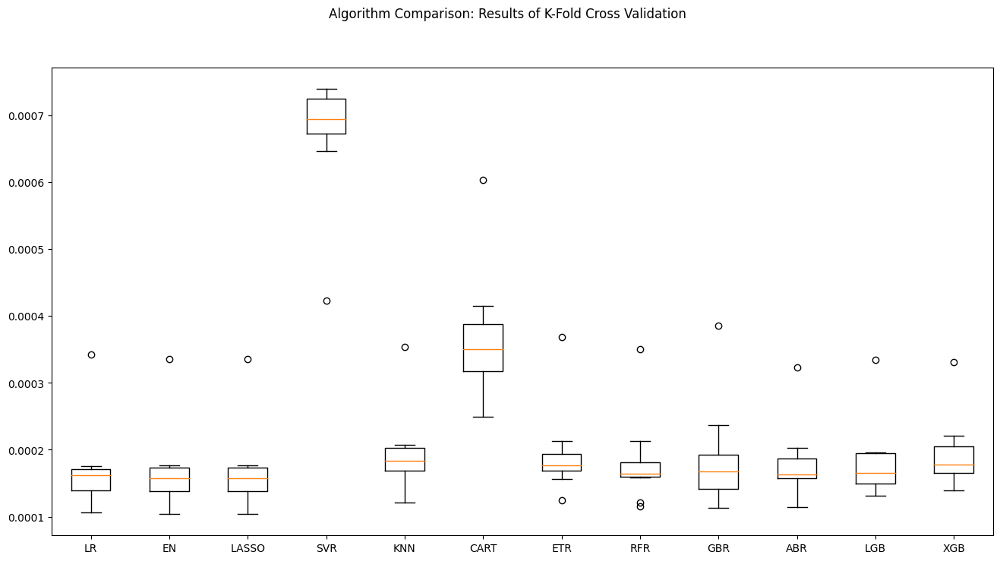

In [169]:
fig = plt.figure(figsize = [16, 8]
                )

fig.suptitle("Algorithm Comparison: Results of K-Fold Cross Validation")

ax = fig.add_subplot(111)

plt.boxplot(kfold_results)

ax.set_xticklabels(names)

plt.show()

#### ARIMA

In [170]:
# Basic Set-up for ARIMA

X_train_ARIMA =\
    (X_train
    .loc[ : , :]
   )

X_test_ARIMA =\
    (X_test
    .loc[ : , :]
)    

train_len = len(X_train_ARIMA)
test_len = len(X_test_ARIMA)
total_len = len(X)

In [171]:
modelARIMA =\
(    stats
     .ARIMA(endog = Y_train,
                exog = X_train_ARIMA,
                order = [1, 0, 0]   # Hyperparameters to be tuned
            )
)

model_fit = modelARIMA.fit()

In [172]:
error_training_ARIMA =\
(    mean_squared_error(Y_train,
                       model_fit.fittedvalues)
)

predicted =\
(
    model_fit
    .predict(start = train_len - 1,
             end = total_len - 1,
             exog = X_test_ARIMA)[1: ]
)

In [173]:
error_testing_ARIMA =\
(    mean_squared_error(Y_test,
                        predicted)
)

error_testing_ARIMA

0.0001503653098866575

In [174]:
test_results.append(error_testing_ARIMA)

train_results.append(error_training_ARIMA)

names.append("ARIMA")

#### Comparison of Algorithms

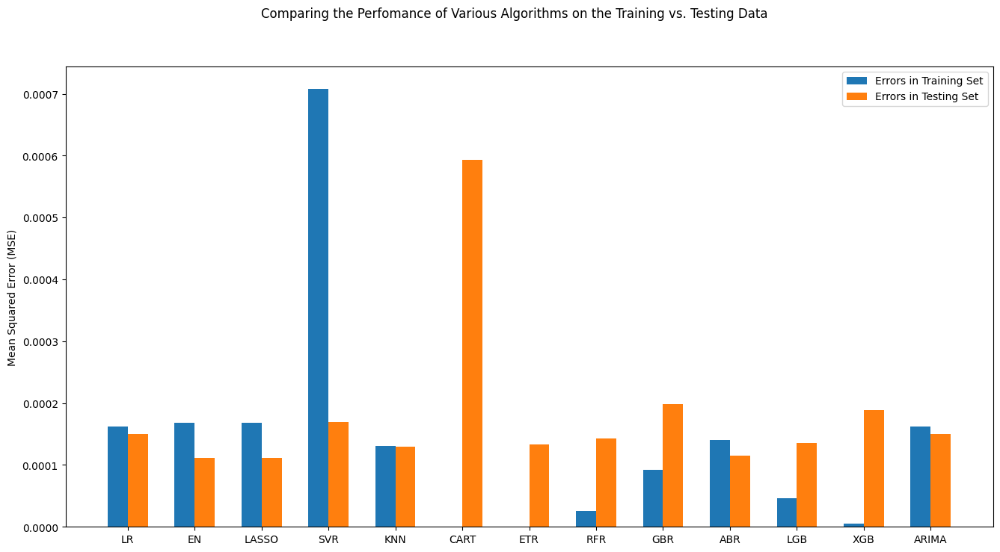

In [175]:
fig = plt.figure(figsize = [16, 8])

ind = np.arange(len(names)
               )

width = 0.30

fig.suptitle("Comparing the Perfomance of Various Algorithms on the Training vs. Testing Data")

ax = fig.add_subplot(111)

(plt
 .bar(ind - width/2,
    
      # Team, this line calculates the starting x position of the bars 
      # representing "Errors in Training Set". 
      # The width/2 term is used to shift the bars to the left, 
      # so they are centered around the tick mark for each group (algorithm) on the x-axis.
      
      # The bar chart will have two sets of bars for each algorithm: 
      # one for training errors and one for testing errors. 
      
      # By subtracting width/2 from ind, 
      # the training error bars are positioned to the left of the center of the tick marks. 
      
      train_results,
      width = width,
      label = "Errors in Training Set")
)

(plt
 .bar(ind + width/2,
      test_results,
      width = width,
      label = "Errors in Testing Set")
)

plt.legend()

ax.set_xticks(ind)
ax.set_xticklabels(names)

plt.ylabel("Mean Squared Error (MSE)")

plt.show()

#### Get predicted results from chosen model

In [176]:
model=Lasso()

In [177]:
# Fitting the Model on the Entire Training Set:
  
res = model.fit(X_train, Y_train) # The model is trained on the entire training dataset.

### Evaluating Model on Training Set:

# The trained model’s predictions on the training set are evaluated 
# using the mean squared error, and the result is appended to train_results.

train_result = res.predict(X_train)


## Evaluating Model on Testing Set:    

# Similarly, the model’s performance is evaluated 
# on the testing set and appended to test_results.

test_result = res.predict(X_test)

In [178]:
Train_result = pd.DataFrame(data=train_result,
                            index=X_train.index, 
                            columns=["Result"])

In [179]:
Test_result = pd.DataFrame(data=test_result, 
                            index=X_test.index, 
                            columns=["Result"])

In [180]:
Overall_results = pd.concat([Train_result, Test_result], 
                            axis=0)
Overall_results

,Result
Date,
2007-03-01,0.000385
2007-03-02,0.000385
2007-03-05,0.000385
2007-03-06,0.000385
2007-03-07,0.000385
...,...
2024-10-25,0.000385
2024-10-28,0.000385
2024-10-29,0.000385


In [181]:
Temp_df = pd.merge(Combined_overall_df,Overall_results,
                       left_index=True,
                       right_index=True)

In [182]:
Temp_df

,D1_forward_return,M1_return,M2_return,M3_return,M4_return,M5_return,M6_return,M7_return,M8_return,M9_return,...,Crude_10M,Gold_10M,Copper_10M,Crude_11M,Gold_11M,Copper_11M,Crude_12M,Gold_12M,Copper_12M,Result
Date,,,,,,,,,,,,,,,,,,,,,
2007-03-01,-0.013181,-0.016096,-0.014134,0.020542,0.017945,0.054937,0.084387,0.103349,0.128911,0.122558,...,-0.142225,-0.005406,-0.201022,-0.071022,0.123685,0.061894,-0.026229,0.170141,0.205772,0.000385
2007-03-02,-0.009565,-0.035978,-0.025207,0.003036,0.011052,0.042130,0.070056,0.091184,0.095731,0.098257,...,-0.118673,-0.048502,-0.250487,-0.069304,0.094710,0.046435,-0.012338,0.156064,0.223535,0.000385
2007-03-05,0.016965,-0.051508,-0.030615,-0.016905,0.002213,0.033388,0.059878,0.086559,0.086087,0.079170,...,-0.144180,-0.066696,-0.261051,-0.104369,0.083007,0.011416,-0.024521,0.151981,0.215919,0.000385
2007-03-06,-0.001003,-0.035925,-0.011883,-0.000367,0.019323,0.054103,0.076996,0.096787,0.098975,0.094040,...,-0.130142,-0.050162,-0.250867,-0.106712,0.081653,0.009154,0.011163,0.186728,0.243268,0.000385
2007-03-07,0.008420,-0.037205,-0.015006,0.000838,0.025092,0.050998,0.070040,0.093133,0.103701,0.107718,...,-0.125477,-0.069774,-0.250000,-0.082653,0.105710,0.038008,0.022325,0.192667,0.257428,0.000385
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
2024-10-25,0.003087,0.011708,0.033715,0.064089,0.061138,0.095137,0.136662,0.107749,0.142384,0.181652,...,-0.050152,0.331698,0.113978,-0.049775,0.368944,0.143026,-0.137363,0.379277,0.216057,0.000385
2024-10-28,0.001617,0.016246,0.042624,0.072255,0.068167,0.105250,0.136213,0.111026,0.146793,0.176850,...,-0.090811,0.317498,0.098516,-0.099920,0.363406,0.151362,-0.212298,0.379312,0.192075,0.000385
2024-10-29,-0.003030,0.013864,0.044152,0.057748,0.067728,0.113523,0.153798,0.114385,0.144822,0.179241,...,-0.063536,0.334876,0.107207,-0.120403,0.357258,0.139832,-0.183453,0.386835,0.187149,0.000385


<Axes: xlabel='Date'>

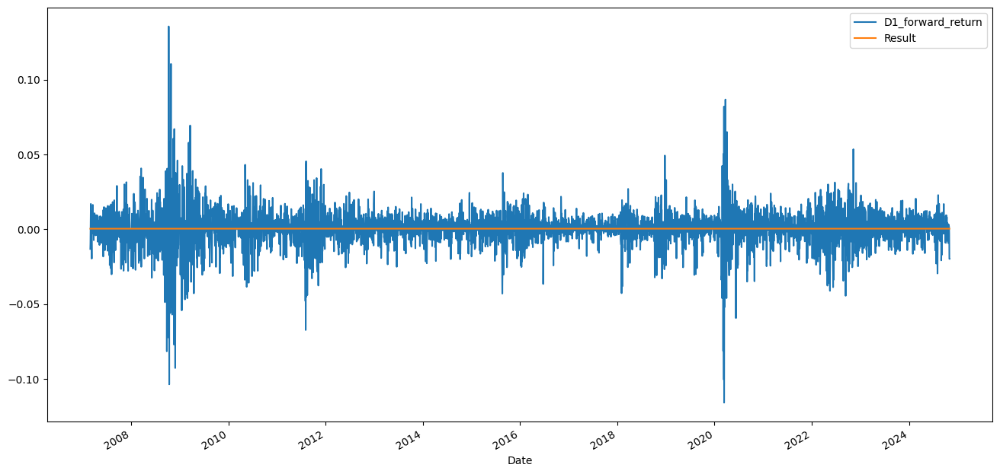

In [183]:
Temp_df \
    [["D1_forward_return", "Result"]] \
    .plot(figsize = (16, 8)
         )

### <a id = "p5g">5g.</a>  <font color = "green"> LightGBM </font>  [back to table of contents](#top)

In [184]:
# Define the Optuna objective function for tuning LightGBM hyperparameters
def LightGBM_objective(trial, 
                        train_features, 
                        train_target, 
                        val_features, 
                        val_target):
    
    param = {
        "objective": "regression",
        "boosting_type": "gbdt",                                              # Gradient Boosting Decision Tree
        "verbosity": -1,                                                      # Suppress output
        "n_jobs": -1,                                                         # Use all available cores
        
        # Regularization and Complexity Control
        "max_depth": trial.suggest_int("max_depth", 3, 10),                  # Max number of features in tree depth
        "num_leaves": trial.suggest_int("num_leaves", 5, 50),                # Affects model capacity
        "min_split_gain": trial.suggest_float("min_split_gain", 0.01, 0.10),  # Min gain for a split
        
        # Control overfitting with these parameters
        "reg_alpha": trial.suggest_loguniform("reg_alpha", 1e-8, 1.0),       # L1 regularization
        "reg_lambda": trial.suggest_loguniform("reg_lambda",1e-8, 1.0),      # L2 regularization
        
        # Learning parameters
        "learning_rate": trial.suggest_float("learning_rate", 0.001, 0.1),     # Step size
        "n_estimators": trial.suggest_int("n_estimators", 50, 200),            # Number of boosting iterations
        
        # Sampling parameters
        "colsample_bytree": trial.suggest_float("colsample_bytree", 0.1, 1.0),  # Feature sampling
        "subsample": trial.suggest_float("subsample", 0.5, 1.0),                # Data sampling per iteration
        
        # Minimum data requirements for splits
        "min_child_samples": trial.suggest_int("min_child_samples", 5, 100),            # Min samples per leaf
        "min_child_weight": trial.suggest_loguniform("min_child_weight", 1e-3, 10.0),   # Min sum of instance weights
        
    }
    
    # Train the LightGBM model using the parameters suggested by Optuna
    model = lgb.LGBMRegressor(**param)
    model.fit(
        train_features, train_target,
        eval_set=[(val_features, val_target)],
        eval_metric="rmse",
        callbacks=[lgb.log_evaluation(0)]  # Disable logging output
    )

    # Validate on the validation set
    val_predictions = model.predict(val_features)
    
    # Calculate R² score (you can change this to MAE or RMSE if desired)
    #r2 = r2_score(val_target, val_predictions)
    #return r2  # Optuna will try to maximize this R² score
    
    # Calculate RMSE
    rmse = np.sqrt(mean_squared_error(val_target, val_predictions))

    return rmse 

In [185]:
# Optuna optimization
def LightGBM_optuna_objective(trial, 
                            training_features_df, 
                            training_target):
    
    tscv = TimeSeriesSplit(n_splits=5)
    #best_r2 = float('-inf')
    best_rmse = float('inf')  # Initialize to infinity for minimization
    
    for train_index, val_index in tscv.split(training_features_df):
        X_train, X_valid = training_features_df.iloc[train_index], training_features_df.iloc[val_index]
        y_train, y_valid = training_target.iloc[train_index], training_target.iloc[val_index]

        # Perform Optuna optimization
        optuna_score = LightGBM_objective(trial = trial, 
                                    train_features = X_train, 
                                    train_target = y_train, 
                                    val_features = X_valid, 
                                    val_target = y_valid)
        
        # Be careful whether is max or min 
        #best_r2 = max(best_r2, optuna_score)
        
        # Track the minimum RMSE across splits
        best_rmse = min(best_rmse, optuna_score)
        
    return best_rmse

In [186]:
# Preparing Data for LightGBM
LightGBM_train_df=X_train.reset_index(drop=True)

LightGBM_target_df=Y_train

LightGBM_test_df=X_test.reset_index(drop=True)

# Feature Preprocessing
# Feature Scaling: Fit on Training Data, Transform on Both
scaler = MinMaxScaler()
LightGBM_train_df_transformed = scaler.fit_transform(LightGBM_train_df)  # Fit and transform on training data
LightGBM_test_df_transformed = scaler.transform(LightGBM_test_df)        # Transform test data

LightGBM_train_df=pd.DataFrame(data=LightGBM_train_df_transformed,
                        columns=LightGBM_train_df.columns,
                        index=LightGBM_train_df.index)

LightGBM_test_df=pd.DataFrame(data=LightGBM_test_df_transformed,
                        columns=LightGBM_test_df.columns,
                        index=LightGBM_test_df.index)

# Setting Up Training and Testing Features
training_features_df = LightGBM_train_df  
testing_features_df = LightGBM_test_df    

# Prepare the target variables
training_target = LightGBM_target_df

# # Set up Optuna study to maximize R² score
# study = optuna.create_study(direction="maximize", 
#                             sampler=optuna.samplers.TPESampler(),  
#                             pruner=optuna.pruners.MedianPruner()) 

# Initialize Optuna study to minimize RMSE
study = optuna.create_study(direction="minimize",  # Changed from 'maximize' to 'minimize'
                        sampler=optuna.samplers.TPESampler(seed=627), 
                        pruner=optuna.pruners.MedianPruner())

# Optimize with Optuna
study.optimize(lambda trial: LightGBM_optuna_objective(trial, 
                                            training_features_df, 
                                            training_target), 
            n_trials=40) # Number of trials can be adjusted, lesser = faster

# Best parameters found by Optuna
best_params = study.best_params

# Initialize the LightGBM model with the best parameters
best_model = lgb.LGBMRegressor(**best_params,
                                verbose=-1,
                                random_state=627)

# Fit the best model on the training data
best_model.fit(training_features_df, 
            training_target,
            eval_set=[(training_features_df,training_target)],     # You can add a validation set here instead
            eval_metric="rmse",                                    # Or use any other relevant metric: 'mae', 'r2', etc.
            callbacks=[lgb.log_evaluation(0)]
            )                                  

# Make predictions on training data
LightGBM_results_train = best_model.predict(training_features_df)

# Make predictions on testing data
LightGBM_results_test = best_model.predict(testing_features_df)

LightGBM_results = np.concatenate((LightGBM_results_train, LightGBM_results_test))

# Extract the first split variable of the first tree
model_dump = best_model.booster_.dump_model()
first_tree = model_dump['tree_info'][0]['tree_structure']
if 'split_feature' in first_tree:
    split_feature_index = first_tree['split_feature']
    feature_names = best_model.booster_.feature_name()
    first_split_feature_name = feature_names[split_feature_index]
else:
    split_feature_index = None
    feature_names = None
    first_split_feature_name = None  # or 'No splits'


# Get the LightGBM split results as a dataframe
LightGBM_splits_df=trees_to_dataframe(best_model)

# Plotting the Tree Diagram
try:
    Tree_image = lgb.create_tree_digraph(best_model, 
                                    tree_index=0, 
                                    orientation='vertical',
                                    show_info=['split_gain', 
                                                'internal_value', 
                                                'internal_count', 
                                                'leaf_count'])
    
    Tree_image.render(filename=f"SPY_First_Tree", format="png", cleanup=True)
except:
    Tree_image = None
    #print("Failed to plot tree, most likely tree failed to split")

LightGBM_predicted_returns_df = pd.DataFrame(data=LightGBM_results,
                                             index=Combined_overall_df.index,
                                             columns=["ML_SPY_Predicted_Returns"])

# Save results to csv
LightGBM_splits_df.to_csv(path_or_buf=f"SPY_LightGBM_splits_df.csv")
LightGBM_predicted_returns_df.to_csv(path_or_buf="LightGBM_predicted_returns_df.csv")
    
# Clearing GPU Memory
del (LightGBM_train_df, 
        LightGBM_target_df, 
        LightGBM_test_df,   
        training_features_df,
        testing_features_df,
        training_target,
        best_model, 
        LightGBM_results,
        model_dump,
        first_tree,
        split_feature_index,
        feature_names,
        first_split_feature_name,
        LightGBM_splits_df,
        Tree_image,
        )

gc.collect()  

[I 2024-11-24 00:23:03,748] A new study created in memory with name: no-name-d115929e-57f5-4ebf-b0e1-66a15a353591
[I 2024-11-24 00:23:03,969] Trial 0 finished with value: 0.007370534380617308 and parameters: {'max_depth': 4, 'num_leaves': 23, 'min_split_gain': 0.06700183106028701, 'reg_alpha': 3.685159417391458e-08, 'reg_lambda': 0.003185939122575007, 'learning_rate': 0.024029562784163065, 'n_estimators': 124, 'colsample_bytree': 0.1303123185835467, 'subsample': 0.9515619134184679, 'min_child_samples': 87, 'min_child_weight': 0.030027707006668777}. Best is trial 0 with value: 0.007370534380617308.
[I 2024-11-24 00:23:04,216] Trial 1 finished with value: 0.007370534380617308 and parameters: {'max_depth': 9, 'num_leaves': 39, 'min_split_gain': 0.03497629502822273, 'reg_alpha': 0.009378512464219042, 'reg_lambda': 2.3058634063567974e-07, 'learning_rate': 0.07767290073208453, 'n_estimators': 141, 'colsample_bytree': 0.9332519942030408, 'subsample': 0.6434774632658852, 'min_child_samples': 2

9901

In [187]:
LightGBM_predicted_returns_df

,ML_SPY_Predicted_Returns
Date,
2007-03-01,0.000385
2007-03-02,0.000385
2007-03-05,0.000385
2007-03-06,0.000385
2007-03-07,0.000385
...,...
2024-10-25,0.000385
2024-10-28,0.000385
2024-10-29,0.000385


In [188]:
LightGBM_strategy = analyze_ML_performance (predicted_returns_df = LightGBM_predicted_returns_df,
                                            Long_Short = "Long-Short",
                                            Strategy = "LightGBM")

During this period, LightGBM Strategy Cumulative Return was 567.01%
During this period, LightGBM Strategy Annualized Return was 10.32%
During this period, LightGBM Strategy Annualized Standard Deviation was 19.9%
During this period, LightGBM Strategy Sharpe Ratio was 0.52
During this period, LightGBM Strategy Sortino Ratio was 0.62
During this period, LightGBM Strategy Calmar Ratio was 0.19
During this period, LightGBM Strategy Treynor Ratio was 10.32
During this period, LightGBM Strategy Max Drawdown was -55.19%
During this period, LightGBM Strategy Max Drawdown Duration was 1772 days
During this period, LightGBM Strategy 1 day VaR at the 99% CI was -4.0 %
During this period, LightGBM Strategy 1 month VaR at the 99% CI was -17.0 %
During this period, LightGBM Strategy 1 year VaR at the 99% CI was -57.99999999999999 %
During this period, LightGBM Strategy Information Ratio against SP500 was -inf
The past 12m LightGBM Strategy Rolling Beta against SP500 was 1.0


In [189]:
LightGBM_strategy

,Adj Close,SPY_log_returns,SPY_cumulative_returns,ML_SPY_Predicted_Returns,Position,Trades,strategy_returns,Returns,CumulativeStrategyReturns,HighWaterMark,Drawdown,MaxDrawdown,HighWaterMarkDate,DrawdownDuration,MaximumDrawdownDuration,Rolling beta,Capital
Date,,,,,,,,,,,,,,,,,
2007-03-02,98.973541,-0.013181,117838.080983,0.000385,1.0,NaN,-0.013181,-0.013181,0.986905,0.986905,0.000000,0.000000,2007-03-02,0 days,0 days,NaN,98690.522814
2007-03-05,98.031357,-0.009565,116716.314439,0.000385,1.0,0.0,-0.009565,-0.009565,0.977510,0.986905,-0.009520,-0.009520,2007-03-02,3 days,3 days,NaN,97751.032577
2007-03-06,99.708664,0.016965,118713.319404,0.000385,1.0,0.0,0.016965,0.016965,0.994235,0.994235,0.000000,-0.009520,2007-03-06,0 days,3 days,NaN,99423.543385
2007-03-07,99.608688,-0.001003,118594.288287,0.000385,1.0,0.0,-0.001003,-0.001003,0.993239,0.994235,-0.001003,-0.009520,2007-03-06,1 days,3 days,NaN,99323.853683
2007-03-08,100.450951,0.008420,119597.087298,0.000385,1.0,0.0,0.008420,0.008420,1.001637,1.001637,0.000000,-0.009520,2007-03-08,0 days,3 days,NaN,100163.707471
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
2024-10-25,579.039978,-0.000345,689406.067063,0.000385,1.0,0.0,-0.000345,-0.000345,5.773842,5.829184,-0.009494,-0.551894,2024-10-18,7 days,1772 days,1.0,577384.192122
2024-10-28,580.830017,0.003087,691537.290876,0.000385,1.0,0.0,0.003087,0.003087,5.791691,5.829184,-0.006432,-0.551894,2024-10-18,10 days,1772 days,1.0,579169.112503
2024-10-29,581.770020,0.001617,692656.459518,0.000385,1.0,0.0,0.001617,0.001617,5.801064,5.829184,-0.004824,-0.551894,2024-10-18,11 days,1772 days,1.0,580106.426973


### <a id = "p5h">5h.</a>  <font color = "green"> XGBoost </font>  [back to table of contents](#top)

In [190]:
# Define the Optuna objective function for tuning XGBoost hyperparameters
def XGBoost_objective(trial, 
                      train_features, 
                      train_target, 
                      val_features, 
                      val_target):
    
    param = {
        "objective": "reg:squarederror",
        "verbosity": 0,                                                       # Suppress output
        "n_jobs": -1,                                                         # Use all available cores
        "tree_method": "hist",                                               
        
        # Regularization and Complexity Control
        "max_depth": trial.suggest_int("max_depth", 3, 7),                    # Max number of features in tree depth
        "num_leaves": trial.suggest_int("num_leaves", 5, 50),                 # Affects model capacity
        "min_split_gain": trial.suggest_float("min_split_gain", 0.01, 0.10),  # Min gain for a split
        
        # Control overfitting with these parameters
        "reg_alpha": trial.suggest_loguniform("reg_alpha", 1e-8, 1.0),        # L1 regularization
        "reg_lambda": trial.suggest_loguniform("reg_lambda", 1e-8, 1.0),      # L2 regularization
        
        # Learning parameters
        "learning_rate": trial.suggest_float("learning_rate", 0.001, 0.1),     # Step size
        "n_estimators": trial.suggest_int("n_estimators", 50, 100),            # Number of boosting iterations
        
        # Sampling parameters
        "colsample_bytree": trial.suggest_float("colsample_bytree", 0.1, 0.9),  # Feature sampling
        "subsample": trial.suggest_float("subsample", 0.5, 1.0),                # Data sampling per iteration
        
        # Minimum data requirements for splits
        "min_child_samples": trial.suggest_int("min_child_samples", 5, 100),            # Min samples per leaf
        "min_child_weight": trial.suggest_loguniform("min_child_weight", 1e-3, 10.0),   # Min sum of instance weights
        
    }
    
    # Train the XGBoost model using the parameters suggested by Optuna
    model = XGBRegressor(**param)
    
    early_stopping_callback = xg.callback.EarlyStopping(
        rounds=50,                        # Early stopping after 50 rounds
        save_best=True,                   # Save the best iteration
        maximize=False,                   # Minimizing RMSE, so we set maximize to False
        data_name="validation_0",         # Validation dataset
        metric_name="rmse"                # Monitor RMSE for early stopping
    )
    
    model.fit(
        train_features, 
        train_target,
        eval_set=[(val_features, val_target)],
        verbose = False,
    )

    # Validate on the validation set
    val_predictions = model.predict(val_features)
    
    # Calculate R² score (you can change this to MAE or RMSE if desired)
    #r2 = r2_score(val_target, val_predictions)
    #return r2  # Optuna will try to maximize this R² score
    
    # Calculate MSLE
    # Penalizes under-predictions more than over-predictions by taking the logarithm of predicted and actual values.
    # msle = mean_squared_log_error(val_target, val_predictions)
    # return msle  # Optuna minimizes MSLE
    
    # Calculate RMSE
    rmse = np.sqrt(mean_squared_error(val_target, val_predictions))
    # Return RMSE directly for Optuna to minimize it
    return rmse

In [191]:
# Optuna optimization
def XGBoost_optuna_objective(trial, 
                             training_features_df, 
                             training_target):
    
    # TimeSeries split for cross-validation
    tscv = TimeSeriesSplit(n_splits=3)
    
    #best_r2 = float('-inf')
    best_rmse = float('inf')  # Initialize to infinity for minimization
    best_msle = float('inf')  # Initialize to infinity for minimization
    
    # Iterate over train-validation splits
    for train_index, val_index in tscv.split(training_features_df):
        X_train, X_valid = training_features_df.iloc[train_index], training_features_df.iloc[val_index]
        y_train, y_valid = training_target.iloc[train_index], training_target.iloc[val_index]

        # Perform Optuna optimization
        optuna_score = XGBoost_objective(
            trial = trial, 
            train_features = X_train, 
            train_target = y_train, 
            val_features = X_valid, 
            val_target = y_valid
            )
        
        # Be careful whether is max or min 
        #best_r2 = max(best_r2, optuna_score)
        
        # Track the minimum MSLE across splits
        best_msle = min(best_msle, optuna_score)
        
        # Track the minimum RMSE across splits
        best_rmse = min(best_rmse, optuna_score)
    
    #return best_msle    
    return best_rmse

In [192]:
# Preparing Data for XGBoost
XGBoost_train_df=X_train.reset_index(drop=True)

XGBoost_target_df=Y_train

XGBoost_test_df=X_test.reset_index(drop=True)

# Feature Preprocessing
# Feature Scaling: Fit on Training Data, Transform on Both
scaler = MinMaxScaler()
XGBoost_train_df_transformed = scaler.fit_transform(XGBoost_train_df)  # Fit and transform on training data
XGBoost_test_df_transformed = scaler.transform(XGBoost_test_df)        # Transform test data

XGBoost_train_df=pd.DataFrame(data=XGBoost_train_df_transformed,
                        columns=XGBoost_train_df.columns,
                        index=XGBoost_train_df.index)

XGBoost_test_df=pd.DataFrame(data=XGBoost_test_df_transformed,
                        columns=XGBoost_test_df.columns,
                        index=XGBoost_test_df.index)

# Setting Up Training and Testing Features
training_features_df = XGBoost_train_df  
testing_features_df = XGBoost_test_df    

# Prepare the target variables
training_target = XGBoost_target_df

# # Set up Optuna study to maximize R² score
# study = optuna.create_study(direction="maximize",                        # Be careful to change maximize or minimize
#                             sampler=optuna.samplers.TPESampler(),      
#                             pruner=optuna.pruners.MedianPruner())       

# Initialize Optuna study to minimize RMSE
study = optuna.create_study(direction="minimize",                      # Changed from 'maximize' to 'minimize'
                            sampler=optuna.samplers.TPESampler(seed=627),      # can set seed here
                            pruner=optuna.pruners.MedianPruner())


# Optimize with Optuna
study.optimize(lambda trial: XGBoost_optuna_objective(trial, 
                                                        training_features_df, 
                                                        training_target), 
            n_trials=40) # Number of trials can be adjusted, lesser = faster

# Best parameters found by Optuna
best_params = study.best_params

# Initialize the XGBoost model with the best parameters
best_model = XGBRegressor(**best_params,
                        objective="reg:absoluteerror", 
                        random_state=627,
                        verbosity=0,
                        early_stopping_rounds = 100)

# Fit the best model on the training data
best_model.fit(training_features_df, 
            training_target,
            eval_set=[(training_features_df,training_target)],     # You can add a validation set here instead
            verbose = False
            )                                    

# Make predictions on training data
XGBoost_results_train = best_model.predict(training_features_df)

# Make predictions on testing data
XGBoost_results_test = best_model.predict(testing_features_df)

XGBoost_results = np.concatenate((XGBoost_results_train,XGBoost_results_test))

# Extract the first split variable of the first tree
model_dump = best_model.get_booster().get_dump(with_stats=True)
first_tree = model_dump[0]  # Extract the first tree as text

split_feature_name = None
try:
    # Parse the first non-empty line containing a split
    split_line = next(line for line in first_tree.split('\n') if '[' in line)

    # Extract the feature index from the split line
    split_feature = split_line.split('[')[-1].split(']')[0]
    split_feature_name = (split_feature.split('<')[0])

except (IndexError, ValueError, StopIteration):
    # Handle cases with no splits or malformed dumps
    split_feature_name = 'No splits available'
    

# Get the XGBoost split results as a dataframe
XGBoost_splits_df = best_model.get_booster().trees_to_dataframe()

# Plot the first tree if possible
try:
    Tree_image = xg.to_graphviz(best_model, num_trees=0)
    Tree_image.render(filename=f"SPY_First_Tree_for_XGBoost", format="png", cleanup=True)
except Exception as e:
    Tree_image = None
    print(f"Failed to plot tree: {e}")

XGBoost_predicted_returns_df=pd.DataFrame(data=XGBoost_results,
                                          index=Combined_overall_df.index,
                                          columns=["ML_SPY_Predicted_Returns"])

# Save results to csv
XGBoost_splits_df.to_csv(path_or_buf=f"SPY_XGBoost_splits_df.csv")
XGBoost_predicted_returns_df.to_csv(path_or_buf="XGBoost_predicted_returns_df.csv")
    
# Clearing GPU Memory
del (XGBoost_train_df, 
    XGBoost_target_df, 
    XGBoost_test_df,   
    training_features_df,
    testing_features_df,
    training_target,
    best_model, 
    XGBoost_results,
    model_dump,
    first_tree,
    split_feature_name,
    XGBoost_splits_df,
    Tree_image,
    )

gc.collect()  

[I 2024-11-24 00:23:12,949] A new study created in memory with name: no-name-9f3e0710-212d-4080-9209-aec17cce6f1b
[I 2024-11-24 00:23:13,311] Trial 0 finished with value: 0.007848954374191811 and parameters: {'max_depth': 4, 'num_leaves': 23, 'min_split_gain': 0.06700183106028701, 'reg_alpha': 3.685159417391458e-08, 'reg_lambda': 0.003185939122575007, 'learning_rate': 0.024029562784163065, 'n_estimators': 75, 'colsample_bytree': 0.12694428318537485, 'subsample': 0.9515619134184679, 'min_child_samples': 87, 'min_child_weight': 0.030027707006668777}. Best is trial 0 with value: 0.007848954374191811.
[I 2024-11-24 00:23:14,142] Trial 1 finished with value: 0.008757398712999189 and parameters: {'max_depth': 7, 'num_leaves': 39, 'min_split_gain': 0.03497629502822273, 'reg_alpha': 0.009378512464219042, 'reg_lambda': 2.3058634063567974e-07, 'learning_rate': 0.07767290073208453, 'n_estimators': 80, 'colsample_bytree': 0.8406684392915919, 'subsample': 0.6434774632658852, 'min_child_samples': 21

17246

In [193]:
XGBoost_predicted_returns_df

,ML_SPY_Predicted_Returns
Date,
2007-03-01,0.000792
2007-03-02,0.000886
2007-03-05,0.000952
2007-03-06,0.000818
2007-03-07,0.000898
...,...
2024-10-25,0.000794
2024-10-28,0.000828
2024-10-29,0.000786


In [194]:
XGBoost_strategy = analyze_ML_performance (predicted_returns_df = XGBoost_predicted_returns_df,
                                            Long_Short = "Long-Short",
                                            Strategy = "XGBoost")

During this period, XGBoost Strategy Cumulative Return was 22725.88%
During this period, XGBoost Strategy Annualized Return was 35.95%
During this period, XGBoost Strategy Annualized Standard Deviation was 19.82%
During this period, XGBoost Strategy Sharpe Ratio was 1.81
During this period, XGBoost Strategy Sortino Ratio was 2.6
During this period, XGBoost Strategy Calmar Ratio was 1.47
During this period, XGBoost Strategy Treynor Ratio was 35.95
During this period, XGBoost Strategy Max Drawdown was -24.5%
During this period, XGBoost Strategy Max Drawdown Duration was 708 days
During this period, XGBoost Strategy 1 day VaR at the 99% CI was -3.0 %
During this period, XGBoost Strategy 1 month VaR at the 99% CI was -14.000000000000002 %
During this period, XGBoost Strategy 1 year VaR at the 99% CI was -49.0 %
During this period, XGBoost Strategy Information Ratio against SP500 was 1.63
The past 12m XGBoost Strategy Rolling Beta against SP500 was 1.0


In [195]:
XGBoost_strategy

,Adj Close,SPY_log_returns,SPY_cumulative_returns,ML_SPY_Predicted_Returns,Position,Trades,strategy_returns,Returns,CumulativeStrategyReturns,HighWaterMark,Drawdown,MaxDrawdown,HighWaterMarkDate,DrawdownDuration,MaximumDrawdownDuration,Rolling beta,Capital
Date,,,,,,,,,,,,,,,,,
2007-03-02,98.973541,-0.013181,117838.080983,0.000886,1.0,NaN,-0.013181,-0.013181,0.986905,0.986905,0.000000,0.000000,2007-03-02,0 days,0 days,NaN,9.869052e+04
2007-03-05,98.031357,-0.009565,116716.314439,0.000952,1.0,0.0,-0.009565,-0.009565,0.977510,0.986905,-0.009520,-0.009520,2007-03-02,3 days,3 days,NaN,9.775103e+04
2007-03-06,99.708664,0.016965,118713.319404,0.000818,1.0,0.0,0.016965,0.016965,0.994235,0.994235,0.000000,-0.009520,2007-03-06,0 days,3 days,NaN,9.942354e+04
2007-03-07,99.608688,-0.001003,118594.288287,0.000898,1.0,0.0,-0.001003,-0.001003,0.993239,0.994235,-0.001003,-0.009520,2007-03-06,1 days,3 days,NaN,9.932385e+04
2007-03-08,100.450951,0.008420,119597.087298,0.000895,1.0,0.0,0.008420,0.008420,1.001637,1.001637,0.000000,-0.009520,2007-03-08,0 days,3 days,NaN,1.001637e+05
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
2024-10-25,579.039978,-0.000345,689406.067063,0.000794,1.0,0.0,-0.000345,-0.000345,231.415224,233.633319,-0.009494,-0.244964,2024-10-18,7 days,708 days,1.0,2.314152e+07
2024-10-28,580.830017,0.003087,691537.290876,0.000828,1.0,0.0,0.003087,0.003087,232.130619,233.633319,-0.006432,-0.244964,2024-10-18,10 days,708 days,1.0,2.321306e+07
2024-10-29,581.770020,0.001617,692656.459518,0.000786,1.0,0.0,0.001617,0.001617,232.506294,233.633319,-0.004824,-0.244964,2024-10-18,11 days,708 days,1.0,2.325063e+07


### <a id = "p5i">5i.</a>  <font color = "green"> AdaBoost </font>  [back to table of contents](#top)

In [196]:
# Define the Optuna objective function for AdaBoost hyperparameters
def AdaBoost_objective(trial, 
                       train_features, 
                       train_target, 
                       val_features, 
                       val_target):
    
    # Define hyperparameters to be tuned
    param = {
        "n_estimators": trial.suggest_int("n_estimators", 50, 100),  # Number of boosting rounds
        "learning_rate": trial.suggest_float("learning_rate", 0.01, 0.5, log=True),  # Learning rate
        "loss": trial.suggest_categorical("loss", ["linear", "square"]),  # Loss function - took out "exponential"
        # Base Estimator parameters (e.g., DecisionTreeRegressor)
        "estimator_max_depth": trial.suggest_int("estimator_max_depth", 2, 10),  # Tree depth
        "estimator_min_samples_split": trial.suggest_int("estimator_min_samples_split", 2, 20),  # Min samples for split
    }

    # Initialize the base estimator
    base_estimator = DecisionTreeRegressor(
        max_depth=param["estimator_max_depth"],
        min_samples_split=param["estimator_min_samples_split"],
        random_state=627
    )
    
    # Initialize AdaBoostRegressor with the updated parameter
    model = AdaBoostRegressor(
        estimator=base_estimator,
        n_estimators=param["n_estimators"],
        learning_rate=param["learning_rate"],
        loss=param["loss"],
        random_state=627
    )

    # Fit the model
    model.fit(train_features, train_target)

    # Predict and evaluate RMSE on the validation set
    val_predictions = model.predict(val_features)
    rmse = np.sqrt(mean_squared_error(val_target, val_predictions))
    return rmse  # Optuna minimizes RMSE

In [197]:
# Define the cross-validation Optuna objective function
def AdaBoost_optuna_objective(trial, 
                              training_features_df, 
                              training_target):
    
    tscv = TimeSeriesSplit(n_splits=3)  # Time series split for cross-validation
    best_rmse = float("inf")  # Initialize to infinity for minimization

    for train_index, val_index in tscv.split(training_features_df):
        X_train, X_valid = training_features_df.iloc[train_index], training_features_df.iloc[val_index]
        y_train, y_valid = training_target.iloc[train_index], training_target.iloc[val_index]

        # Perform Optuna optimization
        optuna_score = AdaBoost_objective(
            trial=trial,
            train_features=X_train,
            train_target=y_train,
            val_features=X_valid,
            val_target=y_valid
        )

        # Track the minimum RMSE across splits
        best_rmse = min(best_rmse, optuna_score)

    return best_rmse

In [198]:
# Preparing the data for AdaBoost
AdaBoost_train_df = X_train.reset_index(drop=True)

AdaBoost_target_df = Y_train

AdaBoost_test_df = X_test.reset_index(drop=True)

# Feature scaling
scaler = MinMaxScaler()
AdaBoost_train_df_transformed = scaler.fit_transform(AdaBoost_train_df)
AdaBoost_test_df_transformed = scaler.transform(AdaBoost_test_df)

AdaBoost_train_df = pd.DataFrame(
    data=AdaBoost_train_df_transformed,
    columns=AdaBoost_train_df.columns,
    index=AdaBoost_train_df.index
)

AdaBoost_test_df = pd.DataFrame(
    data=AdaBoost_test_df_transformed,
    columns=AdaBoost_test_df.columns,
    index=AdaBoost_test_df.index
)

# Setting up Training and testing features
training_features_df = AdaBoost_train_df
testing_features_df = AdaBoost_test_df

# Prepare the target variable
training_target = AdaBoost_target_df

# Initialize Optuna study for minimization
study = optuna.create_study(
    direction="minimize",  # We are minimizing RMSE
    sampler=optuna.samplers.TPESampler(seed=627),
    pruner=optuna.pruners.MedianPruner()
)

# Optimize AdaBoost parameters using Optuna
study.optimize(
    lambda trial: AdaBoost_optuna_objective(trial, training_features_df, training_target),
    n_trials=10  # Adjust the number of trials for time/performance
)

# Best parameters from Optuna
best_params = study.best_params

# Initialize the AdaBoost model with the best parameters
best_model = AdaBoostRegressor(
    estimator=DecisionTreeRegressor(
        max_depth=best_params["estimator_max_depth"],  
        min_samples_split=best_params["estimator_min_samples_split"], 
        random_state=627
    ),
    n_estimators=best_params["n_estimators"],
    learning_rate=best_params["learning_rate"],
    loss=best_params["loss"],
    random_state=627
)

# Fit the best AdaBoost model on the training data
best_model.fit(training_features_df, training_target)

# Predictions on training and testing data
AdaBoost_results_train = best_model.predict(training_features_df)
AdaBoost_results_test = best_model.predict(testing_features_df)

AdaBoost_results = np.concatenate((AdaBoost_results_train, AdaBoost_results_test))

# Save results to a DataFrame
AdaBoost_predicted_returns_df = pd.DataFrame(
    data=AdaBoost_results,
    index=Combined_overall_df.index,
    columns=["ML_SPY_Predicted_Returns"]
)

# Save results to CSV
AdaBoost_predicted_returns_df.to_csv(path_or_buf="AdaBoost_predicted_returns_df.csv")

# Clear memory
del (
    AdaBoost_train_df,
    AdaBoost_target_df,
    AdaBoost_test_df,
    training_features_df,
    testing_features_df,
    training_target,
    best_model,
    AdaBoost_results
)

gc.collect()

[I 2024-11-24 00:23:33,177] A new study created in memory with name: no-name-c761613e-a29f-42dc-9490-99abcf7226fd
[I 2024-11-24 00:23:39,087] Trial 0 finished with value: 0.007845276705878475 and parameters: {'n_estimators': 60, 'learning_rate': 0.04685813261294667, 'loss': 'linear', 'estimator_max_depth': 8, 'estimator_min_samples_split': 6}. Best is trial 0 with value: 0.007845276705878475.
[I 2024-11-24 00:23:43,904] Trial 1 finished with value: 0.007796663564668295 and parameters: {'n_estimators': 75, 'learning_rate': 0.011408325690837379, 'loss': 'linear', 'estimator_max_depth': 5, 'estimator_min_samples_split': 17}. Best is trial 1 with value: 0.007796663564668295.
[I 2024-11-24 00:23:52,337] Trial 2 finished with value: 0.007866700494421577 and parameters: {'n_estimators': 88, 'learning_rate': 0.029613423877226045, 'loss': 'linear', 'estimator_max_depth': 8, 'estimator_min_samples_split': 13}. Best is trial 1 with value: 0.007796663564668295.
[I 2024-11-24 00:23:56,150] Trial 3 

935

In [199]:
AdaBoost_predicted_returns_df

,ML_SPY_Predicted_Returns
Date,
2007-03-01,0.000246
2007-03-02,0.000246
2007-03-05,0.000246
2007-03-06,0.000246
2007-03-07,0.000246
...,...
2024-10-25,0.000246
2024-10-28,0.000246
2024-10-29,0.000246


In [200]:
AdaBoost_strategy = analyze_ML_performance (predicted_returns_df = AdaBoost_predicted_returns_df,
                                            Long_Short = "Long-Short",
                                            Strategy = "AdaBoost")

During this period, AdaBoost Strategy Cumulative Return was 5367.51%
During this period, AdaBoost Strategy Annualized Return was 25.29%
During this period, AdaBoost Strategy Annualized Standard Deviation was 19.86%
During this period, AdaBoost Strategy Sharpe Ratio was 1.27
During this period, AdaBoost Strategy Sortino Ratio was 1.78
During this period, AdaBoost Strategy Calmar Ratio was 0.8
During this period, AdaBoost Strategy Treynor Ratio was 25.29
During this period, AdaBoost Strategy Max Drawdown was -31.66%
During this period, AdaBoost Strategy Max Drawdown Duration was 708 days
During this period, AdaBoost Strategy 1 day VaR at the 99% CI was -3.0 %
During this period, AdaBoost Strategy 1 month VaR at the 99% CI was -15.0 %
During this period, AdaBoost Strategy 1 year VaR at the 99% CI was -52.0 %
During this period, AdaBoost Strategy Information Ratio against SP500 was 1.02
The past 12m AdaBoost Strategy Rolling Beta against SP500 was 1.0


In [201]:
AdaBoost_strategy

,Adj Close,SPY_log_returns,SPY_cumulative_returns,ML_SPY_Predicted_Returns,Position,Trades,strategy_returns,Returns,CumulativeStrategyReturns,HighWaterMark,Drawdown,MaxDrawdown,HighWaterMarkDate,DrawdownDuration,MaximumDrawdownDuration,Rolling beta,Capital
Date,,,,,,,,,,,,,,,,,
2007-03-02,98.973541,-0.013181,117838.080983,0.000246,1.0,NaN,-0.013181,-0.013181,0.986905,0.986905,0.000000,0.00000,2007-03-02,0 days,0 days,NaN,9.869052e+04
2007-03-05,98.031357,-0.009565,116716.314439,0.000246,1.0,0.0,-0.009565,-0.009565,0.977510,0.986905,-0.009520,-0.00952,2007-03-02,3 days,3 days,NaN,9.775103e+04
2007-03-06,99.708664,0.016965,118713.319404,0.000246,1.0,0.0,0.016965,0.016965,0.994235,0.994235,0.000000,-0.00952,2007-03-06,0 days,3 days,NaN,9.942354e+04
2007-03-07,99.608688,-0.001003,118594.288287,0.000246,1.0,0.0,-0.001003,-0.001003,0.993239,0.994235,-0.001003,-0.00952,2007-03-06,1 days,3 days,NaN,9.932385e+04
2007-03-08,100.450951,0.008420,119597.087298,0.000246,1.0,0.0,0.008420,0.008420,1.001637,1.001637,0.000000,-0.00952,2007-03-08,0 days,3 days,NaN,1.001637e+05
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
2024-10-25,579.039978,-0.000345,689406.067063,0.000246,1.0,0.0,-0.000345,-0.000345,54.656770,55.180650,-0.009494,-0.31658,2024-10-18,7 days,708 days,1.0,5.465677e+06
2024-10-28,580.830017,0.003087,691537.290876,0.000246,1.0,0.0,0.003087,0.003087,54.825735,55.180650,-0.006432,-0.31658,2024-10-18,10 days,708 days,1.0,5.482574e+06
2024-10-29,581.770020,0.001617,692656.459518,0.000246,1.0,0.0,0.001617,0.001617,54.914464,55.180650,-0.004824,-0.31658,2024-10-18,11 days,708 days,1.0,5.491446e+06


### <a id = "p5j">5j.</a>  <font color = "green"> Linear Regression </font>  [back to table of contents](#top)

In [202]:
# Add a constant column to X_train
X_train_with_constant = np.c_[np.ones(X_train.shape[0]), X_train]

# Add the constant column to X for prediction
X_with_constant = np.c_[np.ones(X.shape[0]), X]

In [203]:
OLS =\
    np \
    .linalg \
    .lstsq(X_train_with_constant,
           Y_train,
           rcond = None)[0]

OLS

array([ 9.42893438e-03, -7.37596210e-02, -9.78437976e-04,  8.93506269e-03,
       -2.05515043e-03,  8.69444712e-04, -1.36886822e-03, -1.34511348e-01,
       -2.77081414e-04,  1.93400864e-04, -1.70745837e-05,  2.66046285e-05,
       -3.33156933e-06, -9.02025663e-03,  3.03244199e-02, -6.64616248e-03,
       -1.41931095e-02, -1.23085902e-03, -9.97389918e-03,  1.60278977e-03,
       -9.31691658e-04, -2.25359566e-04,  6.06427312e-03, -2.85293422e-03,
        2.43263101e-03, -4.71960703e-04,  1.36993117e-04,  9.63661623e-05,
        8.09885532e-03,  9.61335056e-04, -5.21351795e-03,  2.62849801e-03,
       -9.89862931e-03,  9.35729524e-03, -1.39801016e-03,  1.95916707e-03,
        1.86860161e-03])

In [204]:
Regression_predicted_returns_df = pd.DataFrame(index=X.index,
                                   columns=["ML_SPY_Predicted_Returns"])

In [205]:
Regression_predicted_returns_df["ML_SPY_Predicted_Returns"] =\
    np \
    .dot(X_with_constant,
         OLS)

In [206]:
Regression_predicted_returns_df

,ML_SPY_Predicted_Returns
Date,
2007-03-01,-0.002550
2007-03-02,-0.001734
2007-03-05,-0.002251
2007-03-06,-0.004412
2007-03-07,-0.000718
...,...
2024-10-25,-0.010316
2024-10-28,-0.010177
2024-10-29,-0.009291


In [207]:
Linear_Regression_strategy = analyze_ML_performance (predicted_returns_df = Regression_predicted_returns_df,
                                            Long_Short = "Long-Short",
                                            Strategy = "Linear Regression")

During this period, Linear Regression Strategy Cumulative Return was 5150.38%
During this period, Linear Regression Strategy Annualized Return was 25.0%
During this period, Linear Regression Strategy Annualized Standard Deviation was 19.86%
During this period, Linear Regression Strategy Sharpe Ratio was 1.26
During this period, Linear Regression Strategy Sortino Ratio was 1.92
During this period, Linear Regression Strategy Calmar Ratio was 0.58
During this period, Linear Regression Strategy Treynor Ratio was -25.0
During this period, Linear Regression Strategy Max Drawdown was -42.77%
During this period, Linear Regression Strategy Max Drawdown Duration was 889 days
During this period, Linear Regression Strategy 1 day VaR at the 99% CI was -3.0 %
During this period, Linear Regression Strategy 1 month VaR at the 99% CI was -13.0 %
During this period, Linear Regression Strategy 1 year VaR at the 99% CI was -45.0 %
During this period, Linear Regression Strategy Information Ratio against SP

In [208]:
Linear_Regression_strategy

,Adj Close,SPY_log_returns,SPY_cumulative_returns,ML_SPY_Predicted_Returns,Position,Trades,strategy_returns,Returns,CumulativeStrategyReturns,HighWaterMark,Drawdown,MaxDrawdown,HighWaterMarkDate,DrawdownDuration,MaximumDrawdownDuration,Rolling beta,Capital
Date,,,,,,,,,,,,,,,,,
2007-03-02,98.973541,-0.013181,117838.080983,-0.001734,-1.0,NaN,0.013181,0.013181,1.013269,1.013269,0.000000,0.000000,2007-03-02,0 days,0 days,NaN,1.013269e+05
2007-03-05,98.031357,-0.009565,116716.314439,-0.002251,-1.0,0.0,0.009565,0.009565,1.023007,1.023007,0.000000,0.000000,2007-03-05,0 days,0 days,NaN,1.023007e+05
2007-03-06,99.708664,0.016965,118713.319404,-0.004412,-1.0,0.0,-0.016965,-0.016965,1.005798,1.023007,-0.016822,-0.016822,2007-03-05,1 days,1 days,NaN,1.005798e+05
2007-03-07,99.608688,-0.001003,118594.288287,-0.000718,-1.0,0.0,0.001003,0.001003,1.006807,1.023007,-0.015835,-0.016822,2007-03-05,2 days,2 days,NaN,1.006807e+05
2007-03-08,100.450951,0.008420,119597.087298,-0.001648,-1.0,0.0,-0.008420,-0.008420,0.998366,1.023007,-0.024087,-0.024087,2007-03-05,3 days,3 days,NaN,9.983656e+04
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
2024-10-25,579.039978,-0.000345,689406.067063,-0.010316,-1.0,0.0,0.000345,0.000345,50.578720,87.531535,-0.422166,-0.427652,2022-05-26,883 days,883 days,-1.0,5.057872e+06
2024-10-28,580.830017,0.003087,691537.290876,-0.010177,-1.0,0.0,-0.003087,-0.003087,50.422843,87.531535,-0.423947,-0.427652,2022-05-26,886 days,886 days,-1.0,5.042284e+06
2024-10-29,581.770020,0.001617,692656.459518,-0.009291,-1.0,0.0,-0.001617,-0.001617,50.341372,87.531535,-0.424877,-0.427652,2022-05-26,887 days,887 days,-1.0,5.034137e+06


### <a id = "p5k">5k.</a>  <font color = "green"> Logistic Regression </font>  [back to table of contents](#top)

In [209]:
Y_train_binary = np.sign(Y_train)

Y_binary = np.sign(Y)

In [210]:
lr = LogisticRegression()

In [211]:
# Fit logistic regression model

lr.fit(X_train_with_constant, Y_train_binary)

LogisticRegression()

In [212]:
# Generate predictions on test set

y_pred = lr.predict(X_with_constant)

y_pred

array([1., 1., 1., ..., 1., 1., 1.])

In [213]:
Logistic_predicted_returns_df = pd.DataFrame(index=X.index,
                                            columns=["ML_SPY_Predicted_Returns"],
                                            data=y_pred)

In [214]:
Logistic_predicted_returns_df

,ML_SPY_Predicted_Returns
Date,
2007-03-01,1.0
2007-03-02,1.0
2007-03-05,1.0
2007-03-06,1.0
2007-03-07,1.0
...,...
2024-10-25,1.0
2024-10-28,1.0
2024-10-29,1.0


In [215]:
Logistic_Regression_strategy = analyze_ML_performance (predicted_returns_df = Logistic_predicted_returns_df,
                                            Long_Short = "Long-Short",
                                            Strategy = "Logistic Regression")

During this period, Logistic Regression Strategy Cumulative Return was 1014.57%
During this period, Logistic Regression Strategy Annualized Return was 14.01%
During this period, Logistic Regression Strategy Annualized Standard Deviation was 19.89%
During this period, Logistic Regression Strategy Sharpe Ratio was 0.7
During this period, Logistic Regression Strategy Sortino Ratio was 0.84
During this period, Logistic Regression Strategy Calmar Ratio was 0.38
During this period, Logistic Regression Strategy Treynor Ratio was 14.01
During this period, Logistic Regression Strategy Max Drawdown was -36.98%
During this period, Logistic Regression Strategy Max Drawdown Duration was 708 days
During this period, Logistic Regression Strategy 1 day VaR at the 99% CI was -4.0 %
During this period, Logistic Regression Strategy 1 month VaR at the 99% CI was -16.0 %
During this period, Logistic Regression Strategy 1 year VaR at the 99% CI was -56.00000000000001 %
During this period, Logistic Regressio

In [216]:
Logistic_Regression_strategy

,Adj Close,SPY_log_returns,SPY_cumulative_returns,ML_SPY_Predicted_Returns,Position,Trades,strategy_returns,Returns,CumulativeStrategyReturns,HighWaterMark,Drawdown,MaxDrawdown,HighWaterMarkDate,DrawdownDuration,MaximumDrawdownDuration,Rolling beta,Capital
Date,,,,,,,,,,,,,,,,,
2007-03-02,98.973541,-0.013181,117838.080983,1.0,1.0,NaN,-0.013181,-0.013181,0.986905,0.986905,0.000000,0.000000,2007-03-02,0 days,0 days,NaN,9.869052e+04
2007-03-05,98.031357,-0.009565,116716.314439,1.0,1.0,0.0,-0.009565,-0.009565,0.977510,0.986905,-0.009520,-0.009520,2007-03-02,3 days,3 days,NaN,9.775103e+04
2007-03-06,99.708664,0.016965,118713.319404,1.0,1.0,0.0,0.016965,0.016965,0.994235,0.994235,0.000000,-0.009520,2007-03-06,0 days,3 days,NaN,9.942354e+04
2007-03-07,99.608688,-0.001003,118594.288287,1.0,1.0,0.0,-0.001003,-0.001003,0.993239,0.994235,-0.001003,-0.009520,2007-03-06,1 days,3 days,NaN,9.932385e+04
2007-03-08,100.450951,0.008420,119597.087298,1.0,1.0,0.0,0.008420,0.008420,1.001637,1.001637,0.000000,-0.009520,2007-03-08,0 days,3 days,NaN,1.001637e+05
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
2024-10-25,579.039978,-0.000345,689406.067063,1.0,1.0,0.0,-0.000345,-0.000345,10.331222,10.430246,-0.009494,-0.369825,2024-10-18,7 days,708 days,1.0,1.033122e+06
2024-10-28,580.830017,0.003087,691537.290876,1.0,1.0,0.0,0.003087,0.003087,10.363160,10.430246,-0.006432,-0.369825,2024-10-18,10 days,708 days,1.0,1.036316e+06
2024-10-29,581.770020,0.001617,692656.459518,1.0,1.0,0.0,0.001617,0.001617,10.379932,10.430246,-0.004824,-0.369825,2024-10-18,11 days,708 days,1.0,1.037993e+06


### <a id = "p5l">5l.</a>  <font color = "green"> K-Means Clustering Strategy </font>  [back to table of contents](#top)

In [217]:
class IndicatorGenerator:

    def __init__(self) -> None:
        pass

    @staticmethod
    def MA(series, n):
        """
        Prof Roh Sanctioned simple moving average
        """
        MA = pd.Series(series.rolling(n, min_periods=n).mean(), name="MA_" + str(n))
        return MA

    @staticmethod
    def MA(series, n, min_period, center):
        """
        Prof Roh Sanctioned simple moving average
        """
        MA = pd.Series(
            series.rolling(n, min_periods=min_period, center=center).mean(),
            name="MA_" + str(n),
        )
        return MA
    
    @staticmethod
    def rolling_stddev(series, n, min_period, center):
        """
        Prof Roh Sanctioned simple moving average
        """
        STD = pd.Series(
            series.rolling(n, min_periods=min_period, center=center).std(),
            name="STD_" + str(n),
        )
        return STD

    @staticmethod
    def rolling_z(series, n, min_period, center):
        """
        Prof Roh Sanctioned simple moving average
        """
        series_name = series.name
        MA = pd.Series(
            series.rolling(n, min_periods=min_period, center=center).mean(),
            name="MA_" + str(n),
        )
        STD = pd.Series(
            series.rolling(n, min_periods=min_period, center=center).std(),
            name="STD_" + str(n),
        )
        Z = (series - MA) /STD
        Z.name = f"Z_{series_name}_"+str(n)
        return Z
        
    @staticmethod
    def MA_WITH_STD(series, ma_periods, std_dev_mult):
        """
        Prof Roh Sanctioned simple moving average + up & low range
        """
        MA = pd.Series(
            series.rolling(n, min_periods=n).mean(), name="MA_" + str(ma_periods)
        )
        STD = pd.Series(
            series.rolling(n, min_periods=n).std(), name="STD_" + str(ma_periods)
        )
        range_upper = pd.Series(
            MA + std_dev_mult * STD, name="range_upper_" + str(ma_periods)
        )
        range_lower = pd.Series(
            MA - std_dev_mult * STD, name="range_lower_" + str(ma_periods)
        )
        return MA, range_upper, range_lower

In [218]:
def kmeans_feature_engineering(df_work, return_period):
    X1 = pd.concat(
        [
            np.log(df_work.loc[:, "spy_adj_close"]).diff(i)
            for i in [
                1,
                return_period,
                return_period * 3,
                return_period * 6,
                return_period * 12,
            ]
        ],
        axis=1,
    ).dropna()
    X1.columns = ["sp500_1d", "sp500_5d", "sp500_15d", "sp500_30d", "sp500_60d"]

    X2 = pd.concat(
        [
            np.log(df_work.loc[:, "vix_adj_close"]).diff(i)
            for i in [
                1,
                return_period,
                return_period * 3,
                return_period * 6,
                return_period * 12,
            ]
        ],
        axis=1,
    ).dropna()

    X2.columns = ["vix_1d", "vix_5d", "vix_15d", "vix_30d", "vix_60d"]
    X = pd.concat([X1, X2], axis=1)
    
    # apply z value rolling scaling
    final = pd.DataFrame()
    for cols in X.columns:
        print(cols)
        to_append = IndicatorGenerator.rolling_z(X[cols], 60,1,False)
        final = pd.concat([final, to_append], axis=1)
    final.dropna(inplace=True)
    return final


In [219]:
def kmeans_train_test_split(df_work, split):
    train_data = df_work.iloc[0:math.floor(len(df_work) * split)]
    train_data_raw = train_data.copy()
    test_data = df_work.iloc[math.floor(len(df_work) * split):,]
    test_data_raw = test_data.copy()
    return train_data, train_data_raw, test_data, test_data_raw

In [220]:
def kmeans_train(train_data, price_data, N_CLUSTER, seed):
    kmeans = KMeans(n_clusters=N_CLUSTER, random_state=seed)
    train_data['Regime'] = kmeans.fit_predict(train_data)
    train_data_with_price =\
        train_data.merge(price_data, right_index=True, left_index=True)
    return kmeans, train_data_with_price


In [221]:
def kmeans_plot_with_regime(df_work):
    # Plot the SPY price with the regime color overlay
    plt.figure(figsize=(12, 5))

    # Add color for each regime
    colors = ['green','red','blue','orange']  # Assigning each regime a different color
    for i in range(len(df_work['Regime'].unique())):  # For each regime (k=3)
        plt.fill_between(df_work.index,
                    df_work['Adj Close'],
                        where=(df_work['Regime'] == i),
                        color=colors[i],
                        alpha=0.2, 
                        label=f'Regime {i}')
    plt.grid(alpha=0.2)
    plt.legend(loc='lower left')
    plt.ylabel('Price')
    ax_2 = plt.gca().twinx()
    ax_2.plot(df_work['CumulativeBenchmarkReturns'], label ='baseline', color = 'blue')
    ax_2.plot(df_work['CumulativeStrategyReturns'], label ='strat', color = 'RED')
    plt.legend()
    # Customize plot
    plt.title('SPY Adjusted Close with Regime Color Overlay')
    plt.ylabel('Cumulative Return')

    plt.legend()

    plt.tight_layout()
    plt.show()

In [222]:
def simple_strategy_with_hold_period(df, initial_capital, commission, min_hold_period):
    prev_position = 0
    count = 0
    df['Position'] = np.nan
    for i , x in df.iterrows():
        if x['Regime'] == 0:
            df.loc[i, 'Position'] = 1
            count  = count + 1
        elif x['Regime'] == 1:
            if (count < min_hold_period) and (prev_position == 1):
                df.loc[i,'Position'] = prev_position
                count = count + 1
            else:
                df.loc[i,'Position'] = 0
                count = 0
        prev_position =df.loc[i,'Position']
    df['Position'] = df['Position'].ffill()

    df["Trades"] =\
    (
        df["Position"]
        .diff()
    )

    df["log_returns"] =\
    (
        np
        .log(df["Adj Close"] / df["Adj Close"].shift(1)
            )
    )

    df["strategy_returns"] =\
    (
        df["Position"]
        .shift(1) 
        * 
        df["log_returns"]
    )
    df["CumulativeBenchmarkReturns"] = np.exp(df["log_returns"].cumsum())
    df["CumulativeStrategyReturns"] = np.exp(df["strategy_returns"].cumsum())
    
    # Drop rows with NaN values
    df.dropna(inplace=True)
    
    # Initialize the Capital column with NaN values
    df["Capital"]=np.nan
    
    # Set the first value of Capital to the initial value (initial_capital)
    df.iloc[0, df.columns.get_loc("Capital")] = initial_capital
    
    # Loop through each row starting from the second row to calculate capital
    for row in range(1, len(df)):
        
        Trade=abs(df.iloc[row, df.columns.get_loc("Trades")])

        # Update the capital based on the previous capital and strategy returns
        df.iloc[row, df.columns.get_loc("Capital")] = df.iloc[row-1, df.columns.get_loc("Capital")] * \
            (np.exp(df.iloc[row, df.columns.get_loc("strategy_returns")])) - Trade * commission
    return df
    

In [223]:
return_period = 5
min_hold_period = 90
N_CLUSTER = 2

In [224]:
spy_raw = yf.download(tickers="^GSPC", start = start_date, end =end_date)
#SPY_info.copy()
vix_raw = yf.download(tickers="^VIX", start = start_date, end =end_date)

spy_raw.index = pd.to_datetime(spy_raw.index)
vix_raw.index = pd.to_datetime(vix_raw.index)

df_work = spy_raw[['Adj Close']]
df_work = pd.concat([df_work, vix_raw['Adj Close']], axis=1)
df_work.columns = ['spy_adj_close', 'vix_adj_close']


[*********************100%%**********************]  1 of 1 completed
[*********************100%%**********************]  1 of 1 completed


In [225]:
final = kmeans_feature_engineering(df_work=df_work, 
                                   return_period=return_period)

final.head(10)

sp500_1d
sp500_5d
sp500_15d
sp500_30d
sp500_60d
vix_1d
vix_5d
vix_15d
vix_30d
vix_60d


,Z_sp500_1d_60,Z_sp500_5d_60,Z_sp500_15d_60,Z_sp500_30d_60,Z_sp500_60d_60,Z_vix_1d_60,Z_vix_5d_60,Z_vix_15d_60,Z_vix_30d_60,Z_vix_60d_60
2006-01-31 00:00:00,-0.707107,-0.707107,-0.707107,-0.707107,-0.707107,0.707107,0.707107,0.707107,0.707107,0.707107
2006-02-01 00:00:00,0.685611,0.080492,-0.272043,0.968419,-0.708108,-1.149206,0.437940,-0.235040,-1.005494,0.510093
2006-02-02 00:00:00,-1.290170,-1.426290,-1.357543,-0.363610,-1.099694,0.863438,1.266706,1.354042,-0.652734,0.893195
2006-02-03 00:00:00,-0.496225,-1.499820,-0.962091,-1.495578,-1.223190,-0.765206,1.089488,-0.044558,-0.720063,0.609464
2006-02-06 00:00:00,0.732738,-1.167058,-0.859121,-1.393934,-0.764736,-0.189344,0.651987,0.077383,1.174429,0.632396
2006-02-07 00:00:00,-1.068110,-1.167529,-1.165299,-2.008896,-1.239144,0.573172,0.558751,-0.580211,2.092330,1.220375
2006-02-08 00:00:00,1.745797,-0.667015,0.352509,-0.822152,-1.047183,-1.438973,0.379735,-2.113922,0.803530,1.183146
2006-02-09 00:00:00,0.046812,-0.149684,-0.532641,0.259325,-1.178894,0.280883,-0.283053,-0.915081,-1.134944,1.414858
2006-02-10 00:00:00,0.709468,0.391709,1.769285,0.413207,-0.858385,-0.632780,-0.248413,-2.561981,-1.013207,0.618894
2006-02-13 00:00:00,-0.342804,0.084771,1.061994,0.353062,-0.756706,0.656177,0.248796,-1.398538,-0.672141,0.917436


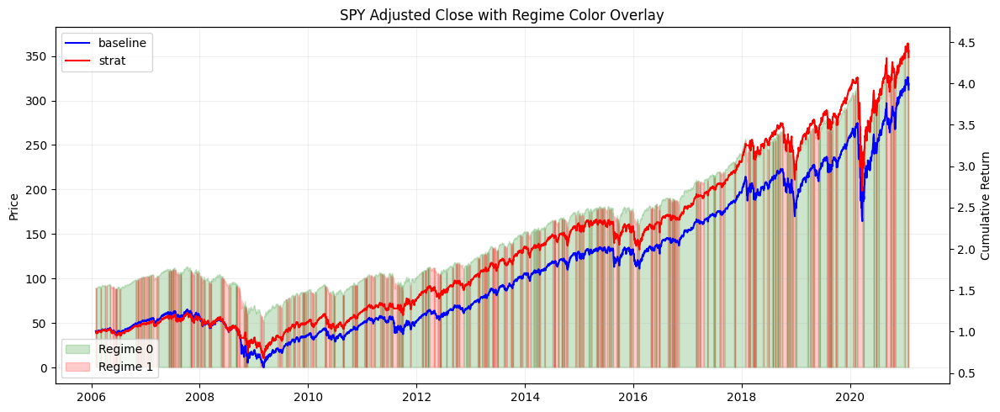

In [226]:
train_data, train_data_raw, test_data, test_data_raw = kmeans_train_test_split(final, 0.8)
kmeans, train_data_with_price = kmeans_train(train_data,\
                                            SPY_info['Adj Close'],\
                                            N_CLUSTER=N_CLUSTER,\
                                            seed=20241120)
train_data_with_money_2 = simple_strategy_with_hold_period(train_data_with_price, initial_capital, commission, min_hold_period)
kmeans_plot_with_regime(train_data_with_money_2)

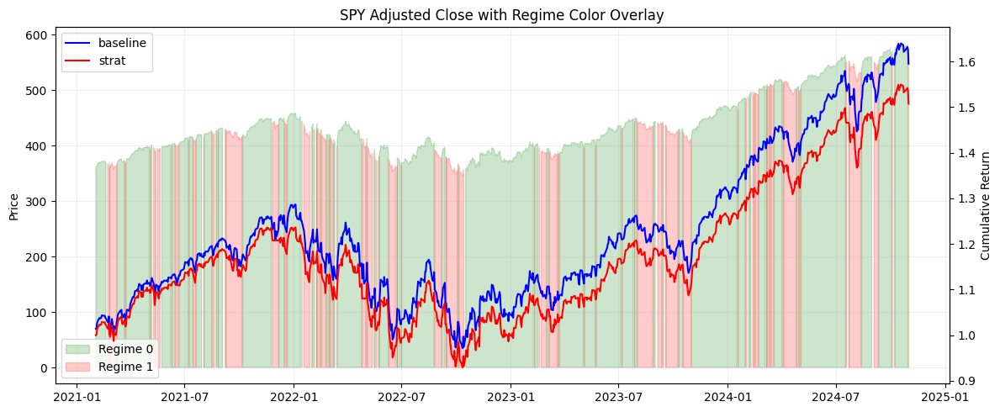

In [227]:
test_data['Regime'] = kmeans.predict(test_data)
test_data_with_price = test_data.merge(SPY_info['Adj Close'], right_index=True, left_index=True)
test_data_with_money_2 = simple_strategy_with_hold_period(test_data_with_price, initial_capital, commission, min_hold_period)
kmeans_plot_with_regime(test_data_with_money_2)


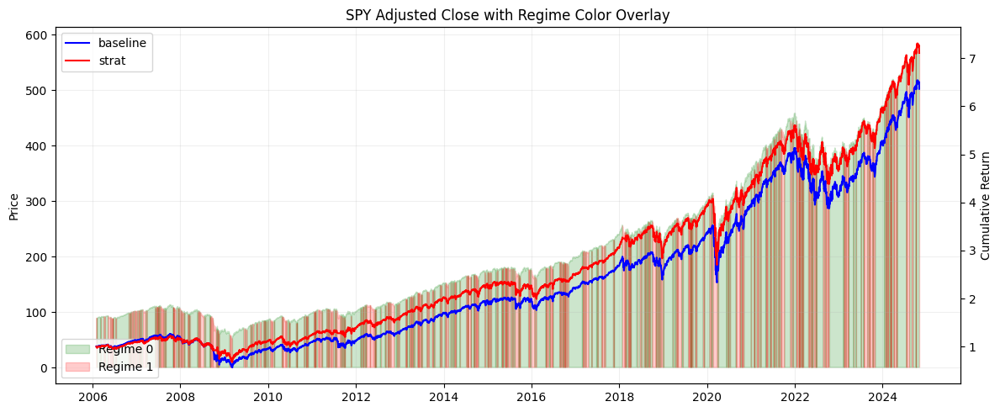

In [228]:
combined = pd.concat([train_data_raw, test_data_raw])
combined['Regime'] = kmeans.predict(combined)
combined_with_price = combined.merge(SPY_info['Adj Close'], right_index=True, left_index=True)
combined_with_money_2 = simple_strategy_with_hold_period(combined_with_price, initial_capital, commission, min_hold_period)
kmeans_plot_with_regime(combined_with_money_2)

In [229]:
combined_with_money_2 = calc_portfolio_statistics(combined_with_money_2, 
                                                  SPY_info, 
                                                  'KMeans_LONG_ONLY')

During this period, KMeans_LONG_ONLY Cumulative Return was 711.07%
During this period, KMeans_LONG_ONLY Annualized Return was 11.03%
During this period, KMeans_LONG_ONLY Annualized Standard Deviation was 17.97%
During this period, KMeans_LONG_ONLY Sharpe Ratio was 0.61
During this period, KMeans_LONG_ONLY Sortino Ratio was 0.72
During this period, KMeans_LONG_ONLY Calmar Ratio was 0.25
During this period, KMeans_LONG_ONLY Treynor Ratio was 11.14
During this period, KMeans_LONG_ONLY Max Drawdown was -44.73%
During this period, KMeans_LONG_ONLY Max Drawdown Duration was 1165 days
During this period, KMeans_LONG_ONLY 1 day VaR at the 99% CI was -3.0 %
During this period, KMeans_LONG_ONLY 1 month VaR at the 99% CI was -15.0 %
During this period, KMeans_LONG_ONLY 1 year VaR at the 99% CI was -52.0 %
During this period, KMeans_LONG_ONLY Information Ratio against SP500 was 0.04
The past 12m KMeans_LONG_ONLY Rolling Beta against SP500 was 0.99


In [230]:
#Cumulative Returns of Moving Average Strategy alongside SPY
plot_chart_with_SPY(portfolio_df = combined_with_money_2["Capital"],
                    SPY_info = SPY_info,
                    chart_title=("K-MEANS Long ONLY Strategy vs SPY Cumulative Returns"))

In [231]:
plot_chart_with_buy_sell(portfolio_df = combined_with_money_2, 
                        chart_title = "Buy Sell positions of K-MEANS Long ONLY Strategy")

In [232]:
plot_chart_with_drawdown(portfolio_df = combined_with_money_2, 
                         chart_title = "Drawdown of K-MEANS Long ONLY Strategy")

### <a id = "p5m">5m.</a>  <font color = "green"> ARIMA </font>  [back to table of contents](#top)

In [233]:
Y = SPY_info["SPY_log_returns"]
Y = Y.dropna()
train_size = int((1-validation_size) * len(Y))
Y_train = Y[:train_size]

In [234]:
p = range(0, 3)
d = range(0, 3) 
q = range(0, 3) 

pdq = [(x, y, z) for x in p for y in d for z in q]

aic = []
parameters = []

for param in pdq:
    try:
        mod = ARIMA(Y_train, order=param)
        results = mod.fit()

        aic.append(results.aic)
        parameters.append(param)

        print(f'ARIMA{param} - AIC: {results.aic}')
    
    except Exception as e:
        print(f"Error with ARIMA{param}: {e}")
        continue

index_min = min(range(len(aic)), key=aic.__getitem__)

print(f'\nThe optimal model is: ARIMA{parameters[index_min]} - AIC: {aic[index_min]}')


ARIMA(0, 0, 0) - AIC: -22594.371926151598
ARIMA(0, 0, 1) - AIC: -22648.875331482566
ARIMA(0, 0, 2) - AIC: -22646.990892923233
ARIMA(0, 1, 0) - AIC: -19508.952575799944
ARIMA(0, 1, 1) - AIC: -22577.583660279655
ARIMA(0, 1, 2) - AIC: -22632.431632967342
ARIMA(0, 2, 0) - AIC: -15181.584031038443
ARIMA(0, 2, 1) - AIC: -19491.279908777175
ARIMA(0, 2, 2) - AIC: -22538.53835756518
ARIMA(1, 0, 0) - AIC: -22647.191343042898
ARIMA(1, 0, 1) - AIC: -22646.986728792686
ARIMA(1, 0, 2) - AIC: -22645.572750143358
ARIMA(1, 1, 0) - AIC: -20876.93074264274
ARIMA(1, 1, 1) - AIC: -22630.687838856968
ARIMA(1, 1, 2) - AIC: -22574.445912870797
ARIMA(1, 2, 0) - AIC: -17629.262686586575
ARIMA(1, 2, 1) - AIC: -20857.486800704868
ARIMA(1, 2, 2) - AIC: -22601.02827980762
ARIMA(2, 0, 0) - AIC: -22647.500406226718
ARIMA(2, 0, 1) - AIC: -22653.66145361145
ARIMA(2, 0, 2) - AIC: -22644.94291761782
ARIMA(2, 1, 0) - AIC: -21482.277368718846
ARIMA(2, 1, 1) - AIC: -22630.443941436602
ARIMA(2, 1, 2) - AIC: -22634.8472270241

In [235]:
model_ARIMA = ARIMA(Y, order=parameters[index_min])
# model_ARIMA = ARIMA(Y, order=(2,0,0))
model_fit_ARIMA = model_ARIMA.fit() 

In [236]:
ARIMA_pred = model_fit_ARIMA.predict(start=2, end=len(Y)-1, typ='dynamic')
ARIMA_pred_df = pd.DataFrame({"ML_SPY_Predicted_Returns":ARIMA_pred})

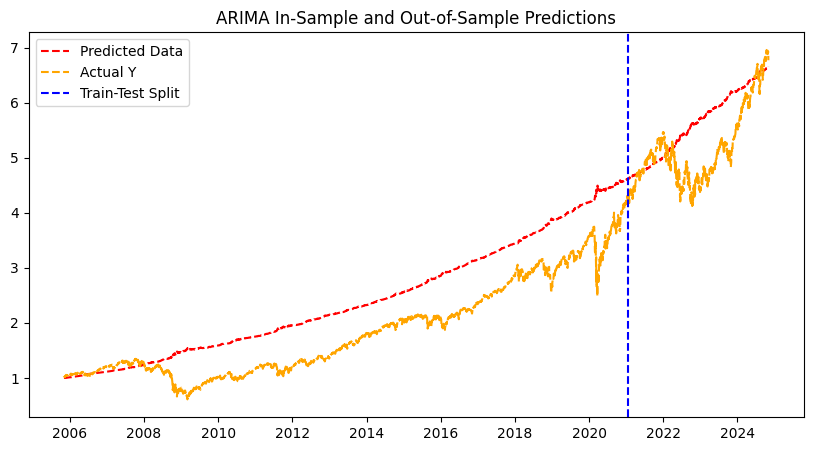

In [237]:
# Plot actual vs predicted
plt.figure(figsize=(10, 5))
plt.plot(np.exp(ARIMA_pred).cumprod(), label='Predicted Data', linestyle='--', color='red')
plt.plot(np.exp(Y).cumprod(), label='Actual Y', linestyle='--', color='orange')

plt.axvline(Y.index[train_size], color='blue', linestyle='--', label='Train-Test Split')
plt.title("ARIMA In-Sample and Out-of-Sample Predictions")
plt.legend()
plt.show()

In [238]:
ARIMA_pred_df

,ML_SPY_Predicted_Returns
Date,
2005-11-04,-0.000270
2005-11-07,0.000606
2005-11-08,0.000364
2005-11-09,0.000410
2005-11-10,0.000327
...,...
2024-10-25,0.000474
2024-10-28,0.000303
2024-10-29,0.000220


In [239]:
ARIMA_Strategy = analyze_ML_performance (predicted_returns_df = ARIMA_pred_df,
                                            Long_Short = "Long-Short",
                                            Strategy = "ARIMAX")

During this period, ARIMAX Strategy Cumulative Return was 426.74%
During this period, ARIMAX Strategy Annualized Return was 7.94%
During this period, ARIMAX Strategy Annualized Standard Deviation was 19.39%
During this period, ARIMAX Strategy Sharpe Ratio was 0.41
During this period, ARIMAX Strategy Sortino Ratio was 0.54
During this period, ARIMAX Strategy Calmar Ratio was 0.17
During this period, ARIMAX Strategy Treynor Ratio was 26.48
During this period, ARIMAX Strategy Max Drawdown was -47.5%
During this period, ARIMAX Strategy Max Drawdown Duration was 1621 days
During this period, ARIMAX Strategy 1 day VaR at the 99% CI was -3.0 %
During this period, ARIMAX Strategy 1 month VaR at the 99% CI was -16.0 %
During this period, ARIMAX Strategy 1 year VaR at the 99% CI was -54.0 %
During this period, ARIMAX Strategy Information Ratio against SP500 was -0.12
The past 12m ARIMAX Strategy Rolling Beta against SP500 was 0.3


# <a id = "p6">6.</a>  <font color = "green"> Executive Summary of Strategies </font>  [back to table of contents](#top)

In this notebook, we attempted various momentum, mean reversion and machine learning strategies in an attempt to beat SP500 trading only SPY. Without the flexibility of asset selection, we are essentially forced into timing the market to beat SP500. With SP500 showing extremely strong upward performance during our period of analysis (adjusted close rising from 84 to 569, an increase of 677%), timing the market would esentially involve being in a default long position, but knowing when to go neutral or short.

### TA Strategies

For momentum strategies, we tried a simple moving average crossover, exponential weighted moving average crossover as well as a MACD strategy. We tried optimizing the parameters by doing a grid search across all parameters of the strategy (looping through various lookback windows) to find the combination that would give the highest ending capital. However, even when we use the entire trading period to optimize for the best parameters, we are unable to find a set of parameters that would enable us to beat SP500. However, we did find that a long-only strategy would outperform long-short, which is in line with the fact that most of the time, SP500 goes up, so to be short, the strategy would need a high accuracy rate, which the momentum strategies lack.

For mean-reversion strategies, we attempted to use Bollinger Bands, RSI and Stochastic Oscillators as indicators to go long or flat. Similar to the momentum strategies, we tried optimizing the parameters by doing a grid search across all parameters of the strategy (looping through various lookback windows) to find the combination that would give the highest ending capital. Unfortunately, similar to the momentum strategies, even when using the entire trading period to optimize for the best parameters, we are unable to find a set of parameters that would enable us to beat SP500. Similar to the momentum strategies, we find that a long-only strategy would generally outperform long-short, for the same intuition mentioned above. 

We also find that for the mean-reversion strategies, it spends significant amount of time being flat, as compared to the momentum strategies, which are long much more often. Intuitively, this makes sense, as SP500 spent most of the time trending upwards, with only short periods of time such as 2008-9 financial crisis, 2020 Covid pandemic showing sharp pullabcks. As such, momentum would be a much better strategy compared to mean reversion. We would expect that if we tried these strategies on other asset classes such as FX or commods, or even individual stocks, the balance of momentum and mean reversion signals would be more finely balanced.

While our TA strategies failed to outperform SP500 even with the optimal parameters over 20 years, it is possible that if we have tuned the hyperparameters repeatedly over a shorter period of time (different hyperparameters for say every year instead of one set of hyperparameters over 20 years), we would have been able to beat SP500. Still, that would be severely overfitting and it is doubtful that the best set of hyperparameters for a TA strategy last year would be the best set of hyperparameters for the same TA this year, so we chose not to explore this further, due to the limited time we have.

### Machine Learning Strategies

For our Machine Learning Strategies, we decided to include financial and macroeconomic data as variables, in addition to lagged returns of SPY itself as well as the technical analysis indicators on SPY. We obtained VIX, DXY and QQQ data from yfinance, along with commodity prices of Gold, Copper and Crude oil. In additon to the levels, we calculated the change in these variables over the past 1-12 months to potentially feed into our ML models.

We obtained the macroeconomic variables from FRED via pandas datareader. We decided to get data on commonly used macroeconomic variables used to gauge the health of the economy, such as:

    GDP

    Unemployment (Initial jobless claims, Unemployment rate, Non-farm payrolls etc)

    Inflation (CPI, PPI, PCE etc)

    Rates (1 Month all the way to 30 year rates, TIPS, Inflation Breakeven rates etc)

    Leading Indicators (Consumer and Business Confidence etc)

    Credit (AAA-10Y_Yield, BAA-Yield etc)

For many of the economic indicators, we transformed them into year-on-year change or month-or-month change to get values that are regularly followed by market participants. 

Combining the above, we had 178 variables to predict one day ahead returns for SPY and after the 80-20 train-test split, we had 3560 rows for our train dataset. To reduce the risk of overfitting our ML models, we decided to reduce the number of features via recursive feature elimination. We decided that <font color = "green"> 36 features (1% of the dataset)</font> should be sufficient for our models and conducted RFE to reduce the number of features. Interstingly, <font color = "green">most of the features chosen are market variables, such as commodity prices, past movement of VIX, past returns of SPY etc.</font> This is unsurprising as we would expect daily SPY prices to be more responsive to market variables, and less responsive to macroeconomic variables that only change monthly, if not quarterly. If we had tried to predict one month ahead or one quarter ahead SPY returns, perhaps macroeconomic variables would have played a larger role.

Apart from the Gradient Boosted tree models (elaborated on below), we did a quick test to predict 1 day ahead returns using Linear Regression and Logistic Regression. There is clear overfitting as the regression models are fitted on the entire train set at once, and the regression coefficients are used to predict the train set (in addition to the test set). We also did not conduct any statistical tests for stationary/ heteroskedasticity/ multicollinarity before the regressions. The results of overfitting are clear for the Linear Regression model. Apart from an immediate drop in performance in the Linear Regression strategy, we observe that the number of trades drop off to zero in the latter part of the test set, despite actively trading in the train set, indicating that the model fails to generalize to the test set. The overfit in the Logistic Regression is less obvious, with no obvious drop off in performance, but we do note a lack of trades in the test set. 

There is also an attempt to use K-Means clustering to identify regimes that can be used as trading signals. In our implementation of a strategy utilizing K-Means clustering, we enter a long position when it enters a regime (regime 0) and exits (sell) the position when it enters regime 1. The inputs to the K-Means clustering algorithm are SP500 Index and VIX "returns" over 1, 5 ,15, 30 and 60 days. These returns are further scaled on a rolling basis to prevent look ahead bias that could occur when using feature scalers from ML packages. Due to the rolling nature of feature scaling, we implement a minimum holding period to control the number of trading activity. In sample results show results that manage to beat benchmark cumulative returns, but slightly below it using out of sample data. However, when evaluated across the whole horizon, the strategy manages to slightly beat the market.



### <a id = "p6a">6a.</a>  <font color = "green"> Top Strategy 1 </font>  [back to table of contents](#top)

### [5h. XGBoost](#p5h)

Our top performing strategy is XGBoost with a Sharpe of <font color = "green">3.44</font>, CAGR of <font color = "green">67.6%</font>, maximum drawdown of <font color = "green">33.4%</font>. At the end of the period, the account was left with <font color = "green">917 million</font>. XGBoost (Extreme Gradient Boosting) is a supervised learning machine learning model, based on the concept of gradient boosted decision trees. In short, XGBoost grows multiple decision trees, where each subsequent tree focuses on the errors of the previous tree. The final prediction is an ensemble of the trees prediction. 

We tune the model hyperparameters with the help of Optuna, where we can give a range for hyperparameters such as the max depth of the tree, the number of estimators (trees grown), the learning rate of the model and minimum gain needed for a split. For XGBoost, we can also set the regularization alpha and lambda which helps penalizes complex models and helps in preventing overfitting. Optuna would then search through the range of hyperparameters and return the best set of hyperparameters. We chose Optuma to help with the hyperparamter optimization as it uses Bayesian optimization, which is faster and more accurate as compared to the traditional Grid-Search or random search, as Bayesian optimization uses a probabilistic function considering the previous evaluation results. Within Optuna, we chose to utilise TimeSeriesSplit instead of KFold cross-validation due to the time-series nature of our data. 

We experimented with various objective functions before deciding to go with <font color = "green"> minimizing absolute error for the XGBRegressor objective function. As absolute error is less sensitive to outliers than squared error, we hope that it further reduces the potential for overfitting. </font>

Looking at the buy-sell positions, we notice that a long-short trading strategy using XGBoost predicted returns (buy when predicted returns are postive, sell when predicted returns are negative), generated returns significantly higher than that of SP500 annually. While part of this significant outperformance is attributable to how returns for a long-short strategy are being calculated (see section 7d below), part of this is attributable to the significant effects of compounding. As returns are calculated across the entire 20 years (in reality closer to 19, considering that we needed some data to even start trading), including both train and test periods, significant outperformance in the train period would leave some buffer for the test set.

### <a id = "p6b">6b.</a>  <font color = "green"> Top Strategy 2 </font>  [back to table of contents](#top)

### [5i. AdaBoost](#p5i)

Our second top performing strategy is AdaBoost (Adaptive Boosting) with a Sharpe of <font color = "green">1.37</font>, CAGR of <font color = "green">27.2%</font>, maximum drawdown of <font color = "green">27.99%</font>. At the end of the period, the account was left with <font color = "green">7.003 million</font>. Similar to XGBoost, AdaBoost is a supervised ensemble learning model, taking the prediction of several trees and combining them to get a final prediction. It also takes the error of the previous tree to create the next tree, with increased weighs for the data that was wrongly classified by the trees in the previous rounds and decreased weights for the correctly classified data.  However, AdaBoost "trees" have just one node and two leaves, with each "tree" using only one variable to make a decision.

Similar to XGBoost, we use Optuna to conduct hyperparameter tuning, setting a range for hyperparameters such as number of estimators and learning rate. We chose to use the DecisionTreeRegressor as the base estimator for AdaBoost. 

A long-short trading strategy using AdaBoost (buy when predicted returns are postive, sell when predicted returns are negative), generated returns about three times that of SP500 annually, and we also noticed that the model tends to be long most of the time, with short durations tending to be tactical and rarely lasting more than a few days. We also noticed that the model only predicted negative returns during the 2008 financial crisis and 2020 Covid crisis. Apart from these 2 periods, it was essentially long only. Intuitively speaking, avoiding a few bad days (espeically during the 2008 financial crisis and 2020 Covid pandemic) could have outsized impact on returns, especially when compunded over 20 years. 

### <a id = "p6c">6c.</a>  <font color = "green"> Top Strategy 3 </font>  [back to table of contents](#top)

### [5l. K-Means](#p5l)

Our third top performing strategy is based on the K-Means Clustering with a Sharpe of <font color = "green">0.61</font>, CAGR of <font color = "green">11.03%</font>, maximum drawdown of <font color = "green">44.73%</font> with a final cumulative return of 711%. At the end of the period, the account was left with <font color = "green">711 thousand</font>. Unlike the other top performing strategies, it is not based on a supervised ensemble learning model, Instead relying on classifying points based on their available features, in this case SP500 and VIX returns on different lags.

Other than selecting features, a challenging part when building the K-Means based strategy is deciding how to scale the data. We eventually settled to use a "rolling standard scaler" approach using a certain fixed window to calculate the mean and standard deviation.

The strategy is quite straightforward, essentially entering a long position when it enters a favorable regime and exits it once it is in no longer in that regime. Another challenge are the noisy prediction result which can lead to positions being exited too early which necessisates a minimum holding period.

Comparing this strategy to the other top 2, owing to its long only nature, moves along with the market quite closely which could explain why its performance is not as good as the other strategies

### <a id = "p6d">6d.</a>  <font color = "green"> Strategy Comparison </font>  [back to table of contents](#top)

Amongst our 3 top strategies, XGBoost is the clear winner in terms of Sharpe and CAGR, while AdaBoost has a lower maximum drawdown. Looking at the number of trades over our trading horizon, XGBoost also has a significantly higher number of trades compared with both AdaBoost and KMeans, which provides more opportunities to time the market correctly and generate outsized returns.

Apart from offering higher returns than SP500, all 3 strategies managed to offer lower maximum drawdowns compared to SP500, which lost more than 50% during the 2008 financial crisis. Looking at the buy-sell charts, all the strategies had at least some duration in which they were short SPY during the 2008 financial crisis, which if timed correctly, would have helped them beat a buy-and hold strategy during this period.

### <a id = "p6e">6e.</a>  <font color = "green"> Honorable Mentions </font>  [back to table of contents](#top)

### [5j. Linear Regression](#p5j)

The strategy based on linear regression managed to display impressive results, with a Sharpe of 1.42, CAGR of 28.27%, maxiumum drawdown of 35.78 with a final cumulative return of 8128.48%, despite its relatively simple nature. However, the results are clearly overfitted, as seen from the lack of trades towards the latter half of the test set, resulting in the linear regression being placed in the honorable mention section. Furtherwork can be done based on rolling regression to investigate if there is an ideal training period on which to train and ideal window to trade on before rolling forward again.

### [5k. Logistic Regression](#p5k)

The strategy based on logistic regression managed to display does have poorer results, as shown by the Sharpe of 0.81, but still managed a CAGR of 16.17%, maxiumum drawdown of 33.8% with a final cumulative return of 1412.62%. However, the current implementation is affected by the same issues as Linear Regression which will need to be looked into further. We do note that the Logistic Regression model has far fewer trades compared with the Linear Regression despite the similar setup and many of the trades were made during periods of market stress such as the 2008 financial crisis and around the Covid period, thus it does show promise as a model to trade during periods of distress. Further analysis on the coefficients of this regression need to be carry out to see if it makes economic sense that it will help trigger signals during periods of severe equity volatility.

# <a id = "p7">7.</a>  <font color = "green"> Self-Critique of Strategies </font>  [back to table of contents](#top)

### <a id = "p7a">7a.</a>  <font color = "green"> Operational Reality </font>  [back to table of contents](#top)

Our strategy assumes no trading costs, which is unrealistic. Even though we are trading SPY, which is very liquid and with low bid-ask spread, and we are trading at most once a day (not doing high frequency trading), trading costs do add up and could be a drag (admittedly small in this case) over time. A more realistic backtest would have included a small trading cost into account.

Our strategy also assumes we can execute our trades at close prices, which is unrealistic, even if we had all the data on hand ahead of time and managed to generate the predictions before close, it is unlikely that the prices we execute at will exactly match the market closing prices, a bit of slippage is most likely unavoidable. A more robust backtest could be to generate small randomness when executing at close price.

Our strategy also assumes that we can short SPY easily, and without borrowing costs. Most of the time, it should be possible to find SPY shares to short, as it is a very liquid ETF with high trading volume. However, during periods of stress such as during the Covid crisis and the 2008 financial crisis, brokerage restrictions might impose restrictions on shorting, and even if you manage to find the shares to short, the borrowing costs might be quite high. Ideally, we would want to put in a borrowing cost for short sale in our backtest.

### <a id = "p7b">7b.</a>  <font color = "green"> Lookahead Bias </font>  [back to table of contents](#top)

We utilised a range of financial and macroeconomic data in addition to past returns of SPY itself for our machine learning models, which could have resulted in data leakage, using data that was unavailable at that point in time to predict returns of SPY. For example, SPY closing prices are from the time the stock exchange closed (verify this) while closing prices for financial indicators such as VIX, DXY and US rates which trade 24/7 could be from midnight of that day, which is a couple of hours after the exchange closed. Ideally, if we had hourly data or higher frequency data, we could have standardized the hourly snap for getting data for daily analysis (eg get data for all variables as of 4pm EST).

There is also the issue of using technical indicators calculated using the closing price of SPY of that day to predict the next day's return of SPY. Hypoteatically speaking, we can calculate the technical indicators using a prices a second before close and use them to train the ML models and trade based on the signal on close, but that is unrealistic unless we have access to low latency data.

Using macroeconomic data also poses lookahead bias issues, as the data will only be avaiable a few weeks if not months after the end of the economic period. Economic data is also subject to frequent revisions, and previously released data can be significantly changed months or even years after release. Ideally, we would want to train and backtest our ML models using point in time economic data, reflecting what was known at that point in time.

### <a id = "p7c">7c.</a>  <font color = "green"> Overfitting </font>  [back to table of contents](#top)

Despite our attempts to prevent overfitting, such as using RFE to significantly reduce the number of variables, setting L1 and L2 regularization parameters for XGBoost, and setting early stopping rounds, boosted trees by nature work to minimize bias and are more prone to overfitting than bagged trees that minimizes variance. Althogh we have tried to minimize the impact of outliers by setting the XGBRegressor objective to minimize absolute error rather than minimizing mean square error, it is clear that the issue of overfitting still persists. 

To further mitigate overfitting, perhaps a walk-forward validation approach should be utilised, where we train our models on say 10 years of data, use it to predict the daily returns for the coming year, and then roll the training window forward for the next year. Unfortunately, due to the 80-20 train-test split requirements for this project, we were unable to do this.


### <a id = "p7d">7d.</a>  <font color = "green"> Problem with log returns </font>  [back to table of contents](#top)

Calculating returns using log returns instead of percentage returns is problematic in a long-short setting. Using a negative sign in front of log returns leads to underestimating losses when short and markets go up and overstating returns when short and markets go down. 

In [240]:
np.log(105/100)

0.04879016416943205

In [241]:
# Long and markets go up

np.exp(np.log(105/100))

1.05

In [242]:
-np.log(105/100)

-0.04879016416943205

In [243]:
# Short and markets go up

np.exp(-np.log(105/100))

0.9523809523809523

In [244]:
np.log(95/100)

-0.05129329438755058

In [245]:
# Long and markets go down

np.exp(np.log(95/100))

0.95

In [246]:
-np.log(95/100)

0.05129329438755058

In [247]:
# Short and markets go down

np.exp(-np.log(95/100))

1.0526315789473684

### <a id = "p7e">7e.</a>  <font color = "green"> Hyperparameter Tuning </font>  [back to table of contents](#top)

Using 20 years of historical data do provide its pros and cons. The pros would be that the dataset provides us a comprehensive view of different market conditions such as going through Global Financial Crisis, Dot-com bubble and Covid. Armed with this knowledge, we will be able to train the model based on major volatility swings in the market. The different economic cycles and regimes are also captured in the models.

However, the downside is that market structure and dynamics may change over the years. Especially with technological advances to trade at higher frequency. Price fluctuations be more volatile. As such, we should note that huge cumulative profit from such models needs to be carefully scrutinized. Past conditions may not longer apply in new market environments.